In [1]:
# Dependencies
import tensorflow

#from tensorflow.math import reduce_prod
#from tensorflow.python.ops.math_ops import reduce_prod

import numpy as np

from sklearn.linear_model import LinearRegression 
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor 
from sklearn.neighbors import KNeighborsRegressor 
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor 
from sklearn.ensemble import GradientBoostingRegressor 
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.neural_network import MLPRegressor

from sklearn.model_selection import train_test_split 
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score 
from sklearn.model_selection import GridSearchCV 
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_regression

from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense 
from tensorflow.keras.optimizers import SGD 
from tensorflow.keras.layers import LSTM
from tensorflow.keras.wrappers.scikit_learn import KerasRegressor

In [71]:
from statsmodels.tsa.arima_model import ARIMA 
import statsmodels.api as sm
# Python warnings
import warnings
warnings.filterwarnings("ignore")

In [72]:
# pandas, pandas_datareader, numpy and matplotlib
# import numpy as np
import pandas as pd
#import pandas_datareader.data as web 
from matplotlib import pyplot

In [73]:
from pandas.plotting import scatter_matrix
import seaborn as sns
from sklearn.preprocessing import StandardScaler 
from pandas.plotting import scatter_matrix
from statsmodels.graphics.tsaplots import plot_acf

In [8]:
# stk_tickers = ['MSFT', 'IBM', 'GOOGL']
stk_tickers = ['ABBV', 'AMGN', 'AZN', 'BIIB', 'BMY', 'CRXT', 'GILD', 'GRFS','GSK', 'HCM', 'HZNP', 'JNJ', 'LLY', 'MRK','NVO','NVS', 'OGN','PFE','SNY','TSVT']
ccy_tickers = ['DEXJPUS', 'DEXUSUK']
idx_tickers = ['SP500', 'DJIA', 'VIXCLS']

In [9]:
!pip install pandas-datareader

In [10]:
import pandas_datareader.data as web

In [11]:
stk_data = web.DataReader(stk_tickers, 'yahoo')
ccy_data = web.DataReader(ccy_tickers, 'fred')
idx_data = web.DataReader(idx_tickers, 'fred')

In [12]:
return_period = 5 #Rendimiento Semanal

In [13]:
stk_data

Attributes   Adj Close                                                       \
Symbols           ABBV        AMGN        AZN        BIIB        BMY   CRXT   
Date                                                                          
2016-11-25   48.086964  125.893028  22.735603  305.200012  49.105759    NaN   
2016-11-28   47.252529  125.581360  22.425188  303.779999  48.700703    NaN   
2016-11-29   48.945229  126.386429  22.408411  302.769989  48.571438    NaN   
2016-11-30   48.317421  124.715744  21.930208  294.070007  48.640388    NaN   
2016-12-01   47.014118  123.261444  21.653353  295.779999  48.088818    NaN   
...                ...         ...        ...         ...        ...    ...   
2021-11-18  117.070000  204.020004  56.709999  256.790009  59.040001  4.670   
2021-11-19  116.239998  206.080002  56.660000  257.190002  57.830002  4.390   
2021-11-22  115.650002  202.729996  56.549999  252.210007  57.040001  4.015   
2021-11-23  118.879997  204.529999  56.730000  254.149994  57.450001  5.740   
2021-11-24  118.900002  204.201202  56.334999  249.639999  56.900002  4.998   

Attributes                                              ...     Volume  \
Symbols          GILD       GRFS        GSK        HCM  ...       HZNP   
Date                                                    ...              
2016-11-25  63.288357  13.906858  29.903074  12.570000  ...   630600.0   
2016-11-28  62.533344  14.014385  29.464457  13.000000  ...  2260700.0   
2016-11-29  62.810177  14.103991  29.449062  13.000000  ...  2596600.0   
2016-11-30  61.828636  14.005424  29.079700  13.840000  ...  5137500.0   
2016-12-01  61.107166  13.808290  28.802681  13.620000  ...  2652400.0   
...               ...        ...        ...        ...  ...        ...   
2021-11-18  67.790001  12.060000  41.500000  30.110001  ...   949300.0   
2021-11-19  68.690002  11.880000  41.590000  30.719999  ...  1496300.0   
2021-11-22  69.970001  11.680000  41.290001  33.759998  ...  2287300.0   
2021-11-23  70.629997  11.590000  41.599998  32.110001  ...  1322700.0   
2021-11-24  69.931198  11.430000  41.555000  32.709999  ...   351486.0   

Attributes                                                            \
Symbols            JNJ         LLY         MRK        NVO        NVS   
Date                                                                   
2016-11-25   3433300.0   8620700.0   3669362.0  1964100.0  1975878.0   
2016-11-28   9065700.0  12507700.0   7806971.0  3515000.0  2530195.0   
2016-11-29   7799600.0   8930000.0  10516575.0  4347700.0  2042280.0   
2016-11-30  11178500.0   9085300.0  13132174.0  8117600.0  2443705.0   
2016-12-01   8143300.0   7168100.0   8802047.0  3971600.0  2679851.0   
...                ...         ...         ...        ...        ...   
2021-11-18   6358700.0   1689200.0   9833600.0   886600.0  1590700.0   
2021-11-19   7620700.0   2786800.0  17581100.0   724900.0  2160100.0   
2021-11-22   7634500.0   1995400.0  10880200.0   671500.0  1853200.0   
2021-11-23   7734000.0   1986200.0  12130800.0  1002900.0  2306800.0   
2021-11-24   1935558.0    653395.0   3998747.0   303642.0  1007016.0   

Attributes                                              
Symbols           OGN         PFE        SNY      TSVT  
Date                                                    
2016-11-25        NaN  11017357.0   710700.0       NaN  
2016-11-28        NaN  18692901.0  1184400.0       NaN  
2016-11-29        NaN  22810879.0  2224800.0       NaN  
2016-11-30        NaN  40599553.0  1323100.0       NaN  
2016-12-01        NaN  32259146.0  1301400.0       NaN  
...               ...         ...        ...       ...  
2021-11-18  2625800.0  32872600.0  1945200.0  547700.0  
2021-11-19  2631300.0  47936400.0  2197500.0  345500.0  
2021-11-22  2183200.0  27287900.0  2662600.0  391800.0  
2021-11-23  2008500.0  24946200.0  1076600.0  640500.0  
2021-11-24  1152264.0   9539092.0  1179870.0  145160.0  

[1259 rows x 120 columns]

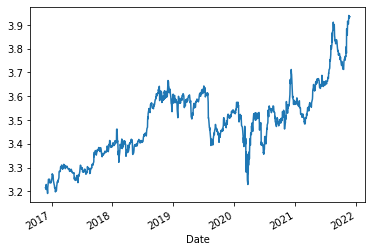

In [14]:
np.log(stk_data.loc[:, ('Adj Close', 'PFE')]).plot()

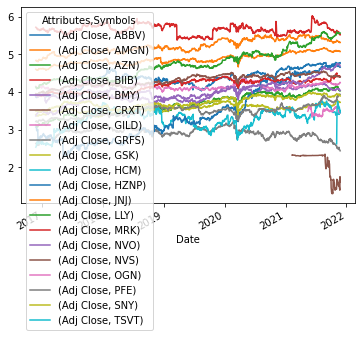

In [15]:
np.log(stk_data.loc[:, ('Adj Close', stk_tickers)]).plot()

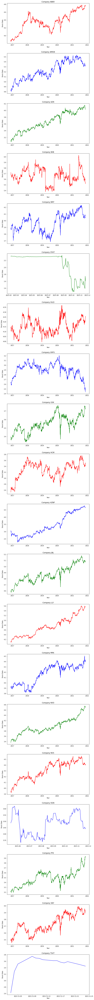

In [16]:
import matplotlib.pyplot as plt
# Tickers change
def test(to_plot,ax, i, c,s):
    ax[i].plot(p.index, p.values, color=c)
    ax[i].set_xlabel("Year")
    ax[i].set_ylabel("Stock Data")
    ax[i].set_title(f"Company {s}")
    
fig,ax = plt.subplots(len(stk_tickers), 1, constrained_layout=True, figsize=(10,100))
fig.tight_layout(pad=5)

colors= ["red", "blue", "green"]

for i, s in enumerate(stk_tickers):
    p= np.log(stk_data.loc[:, ('Adj Close', s)])
    test(p, ax, i, colors[i%len(colors)], s)

plt.show()

In [17]:
np.log(stk_data.loc[:, ('Adj Close', 'PFE')]).diff(5).shift(-5)
# Generate variable Y: is the weekly performance in t+1
#Shift -5: Gives the data plus 5 periods. The base for lower to higher times
# To make it supervised, shify -5 gives the data t+5 in t

Date
2016-11-25   -0.001895
2016-11-28    0.001584
2016-11-29   -0.011342
2016-11-30   -0.030004
2016-12-01   -0.016667
                ...   
2021-11-18         NaN
2021-11-19         NaN
2021-11-22         NaN
2021-11-23         NaN
2021-11-24         NaN
Name: (Adj Close, PFE), Length: 1259, dtype: float64

In [18]:
# This is for every ticker period
for i in stk_data:
     print(np.log(stk_data.loc[:, ('Adj Close', i)]).diff(5).shift(-5))

Attributes Adj Close
Symbols         ABBV
Date                
2016-11-25 -0.018010
2016-11-28  0.023272
2016-11-29  0.000487
2016-11-30 -0.013412
2016-12-01  0.028988
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols         AMGN
Date                
2016-11-25 -0.009813
2016-11-28  0.001516
2016-11-29 -0.006114
2016-11-30 -0.020193
2016-12-01 -0.012722
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          AZN
Date                
2016-11-25 -0.045677
2016-11-28 -0.034637
2016-11-29 -0.026557
2016-11-30 -0.011156
2016-12-01  0.017666
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols         BIIB
D

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          NVO
Date                
2016-11-25  0.056067
2016-11-28  0.056168
2016-11-29  0.074763
2016-11-30  0.046520
2016-12-01  0.041454
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          NVS
Date                
2016-11-25 -0.020473
2016-11-28 -0.001594
2016-11-29  0.000000
2016-11-30 -0.002038
2016-12-01 -0.002365
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          OGN
Date                
2016-11-25       NaN
2016-11-28       NaN
2016-11-29       NaN
2016-11-30       NaN
2016-12-01       NaN
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Clos

Attributes Adj Close
Symbols         AMGN
Date                
2016-11-25 -0.009813
2016-11-28  0.001516
2016-11-29 -0.006114
2016-11-30 -0.020193
2016-12-01 -0.012722
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          AZN
Date                
2016-11-25 -0.045677
2016-11-28 -0.034637
2016-11-29 -0.026557
2016-11-30 -0.011156
2016-12-01  0.017666
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols         BIIB
Date                
2016-11-25 -0.026596
2016-11-28 -0.045664
2016-11-29 -0.039100
2016-11-30 -0.030277
2016-12-01 -0.021322
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          BMY
D

Attributes Adj Close
Symbols          LLY
Date                
2016-11-25 -0.020610
2016-11-28  0.000893
2016-11-29  0.009633
2016-11-30  0.003866
2016-12-01  0.018324
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          MRK
Date                
2016-11-25 -0.017513
2016-11-28 -0.025401
2016-11-29 -0.031194
2016-11-30 -0.018640
2016-12-01 -0.010589
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          NVO
Date                
2016-11-25  0.056067
2016-11-28  0.056168
2016-11-29  0.074763
2016-11-30  0.046520
2016-12-01  0.041454
...              ...
2021-11-18       NaN
2021-11-19       NaN
2021-11-22       NaN
2021-11-23       NaN
2021-11-24       NaN

[1259 rows x 1 columns]
Attributes Adj Close
Symbols          NVS
D

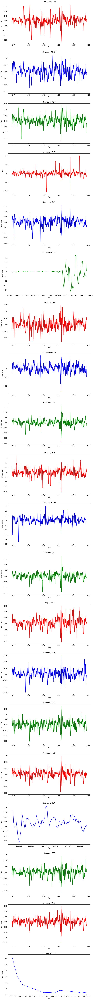

In [19]:
import matplotlib.pyplot as plt
# Tickers change
def test2(to_plot,ax, i, c,s):
    ax[i].plot(p.index, p.values, color=c)
    ax[i].set_xlabel("Year")
    ax[i].set_ylabel("Stock Data")
    ax[i].set_title(f"Company {s}")
    

fig,ax = plt.subplots(len(stk_tickers), 1, constrained_layout=True, figsize=(10,100))
fig.tight_layout(pad=5)
colors= ["red", "blue", "green"]

for i, s in enumerate(stk_tickers):
    p= np.log(stk_data.loc[:, ('Adj Close', s)]).diff(5).shift(-5)
    test2(p, ax, i, colors[i%len(colors)], s)
plt.show()

In [20]:
# All stocks stk_tickers
Y = np.log(stk_data.loc[:, ('Adj Close', stk_tickers)]).diff(return_period).shift(-return_period)

In [21]:
Y

Attributes Adj Close                                                         \
Symbols         ABBV      AMGN       AZN      BIIB       BMY CRXT      GILD   
Date                                                                          
2016-11-25 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063  NaN -0.040855   
2016-11-28  0.023272  0.001516 -0.034637 -0.045664 -0.017134  NaN -0.029682   
2016-11-29  0.000487 -0.006114 -0.026557 -0.039100 -0.005873  NaN -0.032580   
2016-11-30 -0.013412 -0.020193 -0.011156 -0.030277 -0.021491  NaN -0.012562   
2016-12-01  0.028988 -0.012722  0.017666 -0.021322 -0.010268  NaN -0.011321   
...              ...       ...       ...       ...       ...  ...       ...   
2021-11-18       NaN       NaN       NaN       NaN       NaN  NaN       NaN   
2021-11-19       NaN       NaN       NaN       NaN       NaN  NaN       NaN   
2021-11-22       NaN       NaN       NaN       NaN       NaN  NaN       NaN   
2021-11-23       NaN       NaN       NaN       NaN       NaN  NaN       NaN   
2021-11-24       NaN       NaN       NaN       NaN       NaN  NaN       NaN   

Attributes                                                              \
Symbols         GRFS       GSK       HCM      HZNP       JNJ       LLY   
Date                                                                     
2016-11-25 -0.024129 -0.030305  0.133134 -0.076868 -0.019197 -0.020610   
2016-11-28 -0.045901 -0.016325  0.134396 -0.073963 -0.010575  0.000893   
2016-11-29 -0.059077 -0.015271  0.139093 -0.040723 -0.003741  0.009633   
2016-11-30 -0.058227 -0.006371  0.066388 -0.020924 -0.001799  0.003866   
2016-12-01 -0.031764 -0.001069  0.061919 -0.256770 -0.003507  0.018324   
...              ...       ...       ...       ...       ...       ...   
2021-11-18       NaN       NaN       NaN       NaN       NaN       NaN   
2021-11-19       NaN       NaN       NaN       NaN       NaN       NaN   
2021-11-22       NaN       NaN       NaN       NaN       NaN       NaN   
2021-11-23       NaN       NaN       NaN       NaN       NaN       NaN   
2021-11-24       NaN       NaN       NaN       NaN       NaN       NaN   

Attributes                                                             
Symbols          MRK       NVO       NVS OGN       PFE       SNY TSVT  
Date                                                                   
2016-11-25 -0.017513  0.056067 -0.020473 NaN -0.001895  0.004508  NaN  
2016-11-28 -0.025401  0.056168 -0.001594 NaN  0.001584  0.029268  NaN  
2016-11-29 -0.031194  0.074763  0.000000 NaN -0.011342  0.005425  NaN  
2016-11-30 -0.018640  0.046520 -0.002038 NaN -0.030004  0.007929  NaN  
2016-12-01 -0.010589  0.041454 -0.002365 NaN -0.016667  0.001258  NaN  
...              ...       ...       ...  ..       ...       ...  ...  
2021-11-18       NaN       NaN       NaN NaN       NaN       NaN  NaN  
2021-11-19       NaN       NaN       NaN NaN       NaN       NaN  NaN  
2021-11-22       NaN       NaN       NaN NaN       NaN       NaN  NaN  
2021-11-23       NaN       NaN       NaN NaN       NaN       NaN  NaN  
2021-11-24       NaN       NaN       NaN NaN       NaN       NaN  NaN  

[1259 rows x 20 columns]

In [22]:
# Y.columns = Y.columns[-1]+'_pred'
#X = X.set_axis(X_colnames, axis=1, inplace=False)
list_names=[]
for i in range(0,len(Y.columns)):
    list_names.append(stk_tickers[i]+'_pred')
list_names

['ABBV_pred',
 'AMGN_pred',
 'AZN_pred',
 'BIIB_pred',
 'BMY_pred',
 'CRXT_pred',
 'GILD_pred',
 'GRFS_pred',
 'GSK_pred',
 'HCM_pred',
 'HZNP_pred',
 'JNJ_pred',
 'LLY_pred',
 'MRK_pred',
 'NVO_pred',
 'NVS_pred',
 'OGN_pred',
 'PFE_pred',
 'SNY_pred',
 'TSVT_pred']

In [23]:
Y = Y.set_axis(list_names, axis=1, inplace=False)
Y

,ABBV_pred,AMGN_pred,AZN_pred,BIIB_pred,BMY_pred,CRXT_pred,GILD_pred,GRFS_pred,GSK_pred,HCM_pred,HZNP_pred,JNJ_pred,LLY_pred,MRK_pred,NVO_pred,NVS_pred,OGN_pred,PFE_pred,SNY_pred,TSVT_pred
Date,,,,,,,,,,,,,,,,,,,,
2016-11-25,-0.018010,-0.009813,-0.045677,-0.026596,-0.018063,NaN,-0.040855,-0.024129,-0.030305,0.133134,-0.076868,-0.019197,-0.020610,-0.017513,0.056067,-0.020473,NaN,-0.001895,0.004508,NaN
2016-11-28,0.023272,0.001516,-0.034637,-0.045664,-0.017134,NaN,-0.029682,-0.045901,-0.016325,0.134396,-0.073963,-0.010575,0.000893,-0.025401,0.056168,-0.001594,NaN,0.001584,0.029268,NaN
2016-11-29,0.000487,-0.006114,-0.026557,-0.039100,-0.005873,NaN,-0.032580,-0.059077,-0.015271,0.139093,-0.040723,-0.003741,0.009633,-0.031194,0.074763,0.000000,NaN,-0.011342,0.005425,NaN
2016-11-30,-0.013412,-0.020193,-0.011156,-0.030277,-0.021491,NaN,-0.012562,-0.058227,-0.006371,0.066388,-0.020924,-0.001799,0.003866,-0.018640,0.046520,-0.002038,NaN,-0.030004,0.007929,NaN
2016-12-01,0.028988,-0.012722,0.017666,-0.021322,-0.010268,NaN,-0.011321,-0.031764,-0.001069,0.061919,-0.256770,-0.003507,0.018324,-0.010589,0.041454,-0.002365,NaN,-0.016667,0.001258,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-11-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-11-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
X1 = np.log(stk_data.loc[:, ('Adj Close', stk_tickers)]).diff(return_period)
X1.columns = X1.columns.droplevel()

In [25]:
X1

Symbols,ABBV,AMGN,AZN,BIIB,BMY,CRXT,GILD,GRFS,GSK,HCM,HZNP,JNJ,LLY,MRK,NVO,NVS,OGN,PFE,SNY,TSVT
Date,,,,,,,,,,,,,,,,,,,,
2016-11-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-18,0.003766,-0.027930,-0.103914,-0.037378,-0.002537,-0.006403,0.005325,0.000830,-0.028474,-0.014180,-0.008916,-0.004056,-0.001721,-0.011612,0.014183,-0.010558,-0.094159,0.024216,-0.027135,-0.140412
2021-11-19,-0.006261,-0.017080,-0.037073,-0.050198,-0.027291,-0.061830,0.017772,-0.008382,-0.029310,-0.010685,-0.024695,-0.012931,0.004036,-0.040078,0.006785,-0.010113,-0.066578,0.021288,-0.002761,-0.059876
2021-11-22,-0.010237,-0.022774,-0.055546,-0.074878,-0.044238,-0.105111,0.040393,-0.012761,-0.032158,0.081105,-0.035979,-0.017110,0.007748,-0.024800,-0.020115,-0.011736,-0.044635,0.030741,-0.022362,-0.110594


In [26]:
X2 = np.log(ccy_data).diff(return_period)

In [27]:
X2

,DEXJPUS,DEXUSUK
DATE,,
2016-11-25,NaN,NaN
2016-11-28,NaN,NaN
2016-11-29,NaN,NaN
2016-11-30,NaN,NaN
2016-12-01,NaN,NaN
...,...,...
2021-11-15,0.007133,-0.008813
2021-11-16,0.015386,-0.009044
2021-11-17,0.003856,0.001335


In [28]:
X3 = np.log(idx_data).diff(return_period)

In [29]:
X3

,SP500,DJIA,VIXCLS
DATE,,,
2016-11-25,NaN,NaN,NaN
2016-11-28,NaN,NaN,NaN
2016-11-29,NaN,NaN,NaN
2016-11-30,NaN,NaN,NaN
2016-12-01,NaN,NaN,NaN
...,...,...,...
2021-11-17,0.008990,-0.004135,-0.090463
2021-11-18,0.011818,-0.001401,-0.003972
2021-11-19,0.003221,-0.013900,0.094808


In [30]:
# Generates lags by a week, 3 weeks, 6 weeks, and 12 weeks 
X4=[]
for i in stk_tickers:
    temp = pd.concat([np.log(stk_data.loc[:, ('Adj Close', i)]).diff(j)
               for j in [return_period, return_period*3,return_period*6, return_period*12]], axis=1).dropna()
    X4.append(temp)

In [31]:
# Rename columns
for i in range(0,len(X4)):
    X4[i].columns= X4[i].columns.droplevel()
    X4[i].index.name = None
    X4[i].columns = [f'{stk_tickers[i]}_DT', f'{stk_tickers[i]}_3DT', f'{stk_tickers[i]}_6DT', f'{stk_tickers[i]}_12DT']

In [32]:
X4[0].head()

,ABBV_DT,ABBV_3DT,ABBV_6DT,ABBV_12DT
2017-02-23,0.004693,0.017097,-0.023771,0.033397
2017-02-24,0.009873,0.019516,0.015419,0.053320
2017-02-27,0.007258,0.025227,0.015223,0.020216
2017-02-28,0.000162,0.019431,-0.002423,0.027000
2017-03-01,0.023675,0.036798,0.015559,0.070226


In [33]:
temp2 = X4[0]
temp2.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1199 entries, 2017-02-23 to 2021-11-24
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ABBV_DT    1199 non-null   float64
 1   ABBV_3DT   1199 non-null   float64
 2   ABBV_6DT   1199 non-null   float64
 3   ABBV_12DT  1199 non-null   float64
dtypes: float64(4)
memory usage: 46.8 KB


In [34]:
# Concat all
temp3= pd.DataFrame()
temp2= pd.DataFrame()
for i in range(0,len(X4)):
    temp2= X4[i]
    temp3= pd.concat([temp3,temp2], axis=1)

In [35]:
X4 = temp3
X4.head()

,ABBV_DT,ABBV_3DT,ABBV_6DT,ABBV_12DT,AMGN_DT,AMGN_3DT,AMGN_6DT,AMGN_12DT,AZN_DT,AZN_3DT,...,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT,TSVT_DT,TSVT_3DT,TSVT_6DT,TSVT_12DT
2017-02-23,0.004693,0.017097,-0.023771,0.033397,0.012840,0.092877,0.098593,0.186291,0.022966,0.093765,...,0.028507,0.082259,-0.019567,0.039098,0.034949,0.064868,NaN,NaN,NaN,NaN
2017-02-24,0.009873,0.019516,0.015419,0.053320,0.014135,0.096596,0.115319,0.191926,0.020307,0.095559,...,0.052772,0.092858,-0.019481,0.052650,0.045762,0.072092,NaN,NaN,NaN,NaN
2017-02-27,0.007258,0.025227,0.015223,0.020216,0.016256,0.056933,0.132351,0.194489,0.007176,0.083263,...,0.060386,0.081466,-0.005576,0.054831,0.055077,0.059518,NaN,NaN,NaN,NaN
2017-02-28,0.000162,0.019431,-0.002423,0.027000,0.019390,0.064889,0.129739,0.210065,0.008581,0.073440,...,0.058165,0.069919,0.008616,0.059466,0.039248,0.070352,NaN,NaN,NaN,NaN
2017-03-01,0.023675,0.036798,0.015559,0.070226,0.032096,0.073089,0.147870,0.231434,0.013736,0.069454,...,0.081165,0.100057,0.022327,0.077191,0.059705,0.090446,NaN,NaN,NaN,NaN


In [36]:
X4

,ABBV_DT,ABBV_3DT,ABBV_6DT,ABBV_12DT,AMGN_DT,AMGN_3DT,AMGN_6DT,AMGN_12DT,AZN_DT,AZN_3DT,...,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT,TSVT_DT,TSVT_3DT,TSVT_6DT,TSVT_12DT
2017-02-23,0.004693,0.017097,-0.023771,0.033397,0.012840,0.092877,0.098593,0.186291,0.022966,0.093765,...,0.028507,0.082259,-0.019567,0.039098,0.034949,0.064868,NaN,NaN,NaN,NaN
2017-02-24,0.009873,0.019516,0.015419,0.053320,0.014135,0.096596,0.115319,0.191926,0.020307,0.095559,...,0.052772,0.092858,-0.019481,0.052650,0.045762,0.072092,NaN,NaN,NaN,NaN
2017-02-27,0.007258,0.025227,0.015223,0.020216,0.016256,0.056933,0.132351,0.194489,0.007176,0.083263,...,0.060386,0.081466,-0.005576,0.054831,0.055077,0.059518,NaN,NaN,NaN,NaN
2017-02-28,0.000162,0.019431,-0.002423,0.027000,0.019390,0.064889,0.129739,0.210065,0.008581,0.073440,...,0.058165,0.069919,0.008616,0.059466,0.039248,0.070352,NaN,NaN,NaN,NaN
2017-03-01,0.023675,0.036798,0.015559,0.070226,0.032096,0.073089,0.147870,0.231434,0.013736,0.069454,...,0.081165,0.100057,0.022327,0.077191,0.059705,0.090446,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-18,0.003766,0.065296,0.066464,-0.015997,-0.027930,-0.006961,-0.016330,-0.074250,-0.103914,-0.092244,...,0.193437,0.087632,-0.027135,0.000598,0.031794,-0.031587,NaN,NaN,NaN,NaN
2021-11-19,-0.006261,0.013599,0.056557,-0.023112,-0.017080,0.004051,-0.005470,-0.063662,-0.037073,-0.096176,...,0.188309,0.078436,-0.002761,0.003958,0.032520,-0.023618,NaN,NaN,NaN,NaN
2021-11-22,-0.010237,0.007290,0.059053,-0.021367,-0.022774,-0.025871,-0.011033,-0.085949,-0.055546,-0.099401,...,0.205382,0.102879,-0.022362,-0.026268,0.026155,-0.036546,NaN,NaN,NaN,NaN
2021-11-23,0.020910,0.019966,0.102770,-0.002065,-0.004196,-0.038115,0.021352,-0.083151,-0.015740,-0.113681,...,0.208041,0.097104,-0.019838,-0.039675,0.032790,-0.035236,NaN,NaN,NaN,NaN


In [37]:
X = pd.concat([X1, X2, X3, X4], axis=1)

In [38]:
len(X)

1304

In [39]:
X=X.dropna(axis=1, how='all')

In [40]:
X

,ABBV,AMGN,AZN,BIIB,BMY,CRXT,GILD,GRFS,GSK,HCM,...,OGN_6DT,OGN_12DT,PFE_DT,PFE_3DT,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT
2016-11-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-11-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-18,0.003766,-0.027930,-0.103914,-0.037378,-0.002537,-0.006403,0.005325,0.000830,-0.028474,-0.014180,...,-0.038490,-0.052400,0.024216,0.183195,0.193437,0.087632,-0.027135,0.000598,0.031794,-0.031587
2021-11-19,-0.006261,-0.017080,-0.037073,-0.050198,-0.027291,-0.061830,0.017772,-0.008382,-0.029310,-0.010685,...,-0.032472,-0.074264,0.021288,0.158373,0.188309,0.078436,-0.002761,0.003958,0.032520,-0.023618
2021-11-22,-0.010237,-0.022774,-0.055546,-0.074878,-0.044238,-0.105111,0.040393,-0.012761,-0.032158,0.081105,...,-0.039529,-0.070364,0.030741,0.168505,0.205382,0.102879,-0.022362,-0.026268,0.026155,-0.036546
2021-11-23,0.020910,-0.004196,-0.015740,-0.028701,-0.028316,0.170544,0.054405,-0.043889,-0.007859,0.016327,...,-0.042329,-0.068773,0.029402,0.125520,0.208041,0.097104,-0.019838,-0.039675,0.032790,-0.035236


In [41]:
X_colnames=X.columns
X_colnames

Index(['ABBV', 'AMGN', 'AZN', 'BIIB', 'BMY', 'CRXT', 'GILD', 'GRFS', 'GSK',
       'HCM',
       ...
       'OGN_6DT', 'OGN_12DT', 'PFE_DT', 'PFE_3DT', 'PFE_6DT', 'PFE_12DT',
       'SNY_DT', 'SNY_3DT', 'SNY_6DT', 'SNY_12DT'],
      dtype='object', length=101)

In [42]:
X_rows= X.axes[0].tolist()
X_rows

[Timestamp('2016-11-25 00:00:00', freq='B'),
 Timestamp('2016-11-28 00:00:00', freq='B'),
 Timestamp('2016-11-29 00:00:00', freq='B'),
 Timestamp('2016-11-30 00:00:00', freq='B'),
 Timestamp('2016-12-01 00:00:00', freq='B'),
 Timestamp('2016-12-02 00:00:00', freq='B'),
 Timestamp('2016-12-05 00:00:00', freq='B'),
 Timestamp('2016-12-06 00:00:00', freq='B'),
 Timestamp('2016-12-07 00:00:00', freq='B'),
 Timestamp('2016-12-08 00:00:00', freq='B'),
 Timestamp('2016-12-09 00:00:00', freq='B'),
 Timestamp('2016-12-12 00:00:00', freq='B'),
 Timestamp('2016-12-13 00:00:00', freq='B'),
 Timestamp('2016-12-14 00:00:00', freq='B'),
 Timestamp('2016-12-15 00:00:00', freq='B'),
 Timestamp('2016-12-16 00:00:00', freq='B'),
 Timestamp('2016-12-19 00:00:00', freq='B'),
 Timestamp('2016-12-20 00:00:00', freq='B'),
 Timestamp('2016-12-21 00:00:00', freq='B'),
 Timestamp('2016-12-22 00:00:00', freq='B'),
 Timestamp('2016-12-23 00:00:00', freq='B'),
 Timestamp('2016-12-26 00:00:00', freq='B'),
 Timestamp

In [43]:
Y_colnames=Y.columns
Y_colnames

Index(['ABBV_pred', 'AMGN_pred', 'AZN_pred', 'BIIB_pred', 'BMY_pred',
       'CRXT_pred', 'GILD_pred', 'GRFS_pred', 'GSK_pred', 'HCM_pred',
       'HZNP_pred', 'JNJ_pred', 'LLY_pred', 'MRK_pred', 'NVO_pred', 'NVS_pred',
       'OGN_pred', 'PFE_pred', 'SNY_pred', 'TSVT_pred'],
      dtype='object')

In [44]:
Y_rows= Y.axes[0].tolist()
Y_rows

[Timestamp('2016-11-25 00:00:00'),
 Timestamp('2016-11-28 00:00:00'),
 Timestamp('2016-11-29 00:00:00'),
 Timestamp('2016-11-30 00:00:00'),
 Timestamp('2016-12-01 00:00:00'),
 Timestamp('2016-12-02 00:00:00'),
 Timestamp('2016-12-05 00:00:00'),
 Timestamp('2016-12-06 00:00:00'),
 Timestamp('2016-12-07 00:00:00'),
 Timestamp('2016-12-08 00:00:00'),
 Timestamp('2016-12-09 00:00:00'),
 Timestamp('2016-12-12 00:00:00'),
 Timestamp('2016-12-13 00:00:00'),
 Timestamp('2016-12-14 00:00:00'),
 Timestamp('2016-12-15 00:00:00'),
 Timestamp('2016-12-16 00:00:00'),
 Timestamp('2016-12-19 00:00:00'),
 Timestamp('2016-12-20 00:00:00'),
 Timestamp('2016-12-21 00:00:00'),
 Timestamp('2016-12-22 00:00:00'),
 Timestamp('2016-12-23 00:00:00'),
 Timestamp('2016-12-27 00:00:00'),
 Timestamp('2016-12-28 00:00:00'),
 Timestamp('2016-12-29 00:00:00'),
 Timestamp('2016-12-30 00:00:00'),
 Timestamp('2017-01-03 00:00:00'),
 Timestamp('2017-01-04 00:00:00'),
 Timestamp('2017-01-05 00:00:00'),
 Timestamp('2017-01-

In [45]:
# Missing data
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(missing_values=np.nan, strategy="mean")
imputer.fit(X)
X= imputer.transform(X)
Y= imputer.fit_transform(Y)

# X_imputed_df = pd.DataFrame(X_imputed, columns = X_train.columns)

In [46]:
X= pd.DataFrame(X)

In [47]:
X

,0,1,2,3,4,5,6,7,8,9,...,91,92,93,94,95,96,97,98,99,100
0,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
1,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
3,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
4,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,0.003766,-0.027930,-0.103914,-0.037378,-0.002537,-0.006403,0.005325,0.000830,-0.028474,-0.014180,...,-0.038490,-0.052400,0.024216,0.183195,0.193437,0.087632,-0.027135,0.000598,0.031794,-0.031587
1300,-0.006261,-0.017080,-0.037073,-0.050198,-0.027291,-0.061830,0.017772,-0.008382,-0.029310,-0.010685,...,-0.032472,-0.074264,0.021288,0.158373,0.188309,0.078436,-0.002761,0.003958,0.032520,-0.023618
1301,-0.010237,-0.022774,-0.055546,-0.074878,-0.044238,-0.105111,0.040393,-0.012761,-0.032158,0.081105,...,-0.039529,-0.070364,0.030741,0.168505,0.205382,0.102879,-0.022362,-0.026268,0.026155,-0.036546
1302,0.020910,-0.004196,-0.015740,-0.028701,-0.028316,0.170544,0.054405,-0.043889,-0.007859,0.016327,...,-0.042329,-0.068773,0.029402,0.125520,0.208041,0.097104,-0.019838,-0.039675,0.032790,-0.035236


In [48]:
Y= pd.DataFrame(Y)

In [49]:
Y

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,-0.018010,-0.009813,-0.045677,-0.026596,-0.018063,-0.019542,-0.040855,-0.024129,-0.030305,0.133134,-0.076868,-0.019197,-0.020610,-0.017513,0.056067,-0.020473,-0.004584,-0.001895,0.004508,0.06445
1,0.023272,0.001516,-0.034637,-0.045664,-0.017134,-0.019542,-0.029682,-0.045901,-0.016325,0.134396,-0.073963,-0.010575,0.000893,-0.025401,0.056168,-0.001594,-0.004584,0.001584,0.029268,0.06445
2,0.000487,-0.006114,-0.026557,-0.039100,-0.005873,-0.019542,-0.032580,-0.059077,-0.015271,0.139093,-0.040723,-0.003741,0.009633,-0.031194,0.074763,0.000000,-0.004584,-0.011342,0.005425,0.06445
3,-0.013412,-0.020193,-0.011156,-0.030277,-0.021491,-0.019542,-0.012562,-0.058227,-0.006371,0.066388,-0.020924,-0.001799,0.003866,-0.018640,0.046520,-0.002038,-0.004584,-0.030004,0.007929,0.06445
4,0.028988,-0.012722,0.017666,-0.021322,-0.010268,-0.019542,-0.011321,-0.031764,-0.001069,0.061919,-0.256770,-0.003507,0.018324,-0.010589,0.041454,-0.002365,-0.004584,-0.016667,0.001258,0.06445
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1254,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445
1255,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445
1256,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445
1257,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445


In [50]:
# test = pd.DataFrame(X, index=X_rows, columns=X_colnames)

X = X.set_axis(X_colnames, axis=1, inplace=False)
X = X.set_axis(X_rows, axis=0, inplace=False)
X

,ABBV,AMGN,AZN,BIIB,BMY,CRXT,GILD,GRFS,GSK,HCM,...,OGN_6DT,OGN_12DT,PFE_DT,PFE_3DT,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT
2016-11-25,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-11-28,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-11-29,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-11-30,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-01,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-18,0.003766,-0.027930,-0.103914,-0.037378,-0.002537,-0.006403,0.005325,0.000830,-0.028474,-0.014180,...,-0.038490,-0.052400,0.024216,0.183195,0.193437,0.087632,-0.027135,0.000598,0.031794,-0.031587
2021-11-19,-0.006261,-0.017080,-0.037073,-0.050198,-0.027291,-0.061830,0.017772,-0.008382,-0.029310,-0.010685,...,-0.032472,-0.074264,0.021288,0.158373,0.188309,0.078436,-0.002761,0.003958,0.032520,-0.023618
2021-11-22,-0.010237,-0.022774,-0.055546,-0.074878,-0.044238,-0.105111,0.040393,-0.012761,-0.032158,0.081105,...,-0.039529,-0.070364,0.030741,0.168505,0.205382,0.102879,-0.022362,-0.026268,0.026155,-0.036546
2021-11-23,0.020910,-0.004196,-0.015740,-0.028701,-0.028316,0.170544,0.054405,-0.043889,-0.007859,0.016327,...,-0.042329,-0.068773,0.029402,0.125520,0.208041,0.097104,-0.019838,-0.039675,0.032790,-0.035236


In [51]:
Y = Y.set_axis(Y_colnames, axis=1, inplace=False)
Y = Y.set_axis(Y_rows, axis=0, inplace=False)
Y

,ABBV_pred,AMGN_pred,AZN_pred,BIIB_pred,BMY_pred,CRXT_pred,GILD_pred,GRFS_pred,GSK_pred,HCM_pred,HZNP_pred,JNJ_pred,LLY_pred,MRK_pred,NVO_pred,NVS_pred,OGN_pred,PFE_pred,SNY_pred,TSVT_pred
2016-11-25,-0.018010,-0.009813,-0.045677,-0.026596,-0.018063,-0.019542,-0.040855,-0.024129,-0.030305,0.133134,-0.076868,-0.019197,-0.020610,-0.017513,0.056067,-0.020473,-0.004584,-0.001895,0.004508,0.06445
2016-11-28,0.023272,0.001516,-0.034637,-0.045664,-0.017134,-0.019542,-0.029682,-0.045901,-0.016325,0.134396,-0.073963,-0.010575,0.000893,-0.025401,0.056168,-0.001594,-0.004584,0.001584,0.029268,0.06445
2016-11-29,0.000487,-0.006114,-0.026557,-0.039100,-0.005873,-0.019542,-0.032580,-0.059077,-0.015271,0.139093,-0.040723,-0.003741,0.009633,-0.031194,0.074763,0.000000,-0.004584,-0.011342,0.005425,0.06445
2016-11-30,-0.013412,-0.020193,-0.011156,-0.030277,-0.021491,-0.019542,-0.012562,-0.058227,-0.006371,0.066388,-0.020924,-0.001799,0.003866,-0.018640,0.046520,-0.002038,-0.004584,-0.030004,0.007929,0.06445
2016-12-01,0.028988,-0.012722,0.017666,-0.021322,-0.010268,-0.019542,-0.011321,-0.031764,-0.001069,0.061919,-0.256770,-0.003507,0.018324,-0.010589,0.041454,-0.002365,-0.004584,-0.016667,0.001258,0.06445
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-18,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445
2021-11-19,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445
2021-11-22,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445
2021-11-23,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,0.006537,0.001951,0.005837,0.001938,0.005291,0.001842,-0.004584,0.002861,0.001667,0.06445


In [52]:
# "Starts:finishes:leaps" 
# This will leave just weeks
dataset = pd.concat([Y, X], axis=1).dropna().iloc[::return_period, :]

In [53]:
dataset
# Now only 225 observations (just weeks)

,ABBV_pred,AMGN_pred,AZN_pred,BIIB_pred,BMY_pred,CRXT_pred,GILD_pred,GRFS_pred,GSK_pred,HCM_pred,...,OGN_6DT,OGN_12DT,PFE_DT,PFE_3DT,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT
2016-11-25,-0.018010,-0.009813,-0.045677,-0.026596,-0.018063,-0.019542,-0.040855,-0.024129,-0.030305,0.133134,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-02,0.034888,-0.003896,0.047888,-0.032210,0.019116,-0.019542,0.003859,-0.007987,0.002384,-0.025389,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-09,0.010989,0.040440,0.025447,-0.004772,0.027323,-0.019542,0.025492,0.049945,0.019652,0.002141,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-16,0.001927,-0.012259,-0.019939,0.003938,0.016747,-0.019542,-0.006227,0.020305,-0.004943,-0.012552,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-23,0.001122,0.021323,0.014541,0.014433,-0.002688,-0.019542,0.007037,0.011243,0.012696,0.076065,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-22,0.049427,-0.010908,0.009503,0.007075,0.013793,-0.007186,-0.035729,-0.048391,0.062383,-0.089360,...,0.051205,0.207079,0.039462,0.005343,-0.054774,0.008610,0.021667,0.041306,0.032576,-0.031742
2021-10-29,0.021653,0.032327,0.011318,0.044015,0.017820,0.203725,0.021952,-0.070301,0.027035,0.017855,...,0.076896,0.225961,0.013349,0.029936,-0.003423,-0.029732,0.010165,0.028562,0.041500,-0.002575
2021-11-05,-0.001794,-0.011196,-0.070420,-0.030051,-0.000336,-0.088081,0.017340,-0.019835,-0.002994,0.036069,...,0.074066,0.087966,0.114306,0.167116,0.109744,0.037328,0.016910,0.048741,0.067546,-0.000390
2021-11-12,-0.006261,-0.017080,-0.037073,-0.050198,-0.027291,-0.061830,0.017772,-0.008382,-0.029310,-0.010685,...,0.011040,-0.003554,0.022779,0.150434,0.155777,0.027618,-0.010190,0.016884,0.058190,-0.033317


In [54]:
Y = dataset.loc[:,Y.columns]

In [55]:
X = dataset.loc[:, X.columns]

In [56]:
dataset.head()

,ABBV_pred,AMGN_pred,AZN_pred,BIIB_pred,BMY_pred,CRXT_pred,GILD_pred,GRFS_pred,GSK_pred,HCM_pred,...,OGN_6DT,OGN_12DT,PFE_DT,PFE_3DT,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT
2016-11-25,-0.018010,-0.009813,-0.045677,-0.026596,-0.018063,-0.019542,-0.040855,-0.024129,-0.030305,0.133134,...,0.065857,0.07665,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-02,0.034888,-0.003896,0.047888,-0.032210,0.019116,-0.019542,0.003859,-0.007987,0.002384,-0.025389,...,0.065857,0.07665,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-09,0.010989,0.040440,0.025447,-0.004772,0.027323,-0.019542,0.025492,0.049945,0.019652,0.002141,...,0.065857,0.07665,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-16,0.001927,-0.012259,-0.019939,0.003938,0.016747,-0.019542,-0.006227,0.020305,-0.004943,-0.012552,...,0.065857,0.07665,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-23,0.001122,0.021323,0.014541,0.014433,-0.002688,-0.019542,0.007037,0.011243,0.012696,0.076065,...,0.065857,0.07665,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795


In [57]:
# Correlation matrix with all tickers
correlation = dataset.corr()
pyplot.figure(figsize=(150,150))
pyplot.title('Correlation Matrix')
sns.heatmap(correlation, vmax=1, square=True,annot=True,cmap='cubehelix')
plt.savefig("../readme_images/All_correlation_matrix150.png")

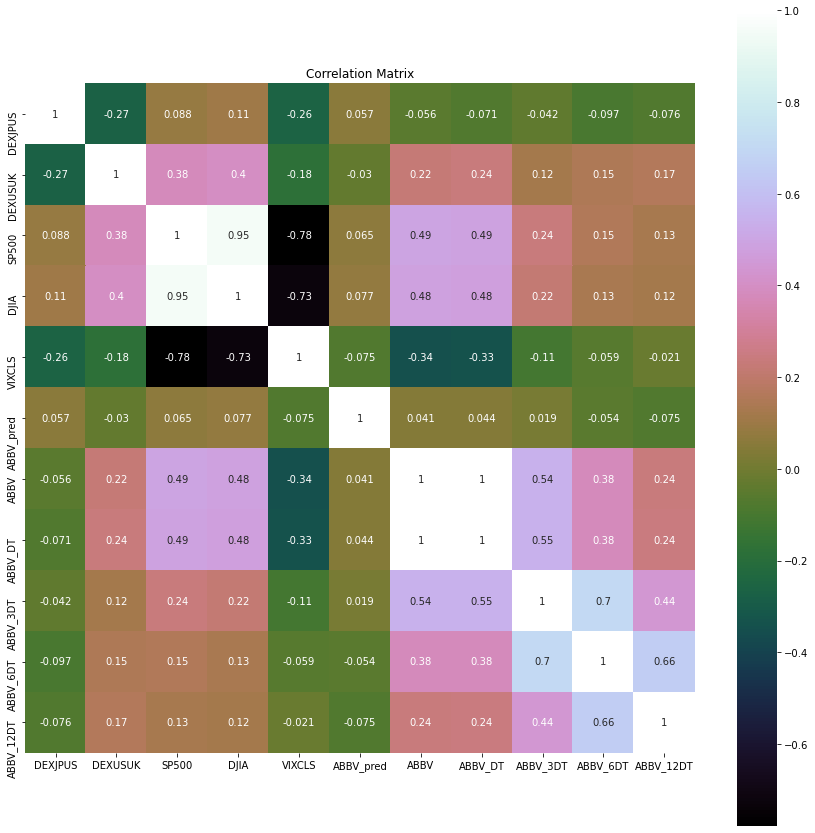

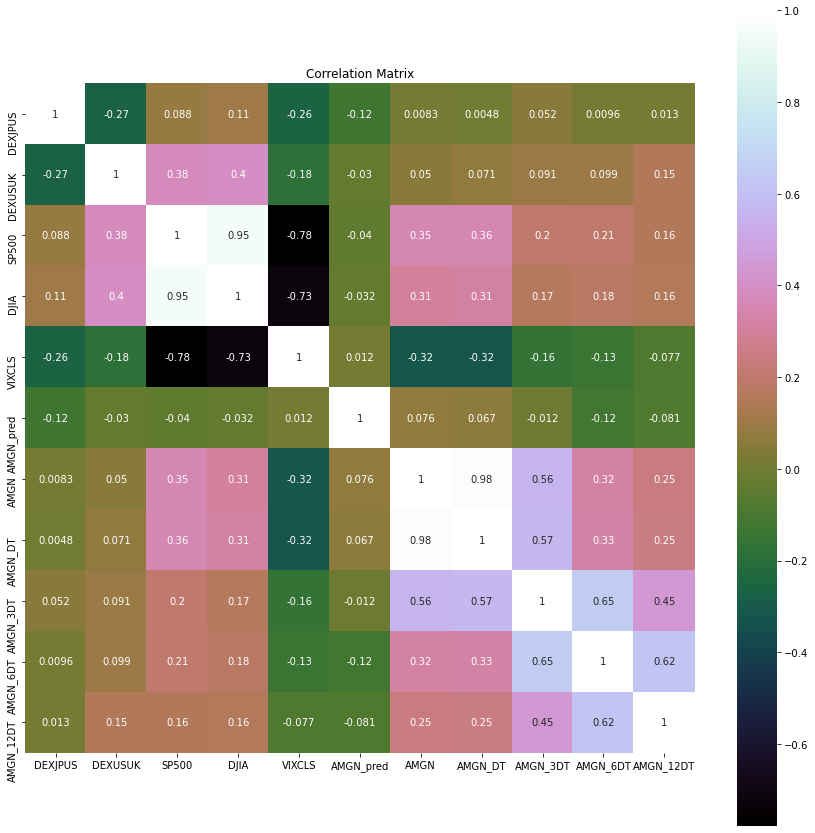

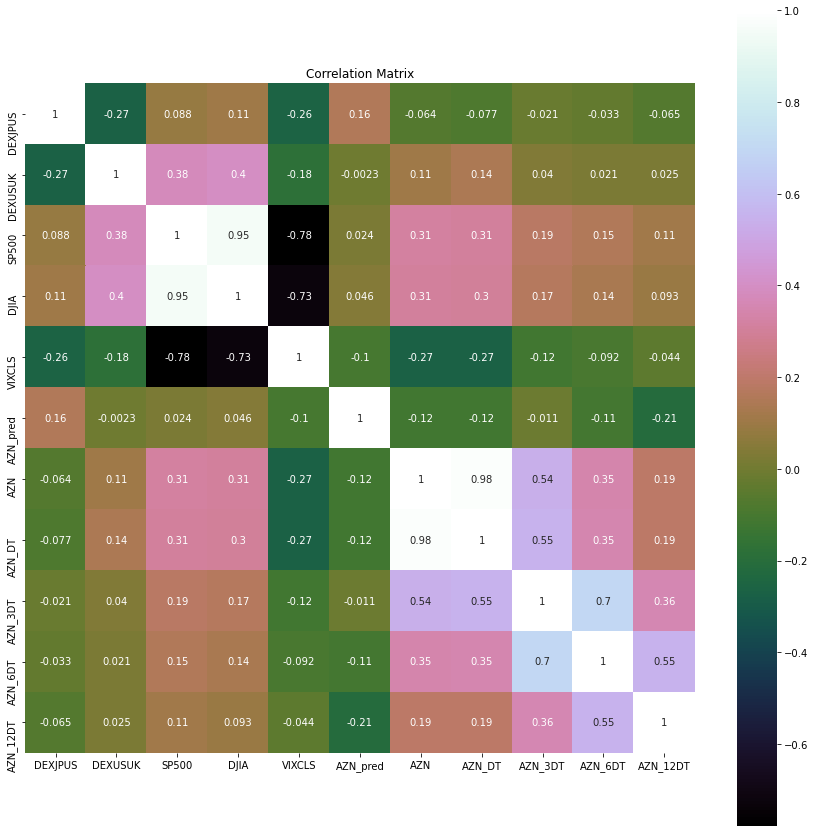

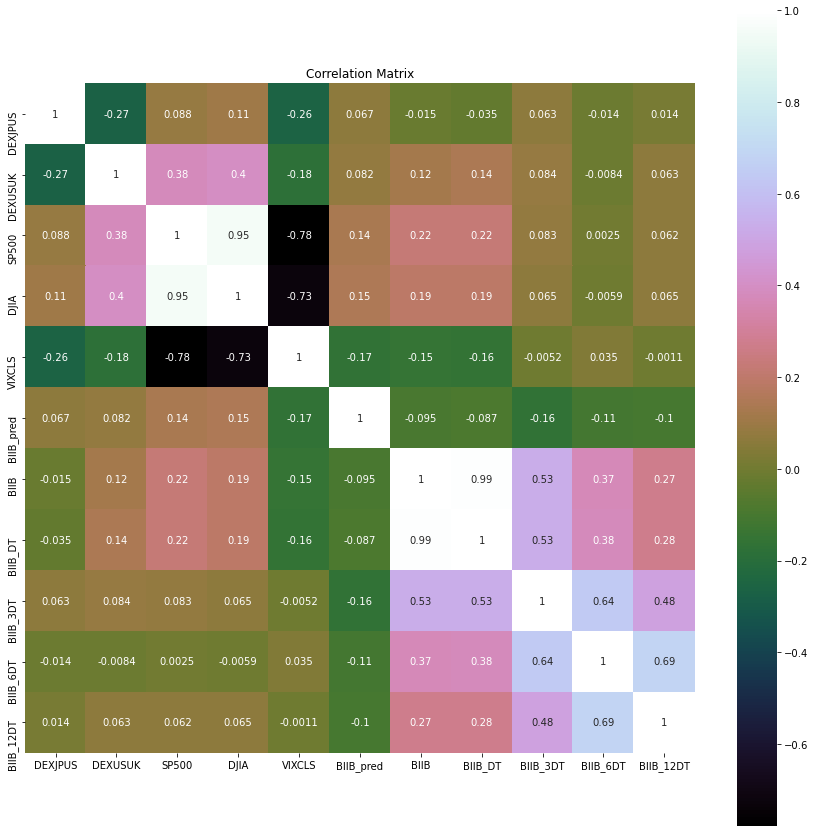

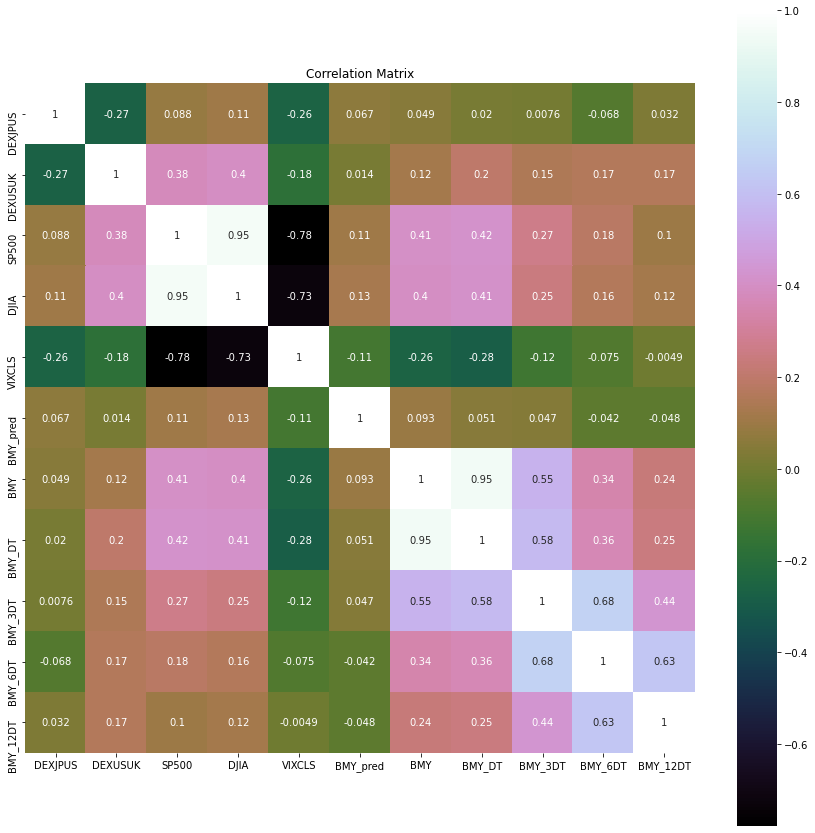

...

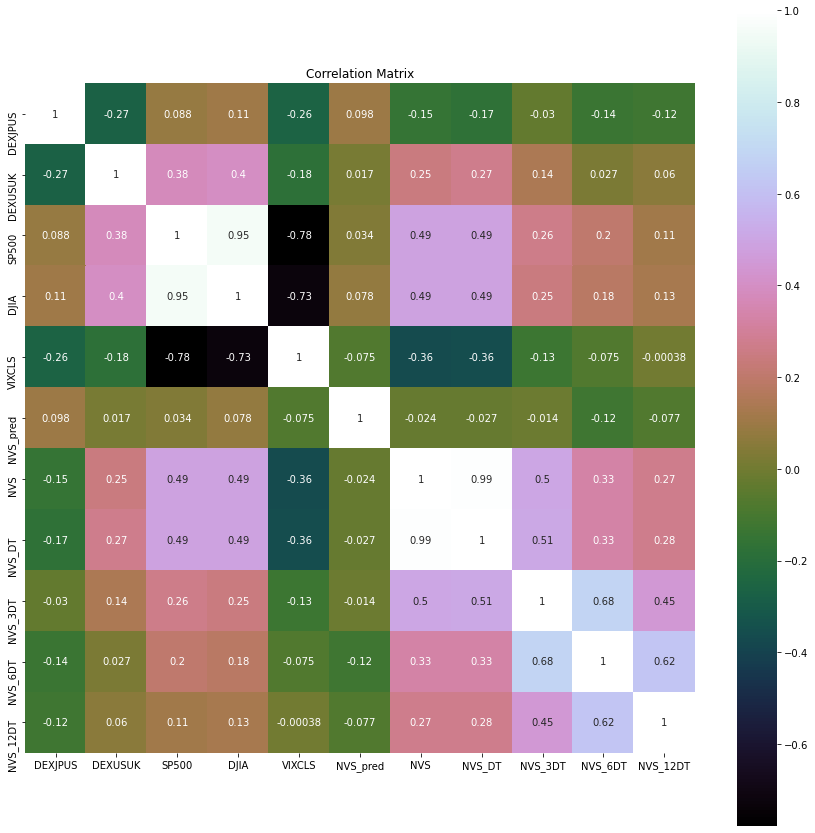

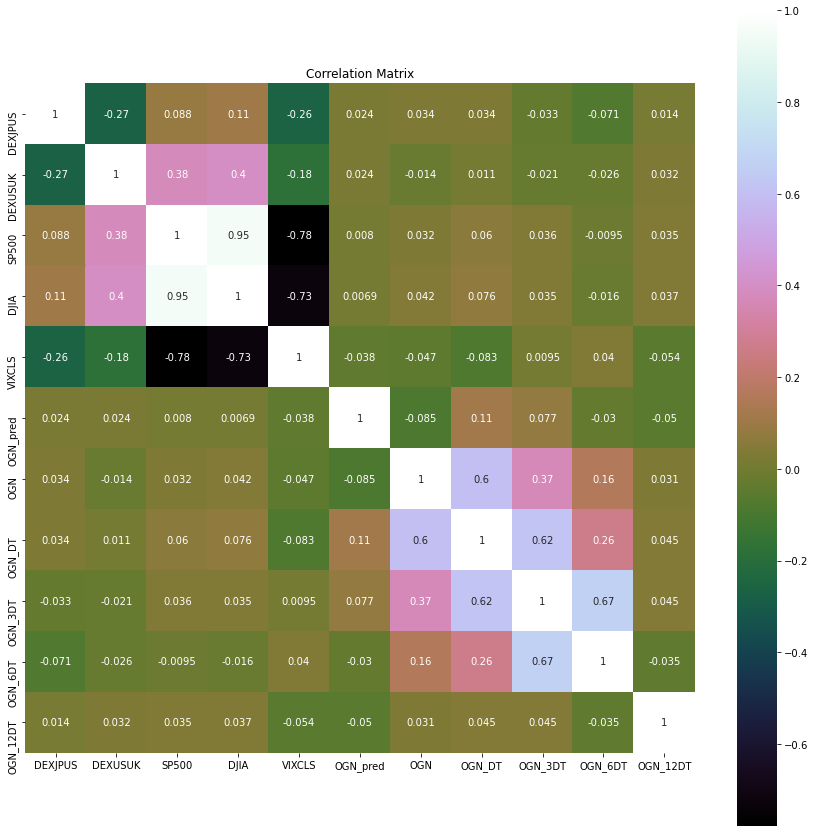

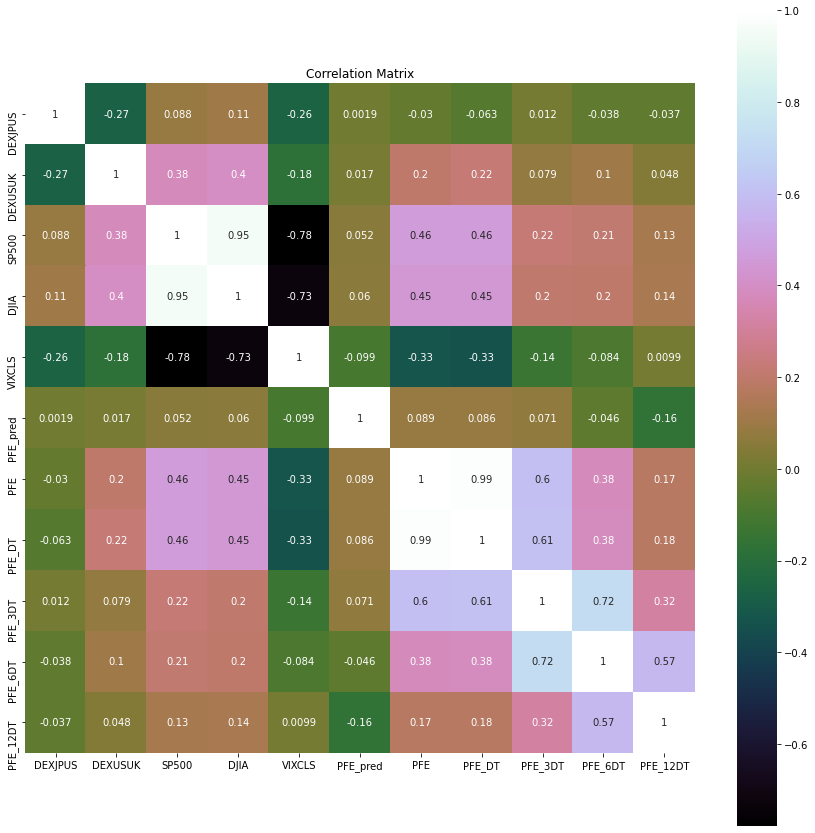

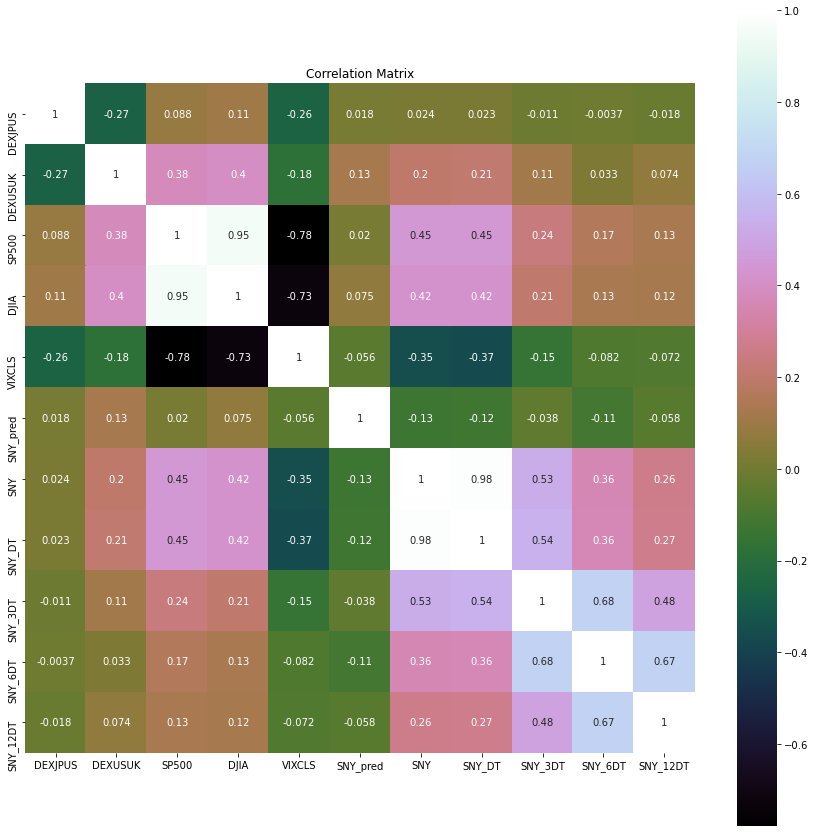

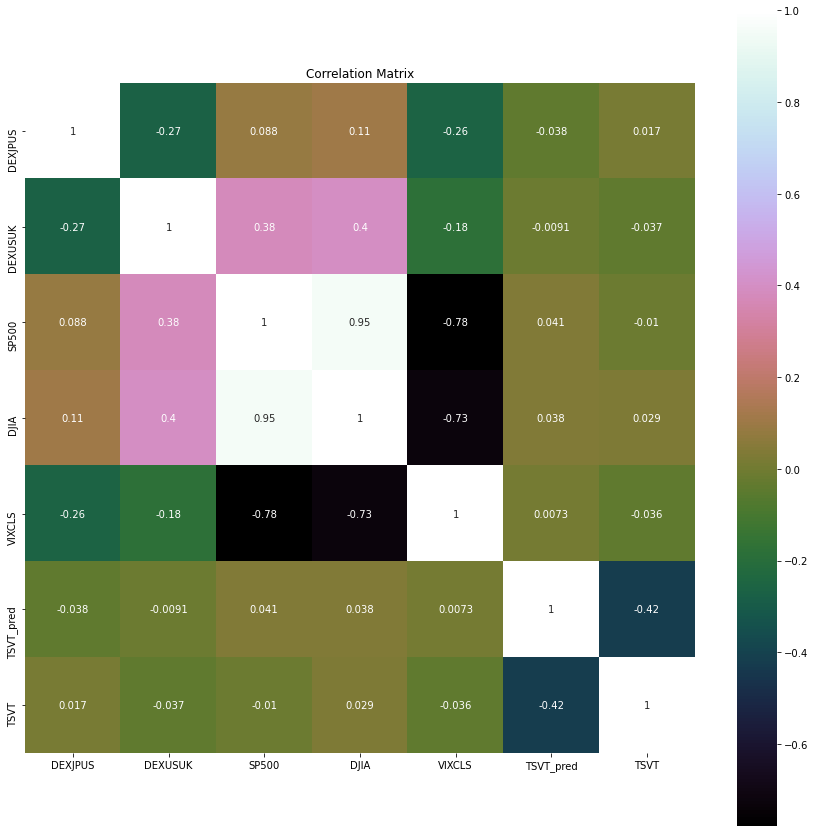

In [58]:
# Plot all tickers
for i in stk_tickers:
    temp = dataset.loc[:,['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]
    temp2 = dataset.filter(regex=i, axis=1)
    temp3 = pd.concat([temp, temp2], axis=1)
    
    correlation = temp3.corr()
    pyplot.figure(figsize=(15,15))
    pyplot.title('Correlation Matrix')
    sns.heatmap(correlation, vmax=1, square=True,annot=True,cmap='cubehelix')
    plt.savefig(f"../readme_images/{i}_correlation_matrix.png")

<Figure size 1080x1080 with 0 Axes>

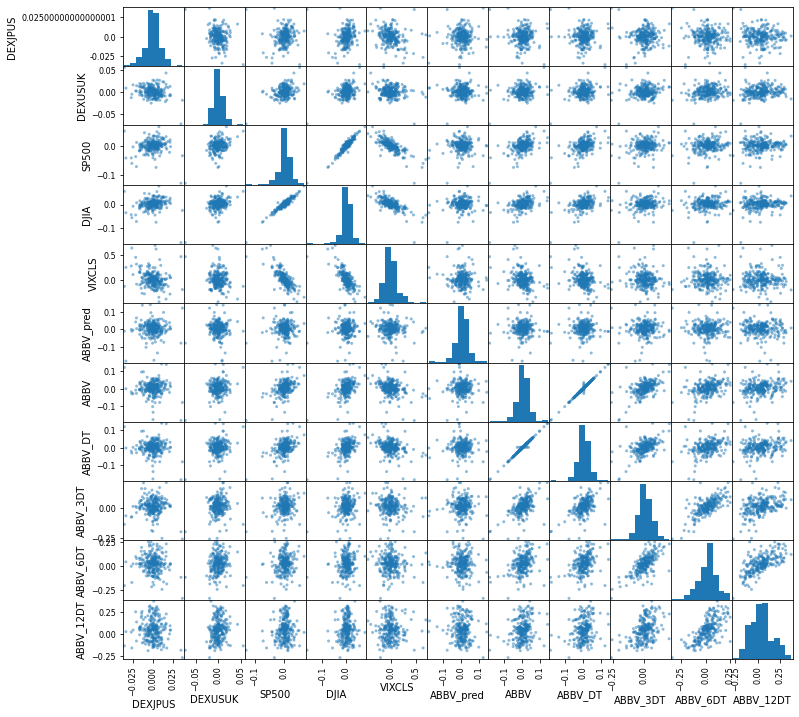

<Figure size 1080x1080 with 0 Axes>

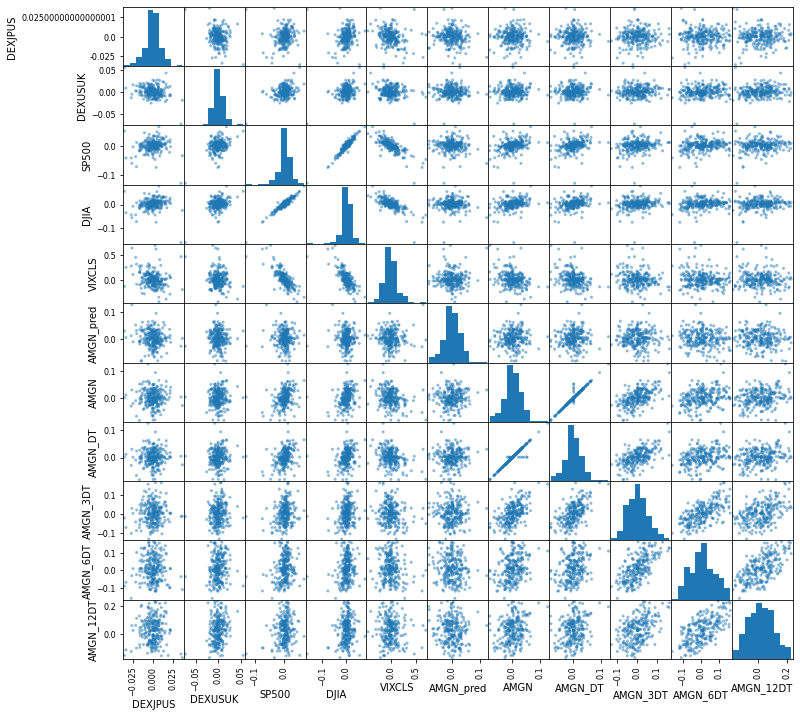

<Figure size 1080x1080 with 0 Axes>

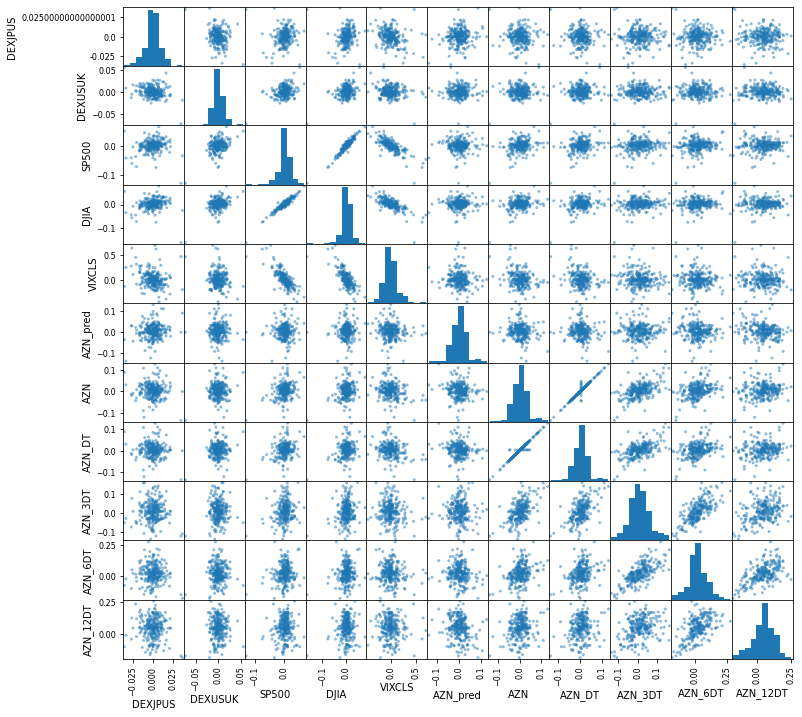

<Figure size 1080x1080 with 0 Axes>

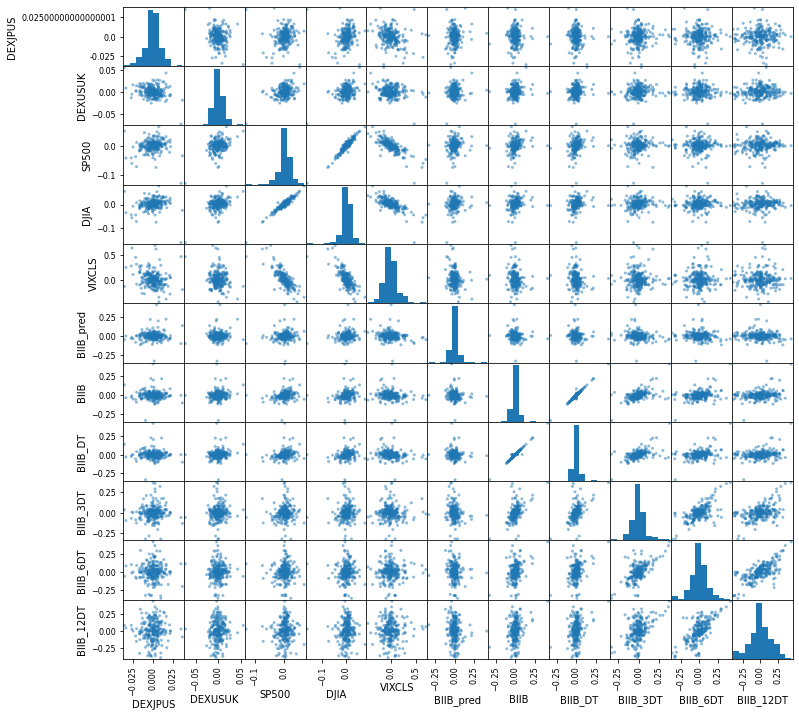

<Figure size 1080x1080 with 0 Axes>

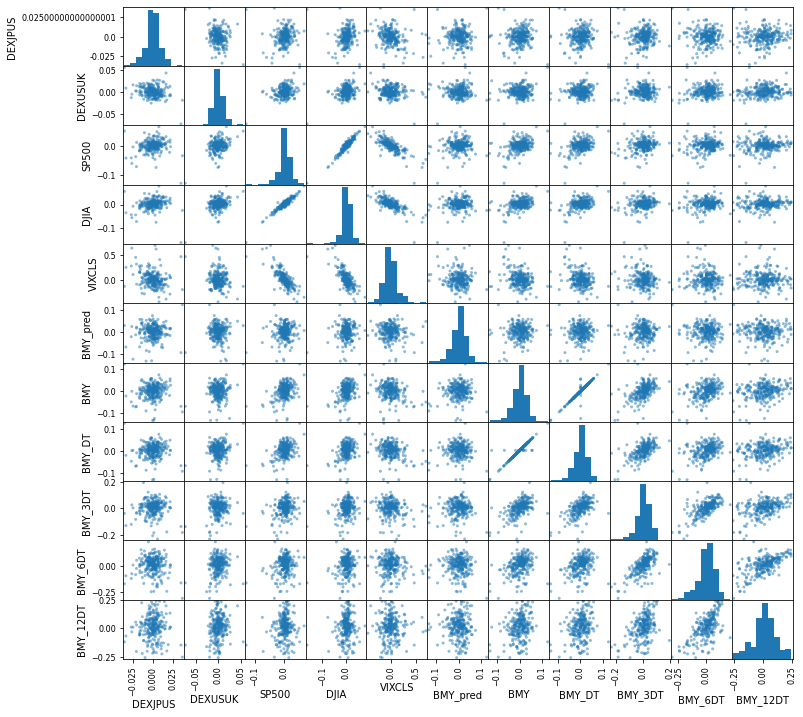

<Figure size 1080x1080 with 0 Axes>

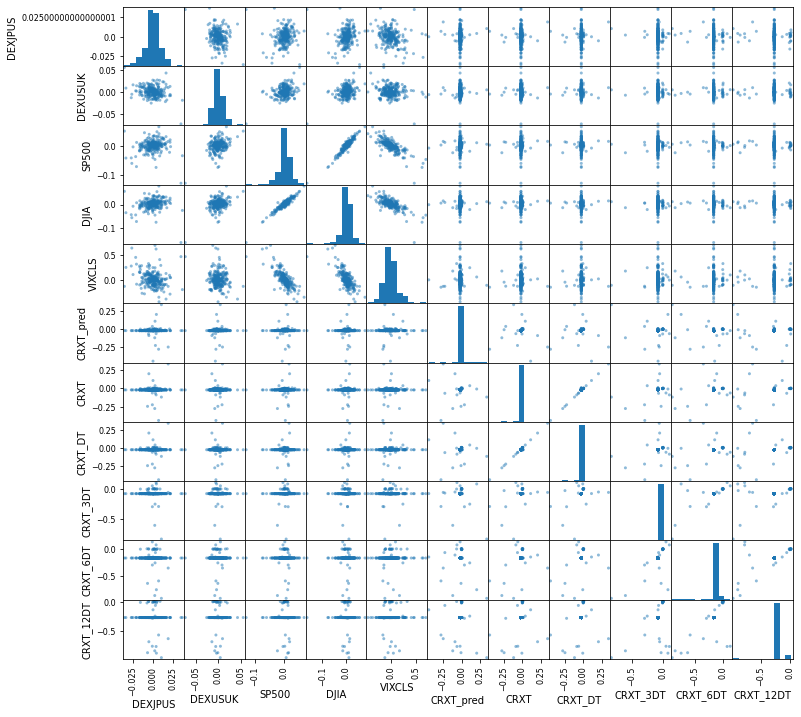

<Figure size 1080x1080 with 0 Axes>

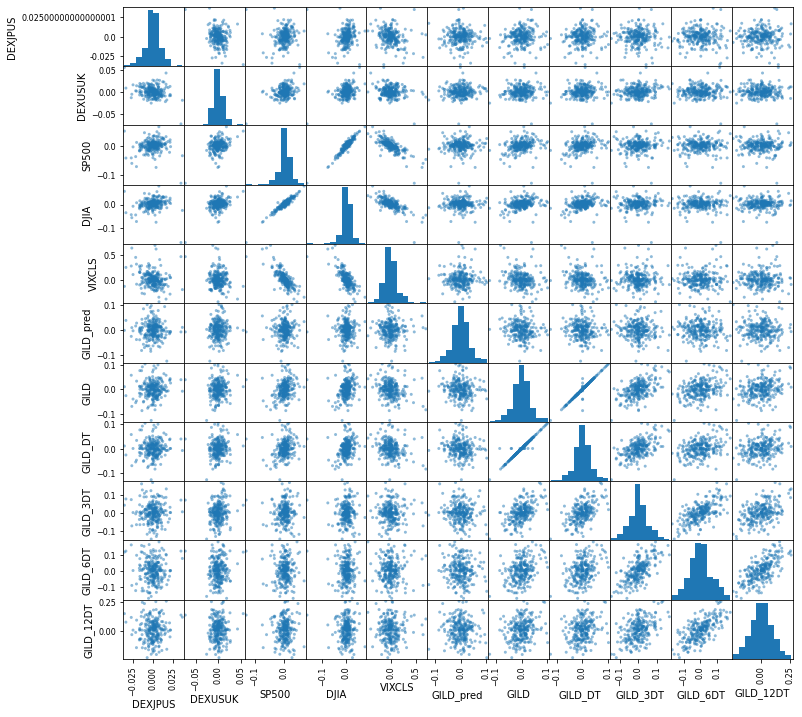

<Figure size 1080x1080 with 0 Axes>

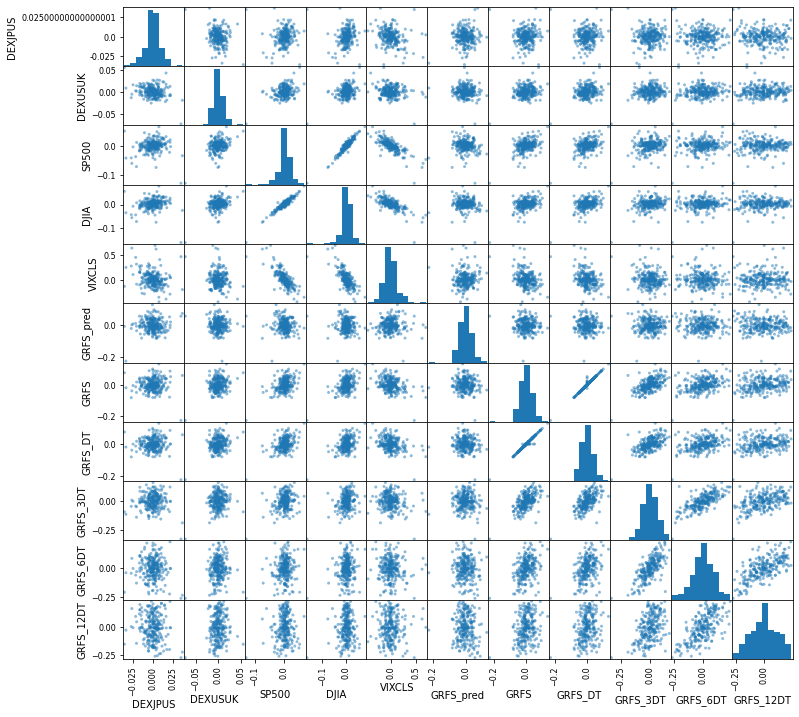

<Figure size 1080x1080 with 0 Axes>

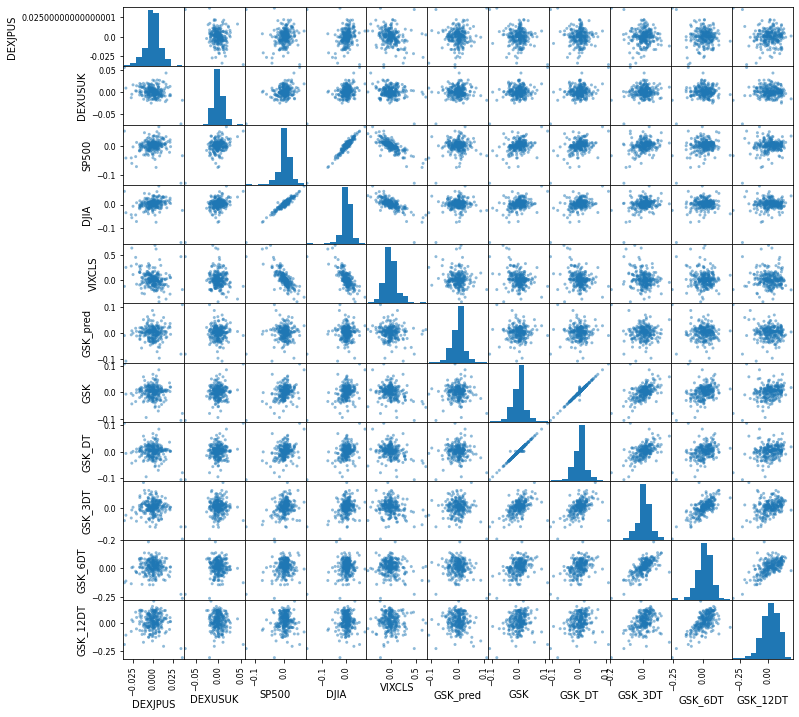

<Figure size 1080x1080 with 0 Axes>

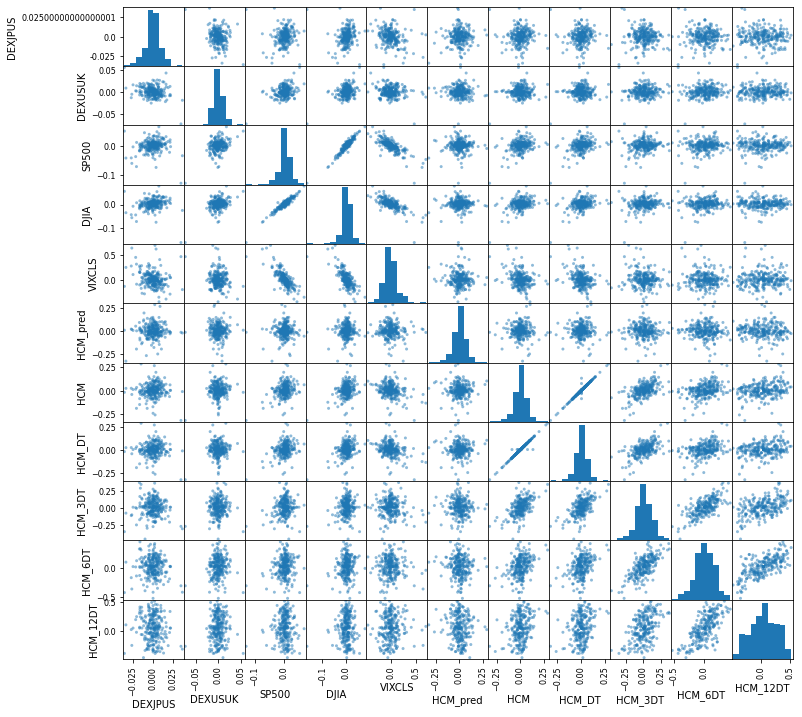

<Figure size 1080x1080 with 0 Axes>

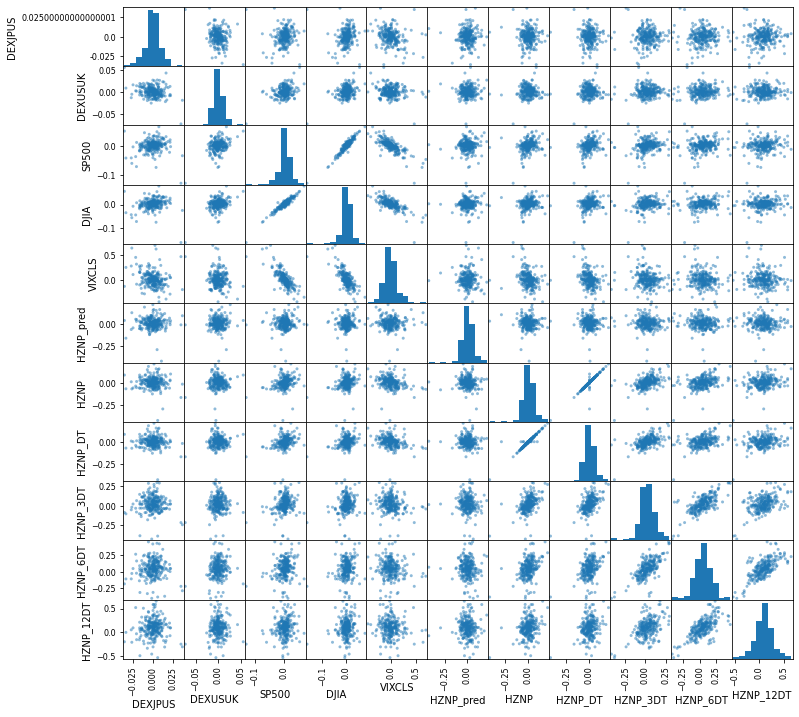

<Figure size 1080x1080 with 0 Axes>

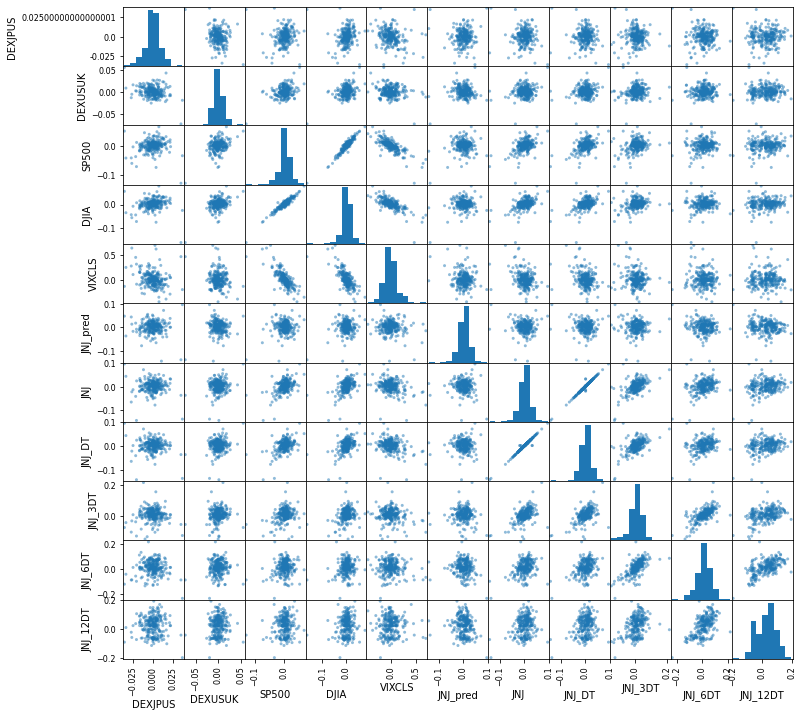

<Figure size 1080x1080 with 0 Axes>

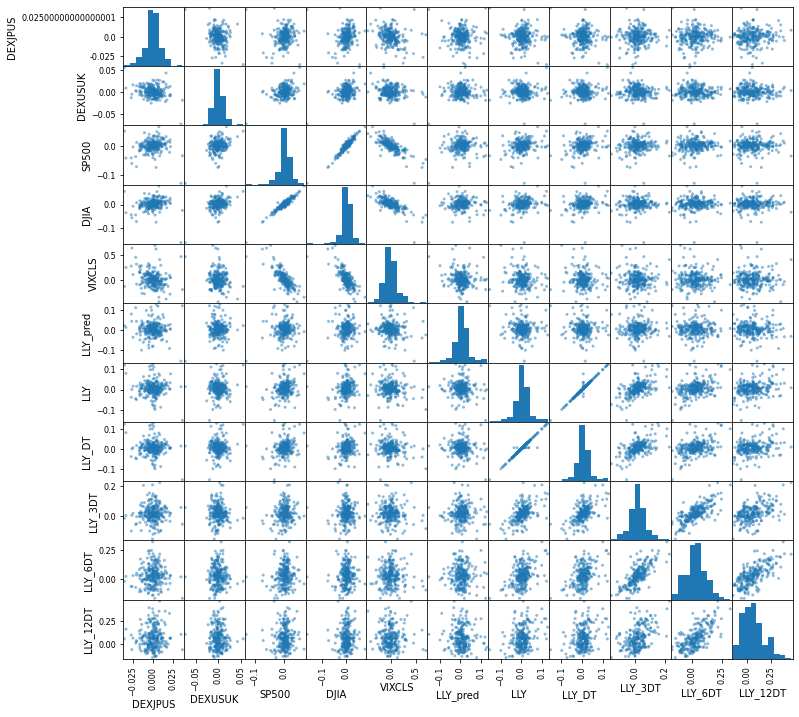

<Figure size 1080x1080 with 0 Axes>

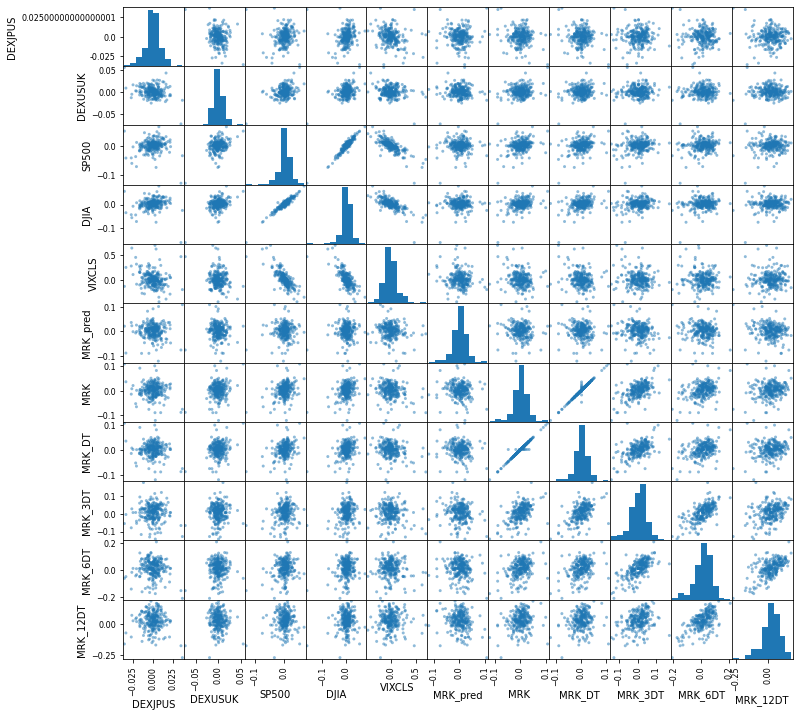

<Figure size 1080x1080 with 0 Axes>

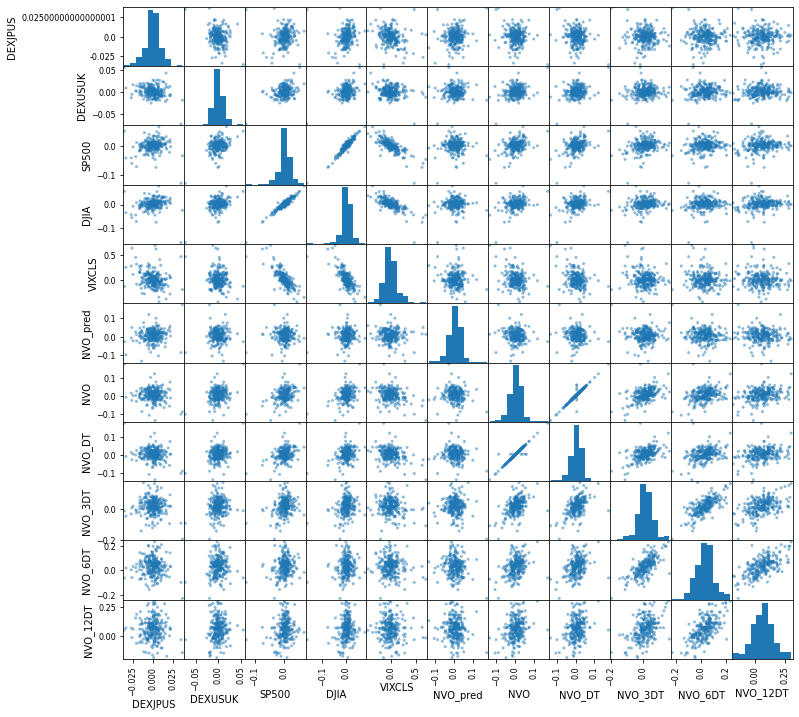

<Figure size 1080x1080 with 0 Axes>

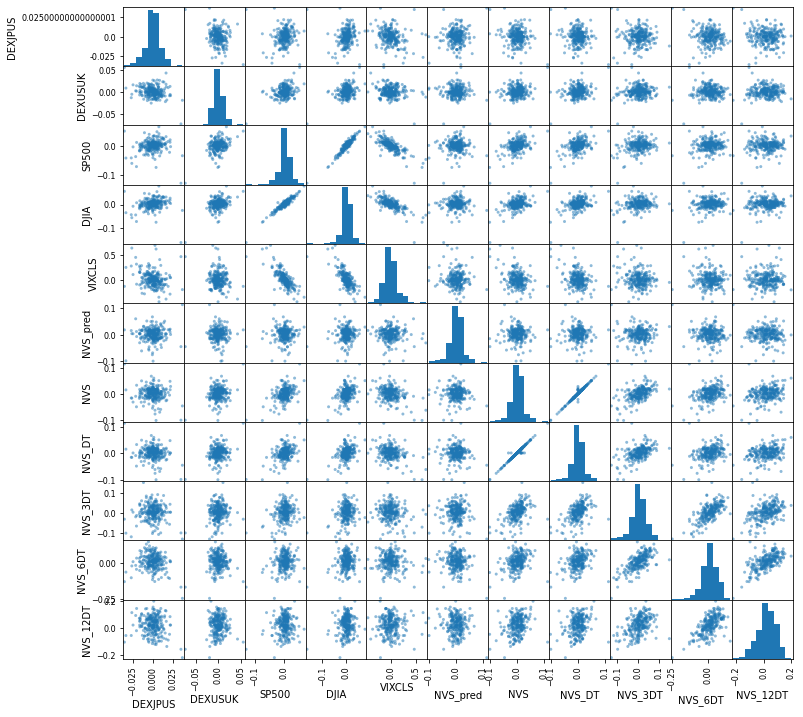

<Figure size 1080x1080 with 0 Axes>

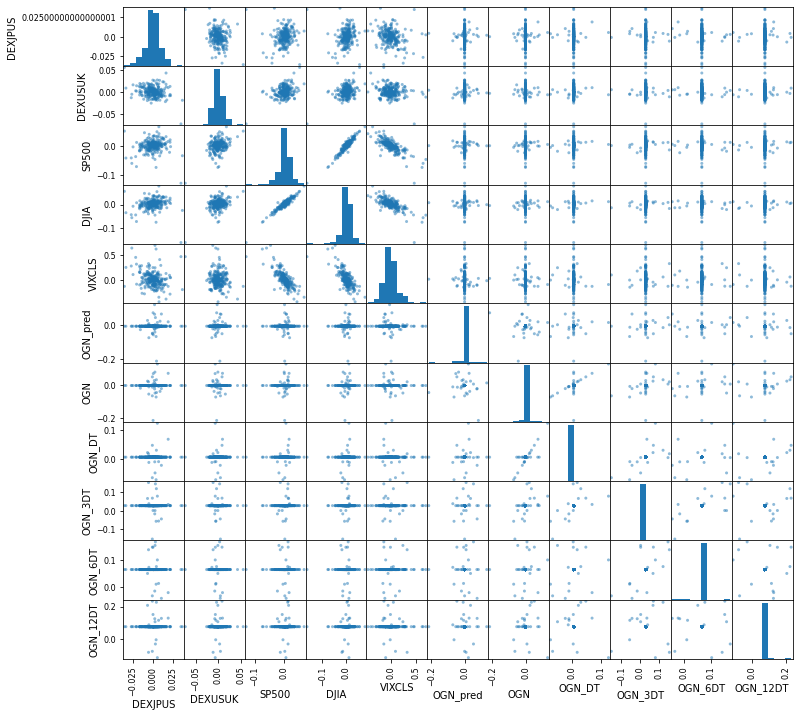

<Figure size 1080x1080 with 0 Axes>

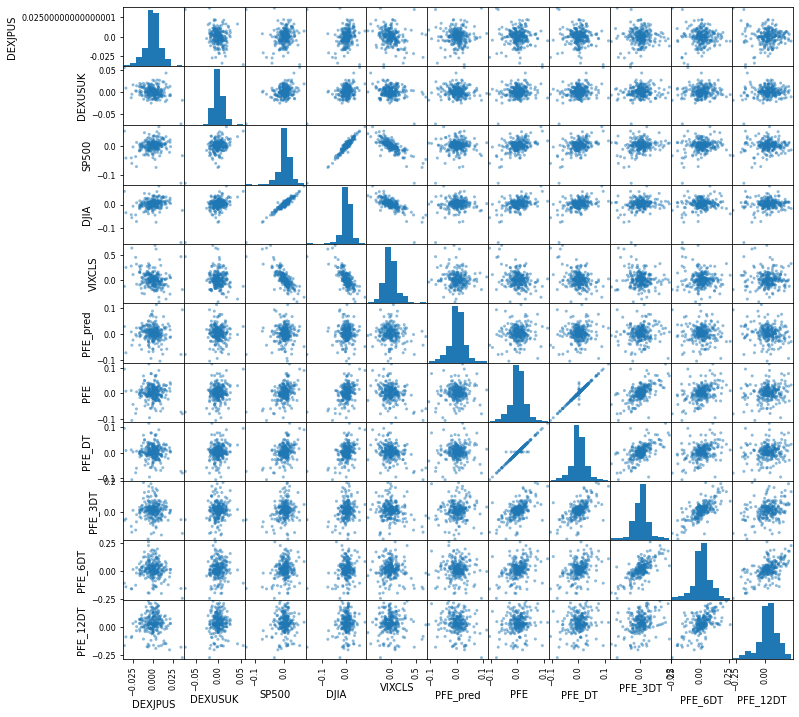

<Figure size 1080x1080 with 0 Axes>

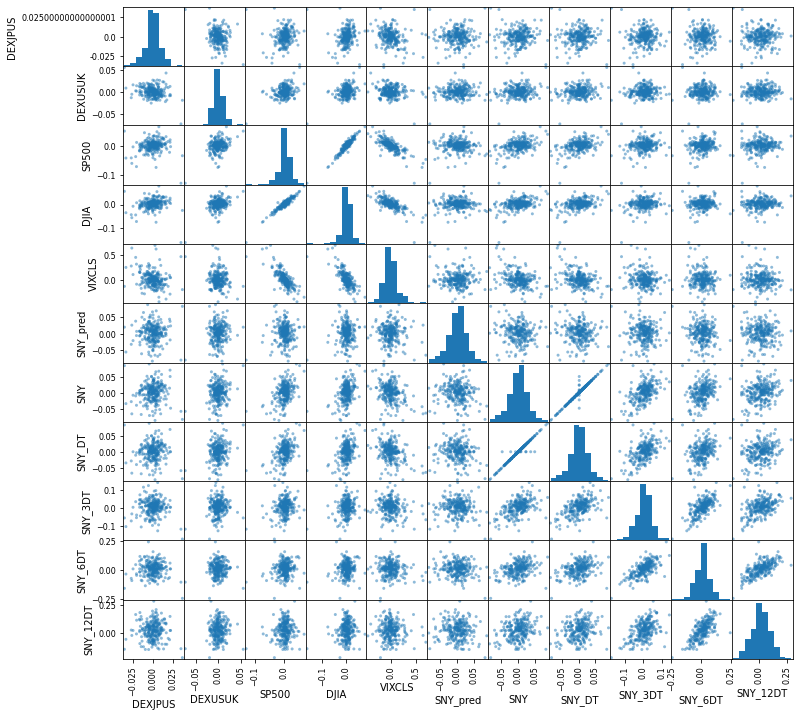

<Figure size 1080x1080 with 0 Axes>

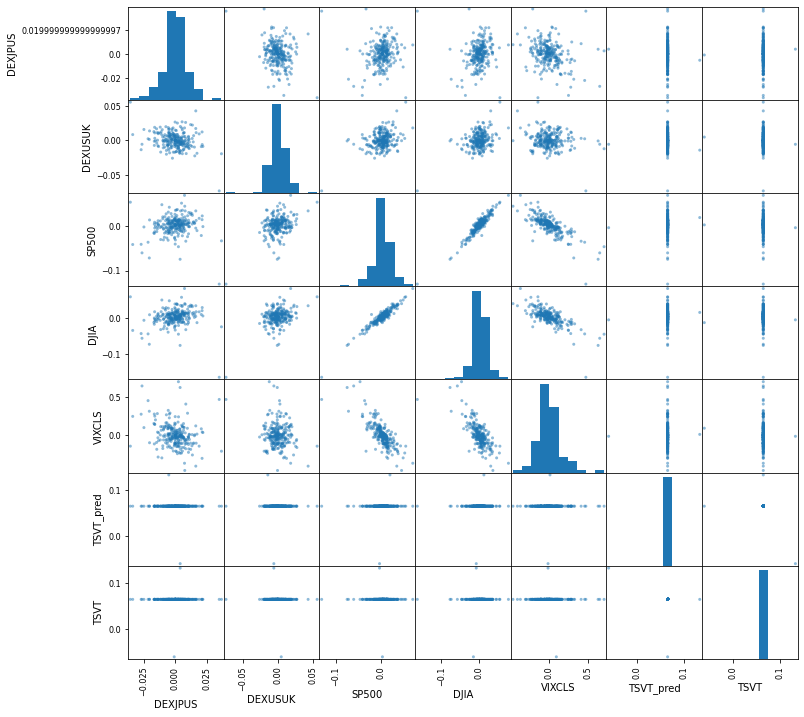

In [59]:
# Plot all tickers
for i in stk_tickers:
    temp = dataset.loc[:,['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]
    temp2 = dataset.filter(regex=i, axis=1)
    temp3 = pd.concat([temp, temp2], axis=1)
    
    pyplot.figure(figsize=(15,15))
    scatter_matrix(temp3,figsize=(12,12))
    plt.savefig(f"../readme_images/{i}_scatter_matrix.png")
    pyplot.show()    

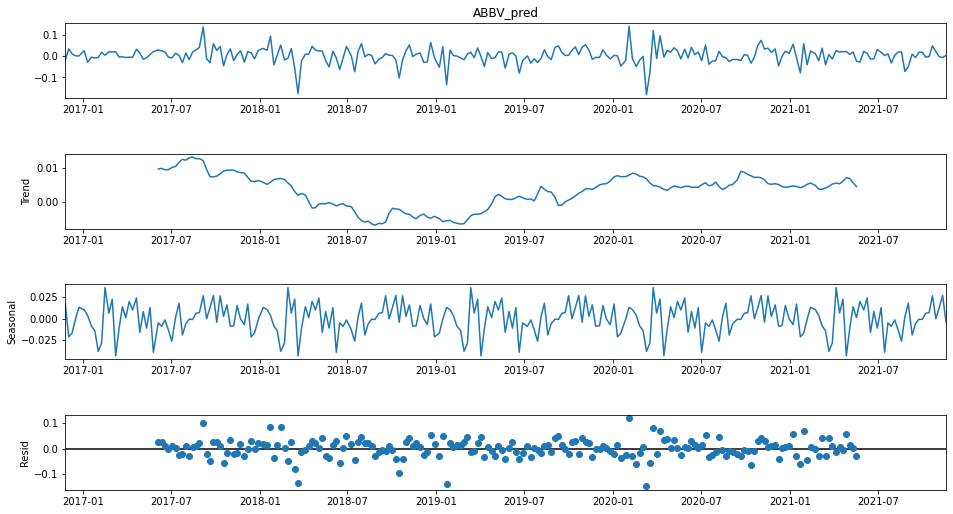

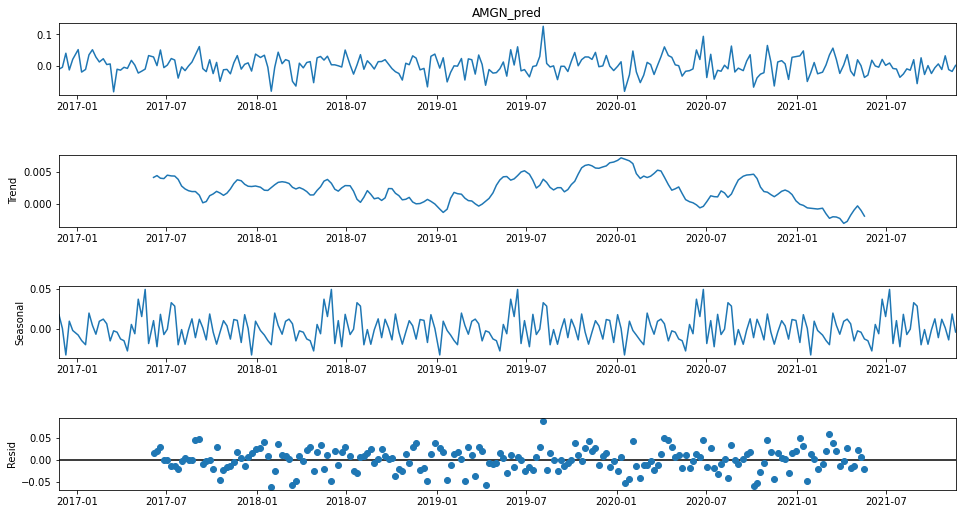

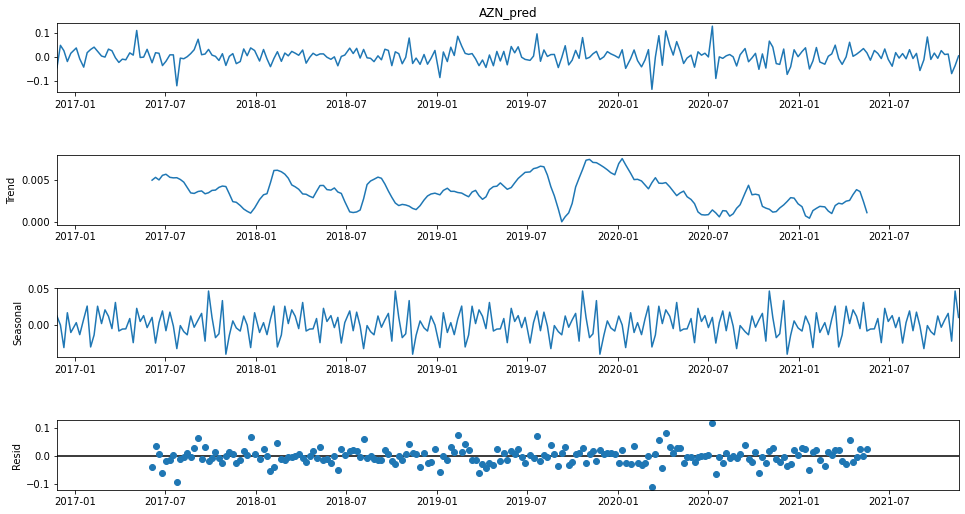

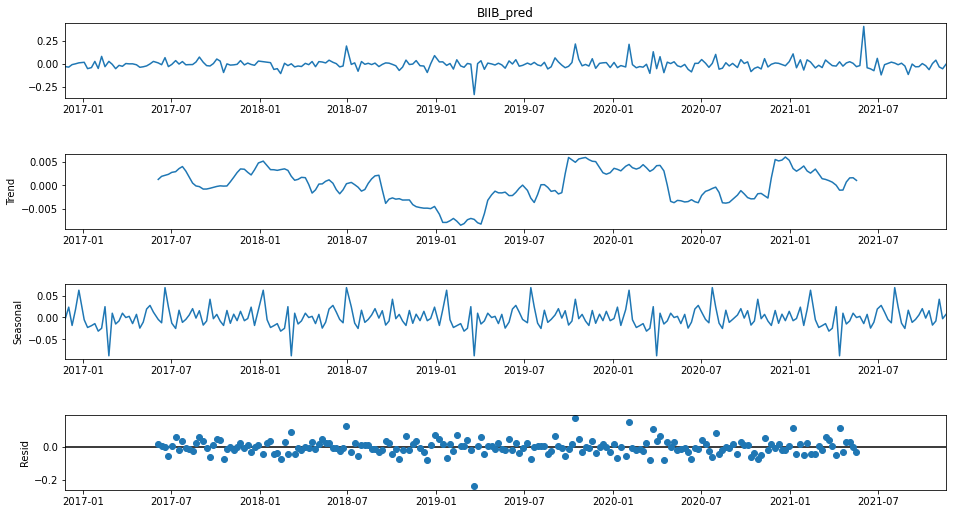

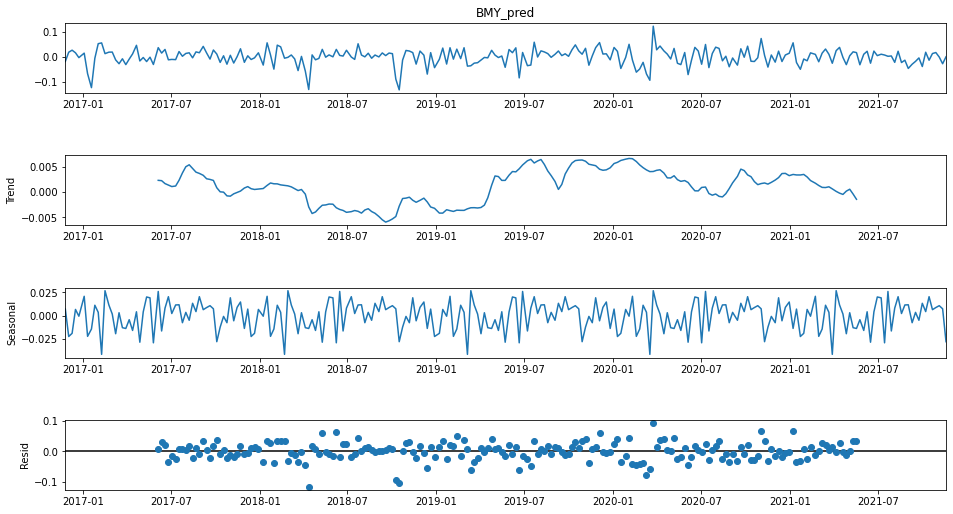

...

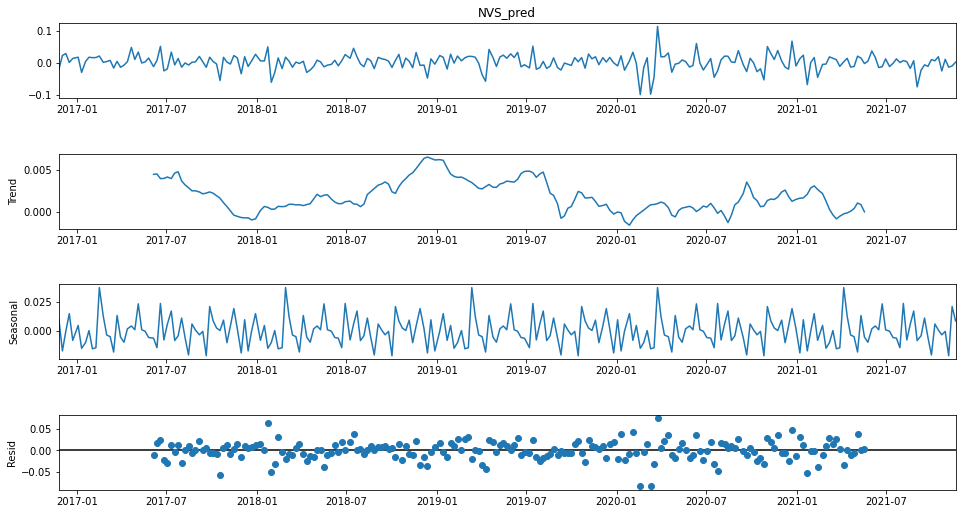

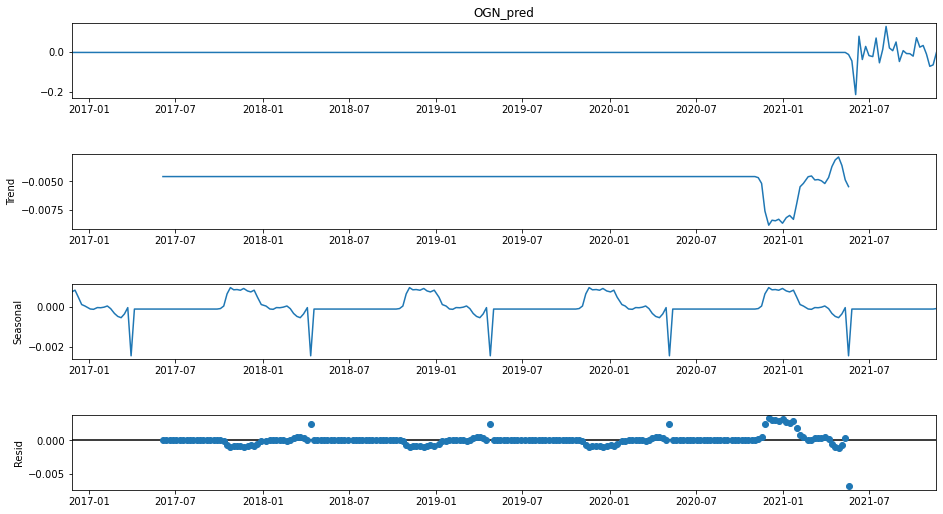

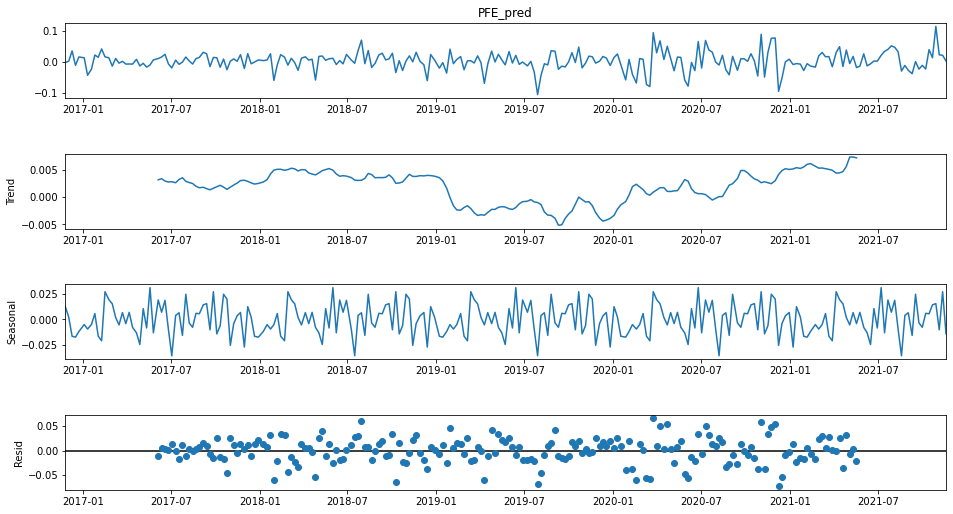

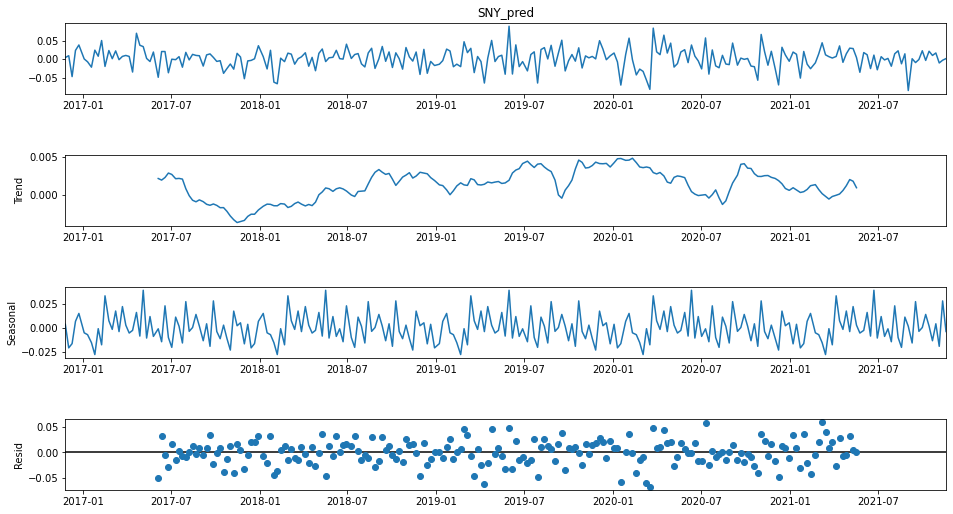

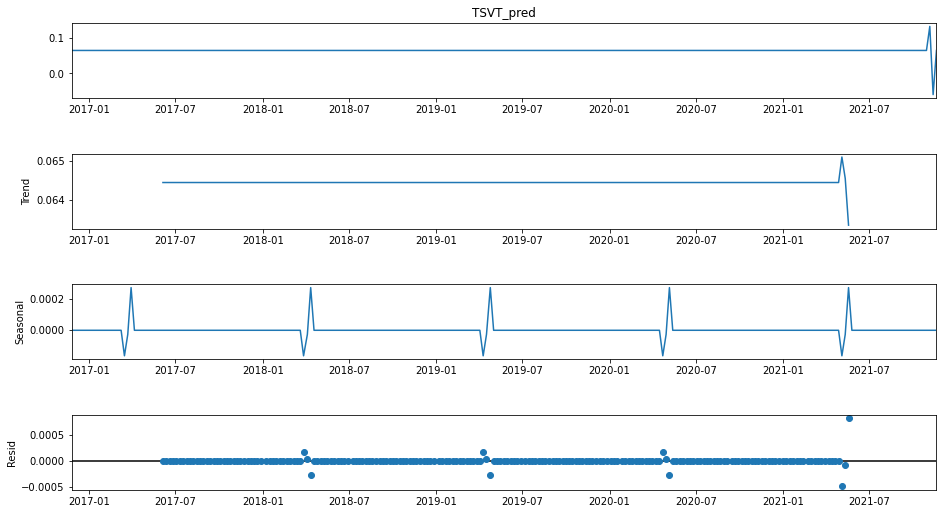

In [60]:
# Seasonality
for i in stk_tickers:
    res = sm.tsa.seasonal_decompose(Y.loc[:,i+'_pred'],period=52)
    fig = res.plot()
    fig.set_figheight(8)
    fig.set_figwidth(15)
    plt.savefig(f"../readme_images/{i}_seasonality.png")
    pyplot.show()

In [61]:
validation_size = 0.2
train_size = int(len(X) * (1-validation_size))
X_train, X_test = X[0:train_size], X[train_size:len(X)]
Y_train, Y_test = Y[0:train_size], Y[train_size:len(X)]

In [62]:
num_folds = 10
scoring = 'neg_mean_squared_error'

In [63]:
# Without the tuning hyperparameters
models = []
#models.append(('LR', LinearRegression()))
models.append(('LASSO', Lasso()))
models.append(('EN', ElasticNet()))
models.append(('KNN', KNeighborsRegressor()))
models.append(('CART', DecisionTreeRegressor()))
models.append(('SVR', SVR()))

In [64]:
models.append(('MLP', MLPRegressor()))
# Boosting methods
models.append(('ABR', AdaBoostRegressor()))
models.append(('GBR', GradientBoostingRegressor())) 
# Bagging methods
models.append(('RFR', RandomForestRegressor()))
models.append(('ETR', ExtraTreesRegressor()))

In [65]:
from random import seed

In [66]:
seed(1)

In [67]:
#stk_idx_coin_tickers = stk_tickers + ['DEXJPUS'] + ['DEXUSUK'] + ['SP500'] + ['DJIA'] + ['VIXCLS']
#X_train.loc[:, stk_tickers + ['DEXJPUS'] + ['DEXUSUK'] + ['SP500'] + ['DJIA'] + ['VIXCLS']]
X_test

,ABBV,AMGN,AZN,BIIB,BMY,CRXT,GILD,GRFS,GSK,HCM,...,OGN_6DT,OGN_12DT,PFE_DT,PFE_3DT,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT
2020-11-23,0.038102,-0.062957,-0.028653,-0.030670,-0.040822,-0.019542,-0.019839,-0.031129,-0.035298,0.020821,...,0.065857,0.076650,0.030655,0.070797,0.054643,0.025469,-0.016316,0.071504,-0.024375,-0.006997
2020-12-01,0.018039,0.012788,-0.031949,-0.000904,0.007882,-0.019542,0.020330,0.031129,0.021008,-0.017211,...,0.065857,0.076650,0.076160,0.057935,0.104535,0.143374,0.021434,0.025857,0.015633,0.029086
2020-12-08,0.034481,0.017004,0.032315,0.013358,-0.020886,-0.019542,0.000818,-0.034887,0.003193,-0.047972,...,0.065857,0.076650,0.076895,0.183710,0.178260,0.202551,-0.025857,-0.020738,0.010126,-0.040475
2020-12-15,-0.046277,0.006921,-0.073743,0.009290,0.023447,-0.019542,-0.017603,0.021815,-0.022026,0.001717,...,0.065857,0.076650,-0.094817,0.058238,0.129034,0.134848,-0.069670,-0.074092,-0.002589,-0.093954
2020-12-22,-0.000195,-0.042264,-0.042192,-0.003464,-0.018388,-0.019542,-0.041748,-0.003691,-0.020025,0.004450,...,0.065857,0.076650,-0.052232,-0.070154,-0.012218,0.072396,0.032309,-0.063217,-0.037361,-0.064591
2020-12-30,0.023743,0.027581,0.029322,-0.017459,0.007945,-0.019542,-0.006159,-0.022977,0.025983,0.072765,...,0.065857,0.076650,0.000000,-0.147049,0.036661,0.062552,0.011438,-0.025922,-0.046661,-0.052760
2021-01-07,0.013586,0.029708,0.000199,0.027774,0.015026,-0.019542,0.098595,0.040779,0.027428,0.143249,...,0.065857,0.076650,0.008672,-0.043560,0.014678,0.069321,-0.005599,0.038148,-0.035944,-0.060319
2021-01-14,0.056703,0.032125,0.021680,0.112605,0.057034,-0.019542,-0.001921,-0.006247,0.002361,-0.037571,...,0.065857,0.076650,-0.008400,0.000272,-0.069881,0.034653,0.019358,0.025197,-0.038020,-0.022387
2021-01-22,-0.006922,0.047832,0.037502,-0.039479,-0.022363,-0.019542,0.070231,-0.005236,0.005227,-0.025171,...,0.065857,0.076650,-0.005457,-0.005185,-0.152234,0.026027,0.013371,0.027131,0.001208,0.011334
2021-01-29,-0.078600,-0.048784,-0.051046,0.047722,-0.049697,-0.019542,-0.020221,-0.074633,-0.029363,-0.067257,...,0.065857,0.076650,-0.007124,-0.020981,-0.064541,0.064494,-0.051198,-0.018469,0.019680,0.017091


In [68]:
X

,ABBV,AMGN,AZN,BIIB,BMY,CRXT,GILD,GRFS,GSK,HCM,...,OGN_6DT,OGN_12DT,PFE_DT,PFE_3DT,PFE_6DT,PFE_12DT,SNY_DT,SNY_3DT,SNY_6DT,SNY_12DT
2016-11-25,0.003571,0.001954,0.003727,-0.000668,0.000679,-0.019542,0.000429,-0.000697,0.001384,0.003513,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-02,-0.018010,-0.009813,-0.045677,-0.026596,-0.018063,-0.019542,-0.040855,-0.024129,-0.030305,0.133134,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-09,0.034888,-0.003896,0.047888,-0.032210,0.019116,-0.019542,0.003859,-0.007987,0.002384,-0.025389,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-16,0.010989,0.040440,0.025447,-0.004772,0.027323,-0.019542,0.025492,0.049945,0.019652,0.002141,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
2016-12-23,0.001927,-0.012259,-0.019939,0.003938,0.016747,-0.019542,-0.006227,0.020305,-0.004943,-0.012552,...,0.065857,0.076650,0.002714,0.008087,0.014744,0.028253,0.001434,0.004831,0.009897,0.019795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-22,-0.001739,0.006713,0.025737,-0.060056,-0.013108,-0.246263,-0.005783,-0.032884,0.019295,-0.004033,...,0.051205,0.207079,0.039462,0.005343,-0.054774,0.008610,0.021667,0.041306,0.032576,-0.031742
2021-10-29,0.049427,-0.010908,0.009503,0.007075,0.013793,-0.007186,-0.035729,-0.048391,0.062383,-0.089360,...,0.076896,0.225961,0.013349,0.029936,-0.003423,-0.029732,0.010165,0.028562,0.041500,-0.002575
2021-11-05,0.021653,0.032327,0.011318,0.044015,0.017820,0.203725,0.021952,-0.070301,0.027035,0.017855,...,0.074066,0.087966,0.114306,0.167116,0.109744,0.037328,0.016910,0.048741,0.067546,-0.000390
2021-11-12,-0.001794,-0.011196,-0.070420,-0.030051,-0.000336,-0.088081,0.017340,-0.019835,-0.002994,0.036069,...,0.011040,-0.003554,0.022779,0.150434,0.155777,0.027618,-0.010190,0.016884,0.058190,-0.033317


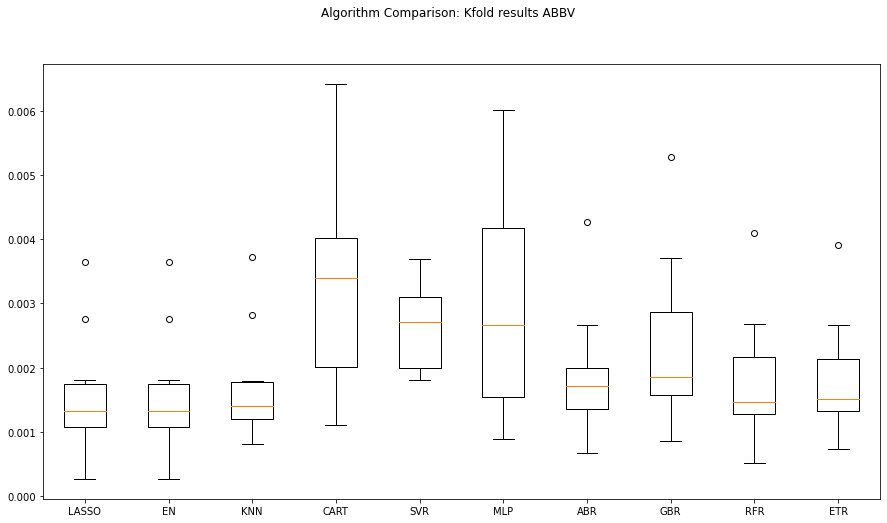

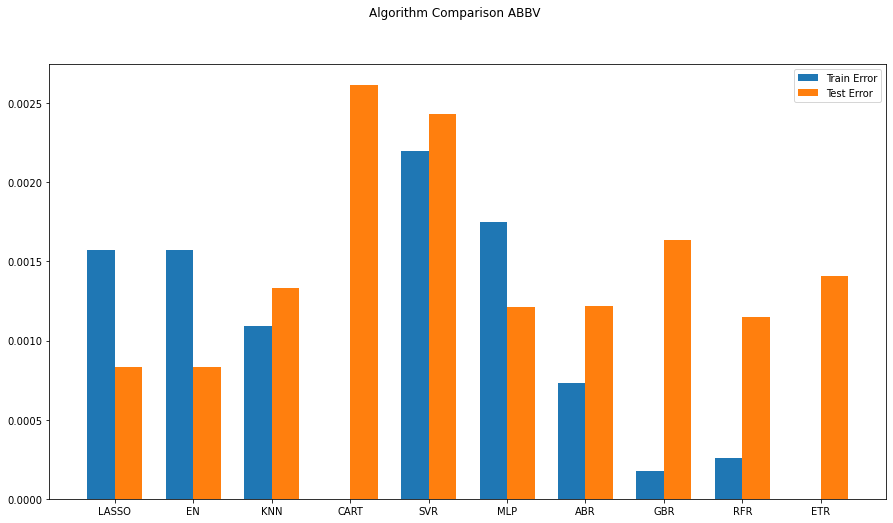

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0009932074634303033
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

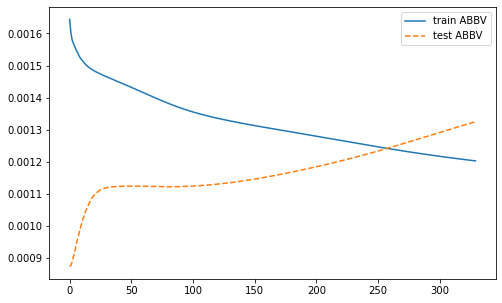

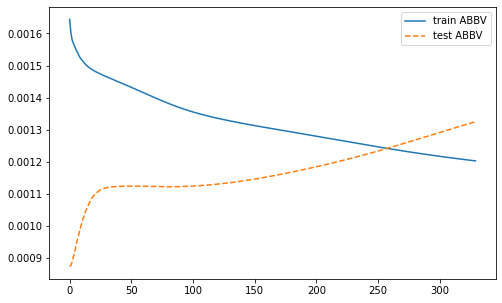

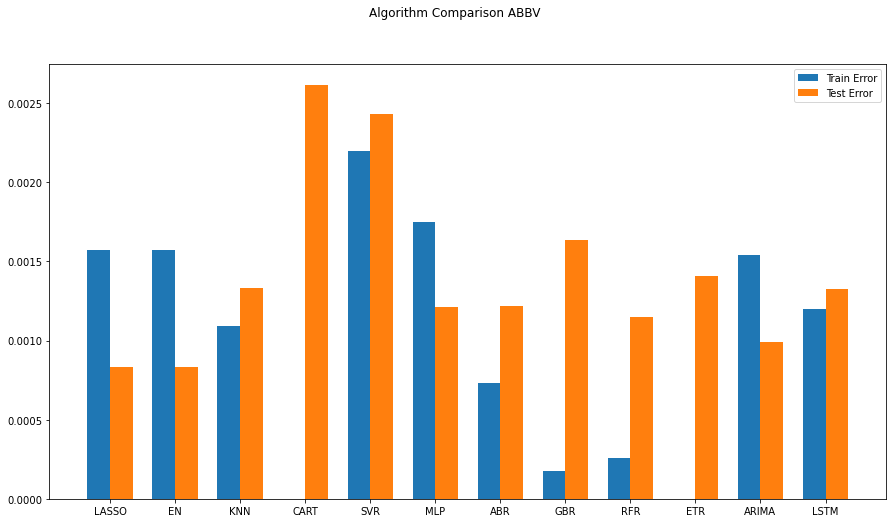

ARIMA(0, 0, 0) MSE=0.0015271
ARIMA(0, 0, 1) MSE=0.0015245
ARIMA(1, 0, 0) MSE=0.0015253
ARIMA(1, 0, 1) MSE=0.0014853
ARIMA(2, 0, 0) MSE=0.0015062
ARIMA(2, 0, 1) MSE=0.0014846
Best ARIMA(2, 0, 1) MSE=0.0014846
0.0009932074634303033


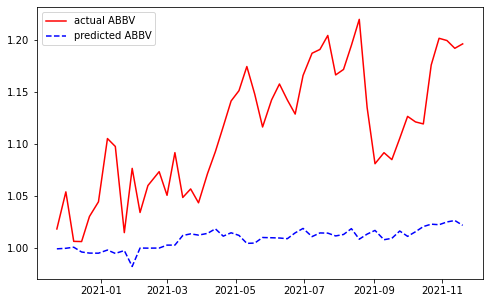

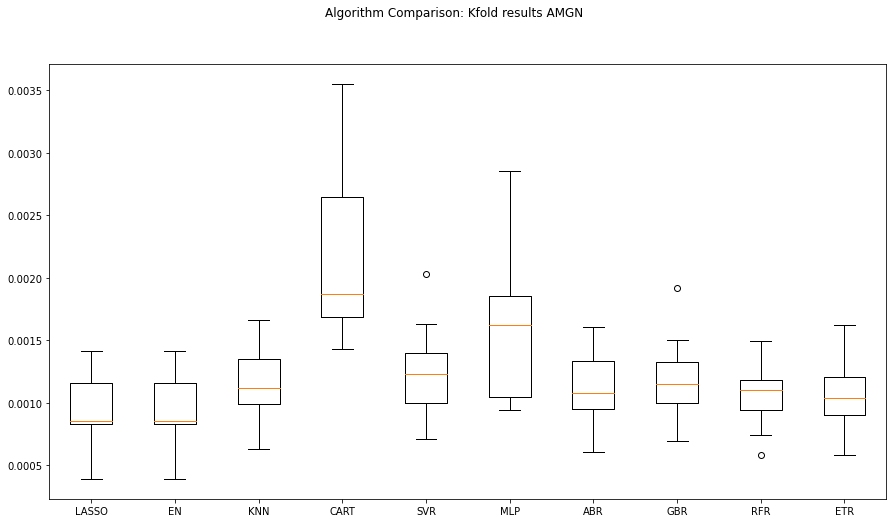

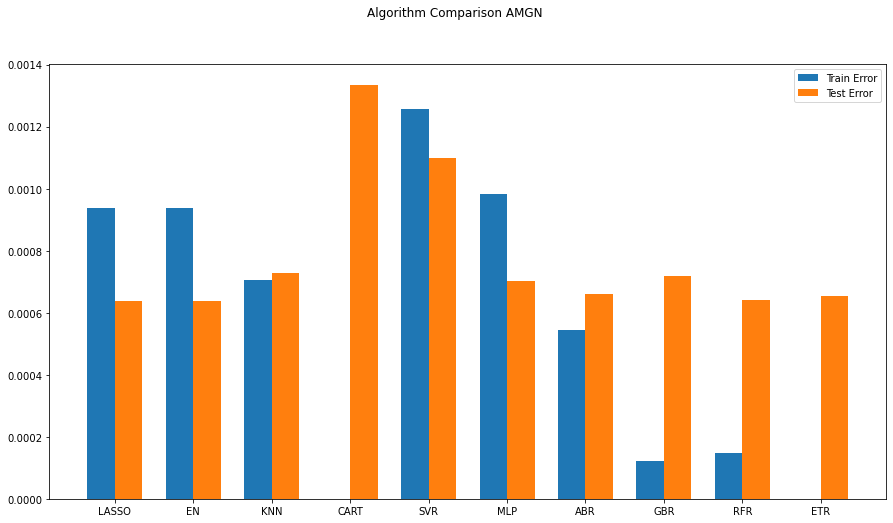

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0006591214914147195
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

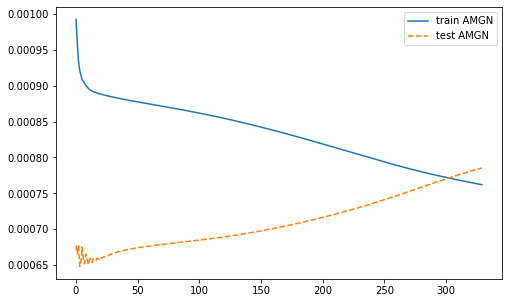

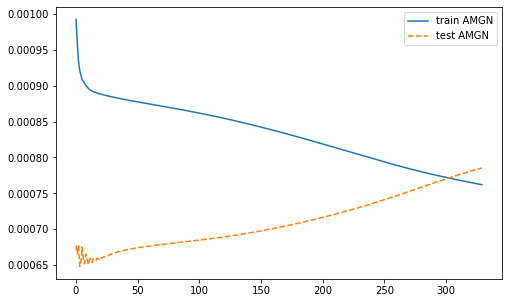

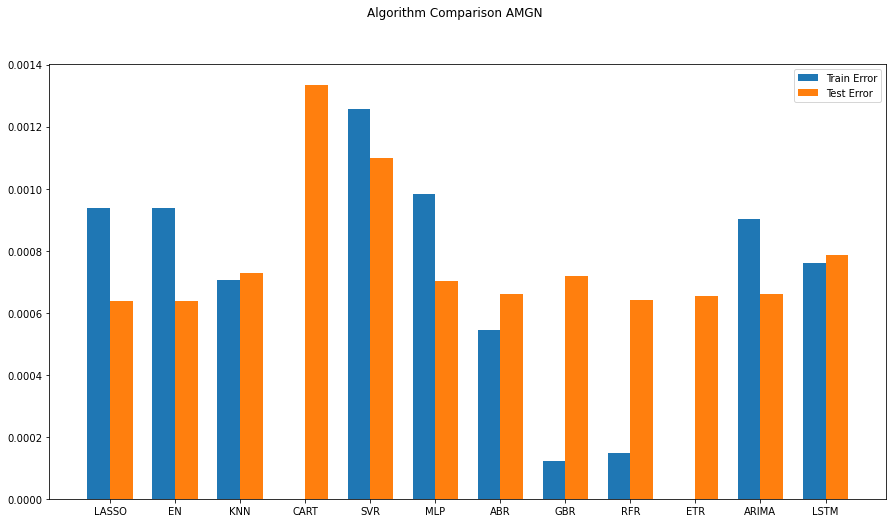

ARIMA(0, 0, 0) MSE=0.0009054
ARIMA(0, 0, 1) MSE=0.0008953
ARIMA(1, 0, 0) MSE=0.0008958
ARIMA(1, 0, 1) MSE=0.0008949
ARIMA(2, 0, 0) MSE=0.0008950
ARIMA(2, 0, 1) MSE=0.0008945
Best ARIMA(2, 0, 1) MSE=0.0008945
0.0006591214914147195


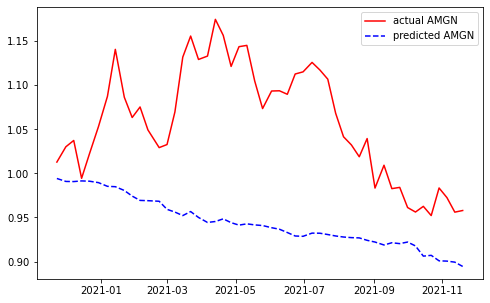

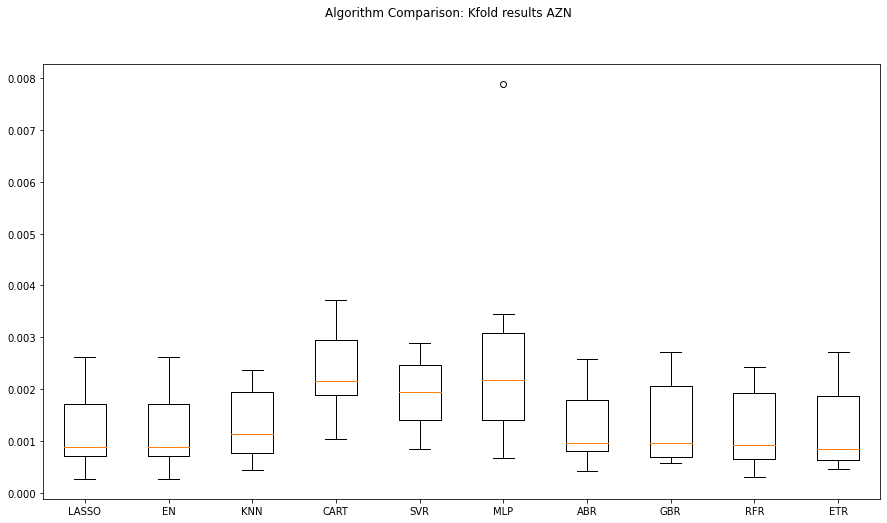

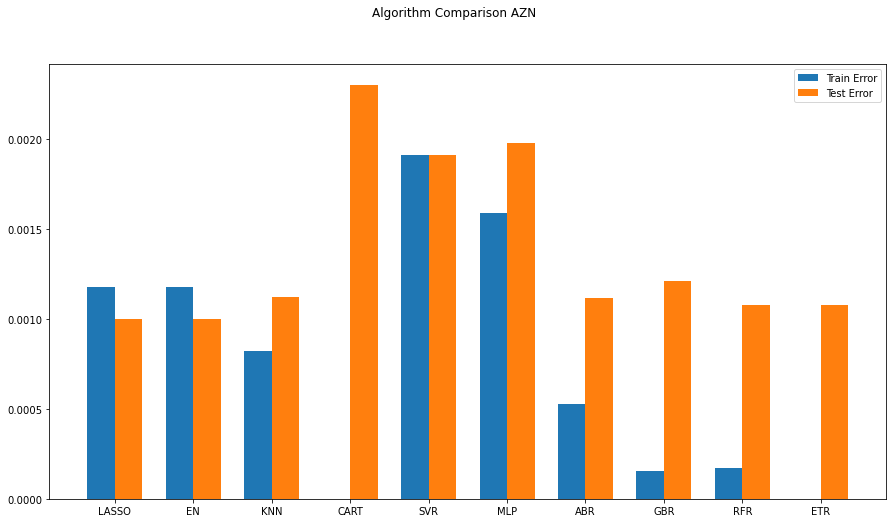

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0009405686081116275
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

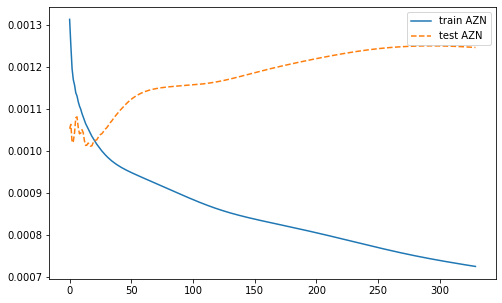

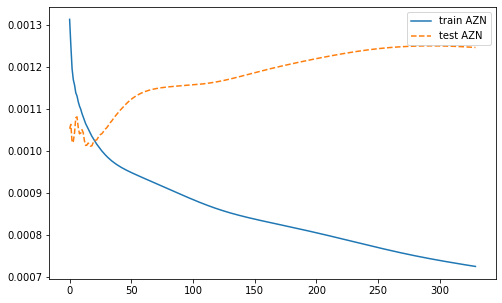

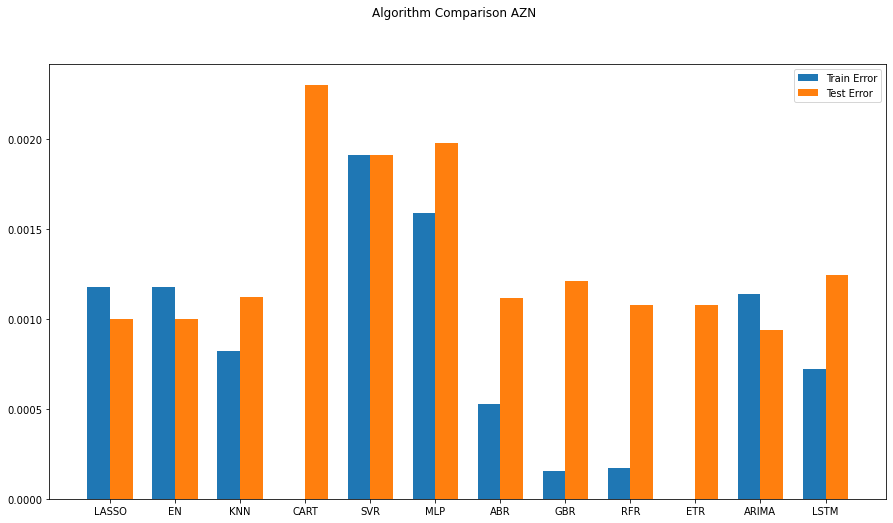

ARIMA(0, 0, 0) MSE=0.0011374
ARIMA(0, 0, 1) MSE=0.0011086
ARIMA(1, 0, 0) MSE=0.0011067
ARIMA(1, 0, 1) MSE=0.0011066
ARIMA(2, 0, 0) MSE=0.0011066
ARIMA(2, 0, 1) MSE=0.0011056
Best ARIMA(2, 0, 1) MSE=0.0011056
0.0009405686081116275


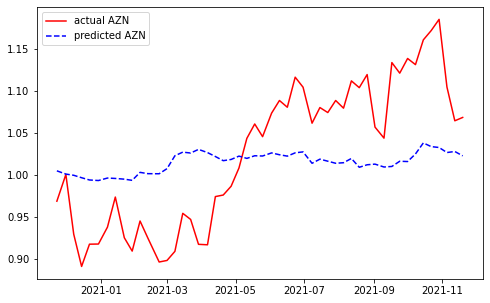

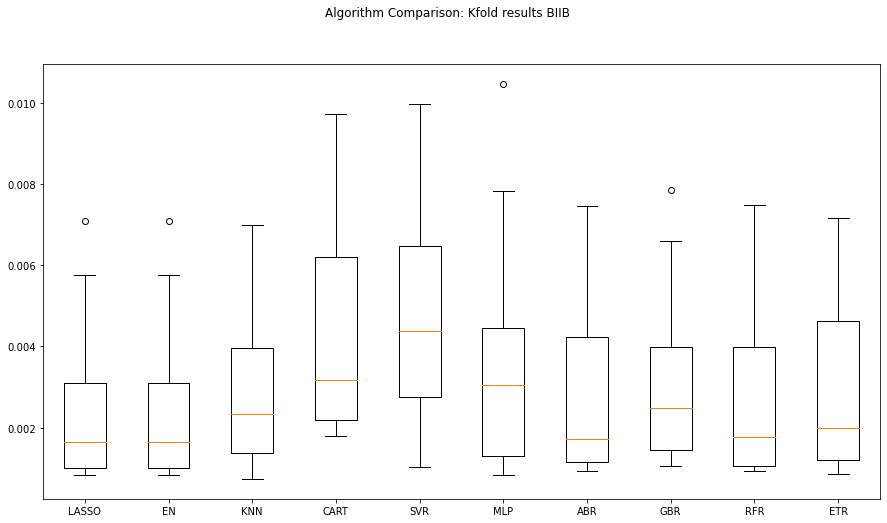

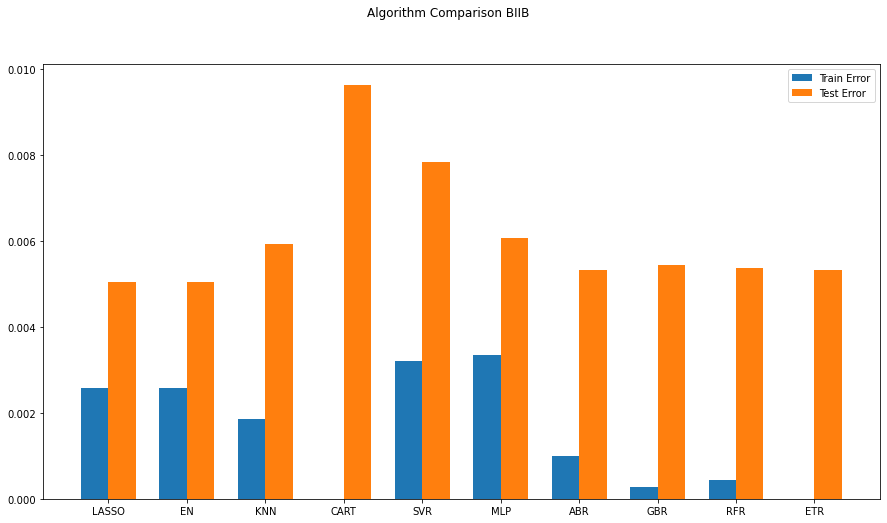

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.005021079840925877
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0

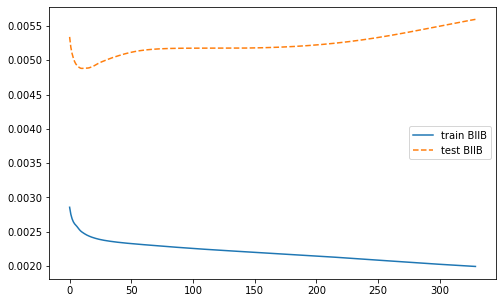

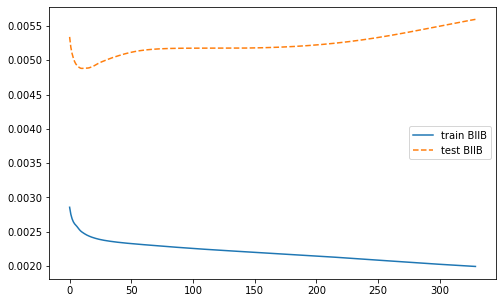

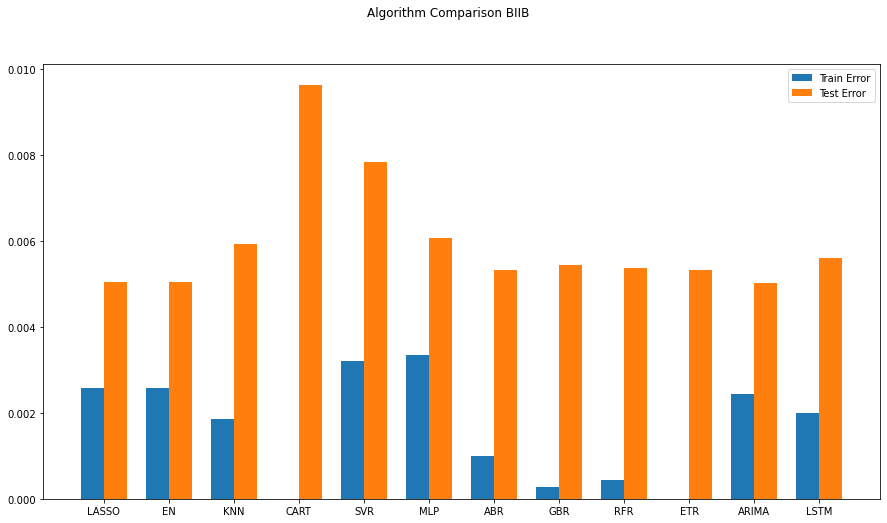

ARIMA(0, 0, 0) MSE=0.0024538
ARIMA(0, 0, 1) MSE=0.0024206
ARIMA(1, 0, 0) MSE=0.0024246
ARIMA(1, 0, 1) MSE=0.0024055
ARIMA(2, 0, 0) MSE=0.0024180
ARIMA(2, 0, 1) MSE=0.0024045
Best ARIMA(2, 0, 1) MSE=0.0024045
0.005021079840925877


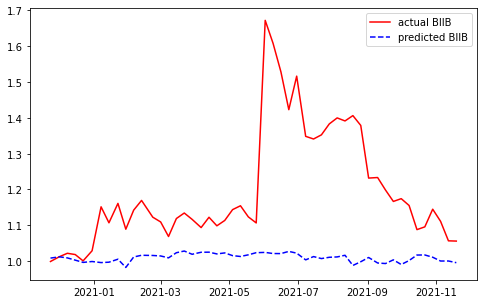

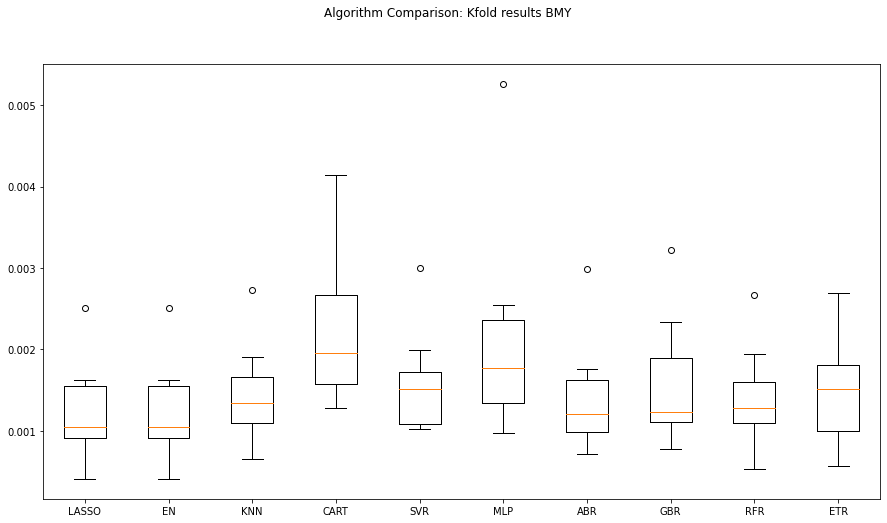

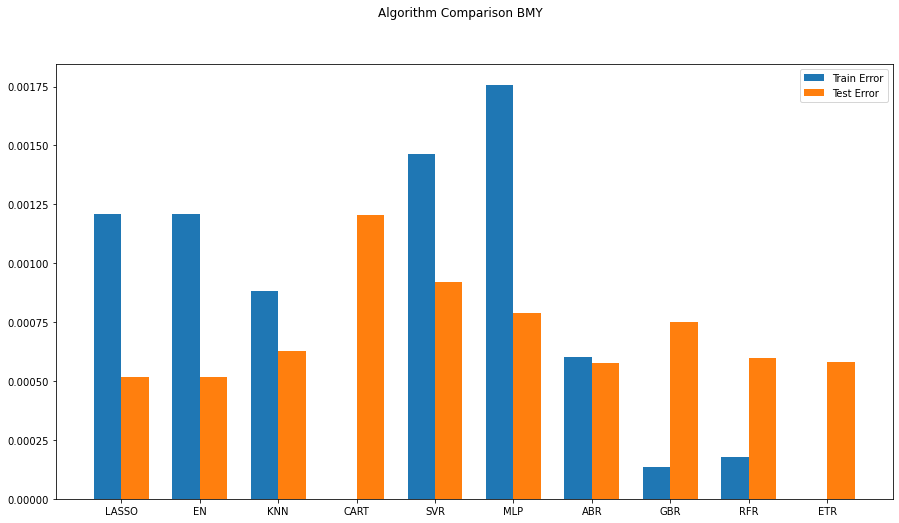

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0004992600524996176
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

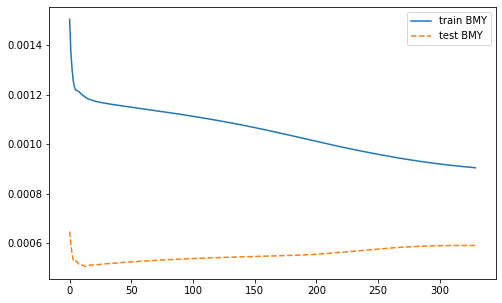

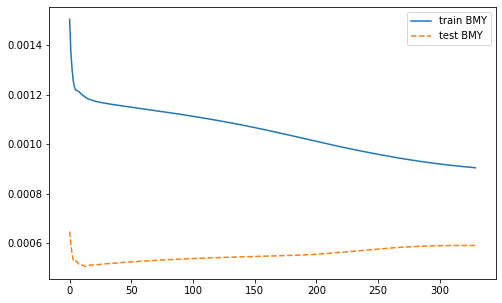

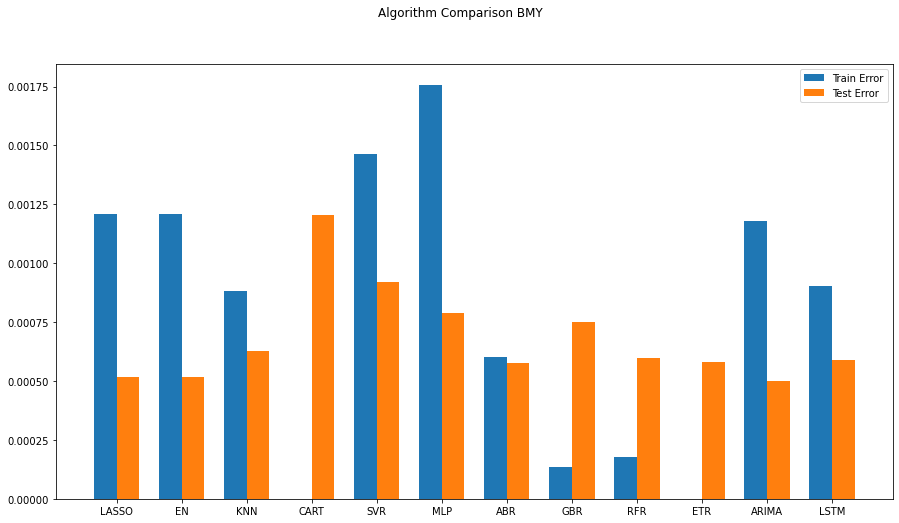

ARIMA(0, 0, 0) MSE=0.0011841
ARIMA(0, 0, 1) MSE=0.0011765
ARIMA(1, 0, 0) MSE=0.0011773
ARIMA(1, 0, 1) MSE=0.0011740
ARIMA(2, 0, 0) MSE=0.0011753
ARIMA(2, 0, 1) MSE=0.0011550
Best ARIMA(2, 0, 1) MSE=0.0011550
0.0004992600524996176


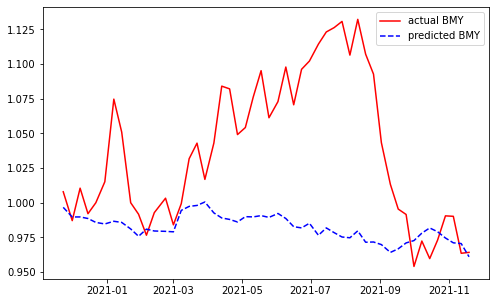

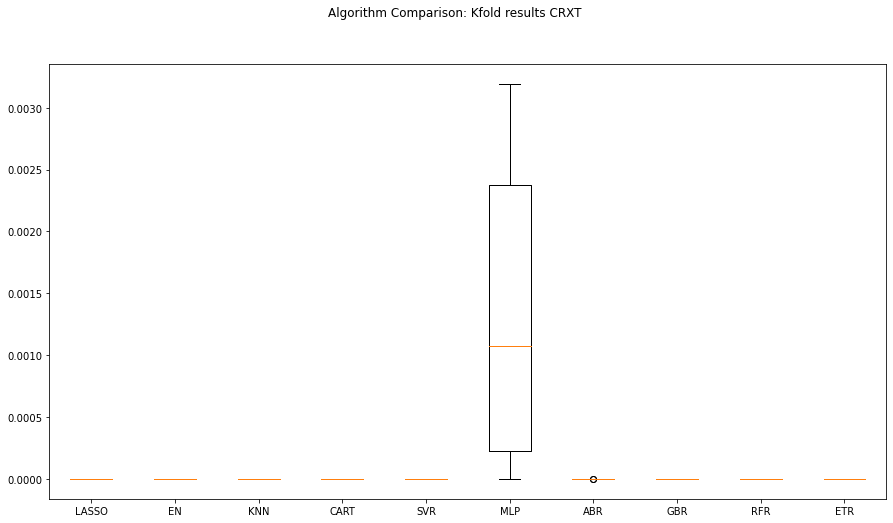

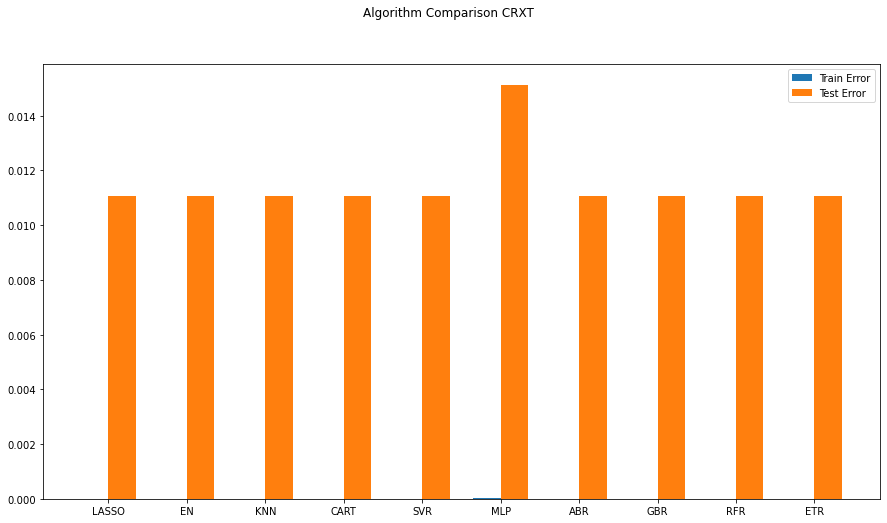

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.01106056350100071
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0.

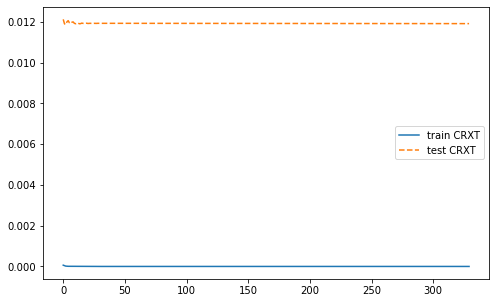

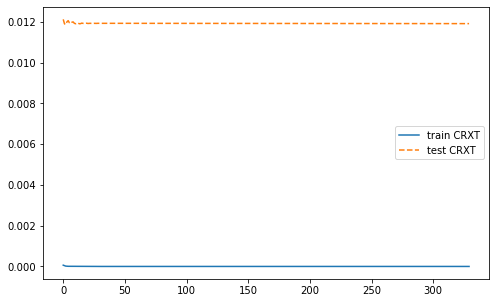

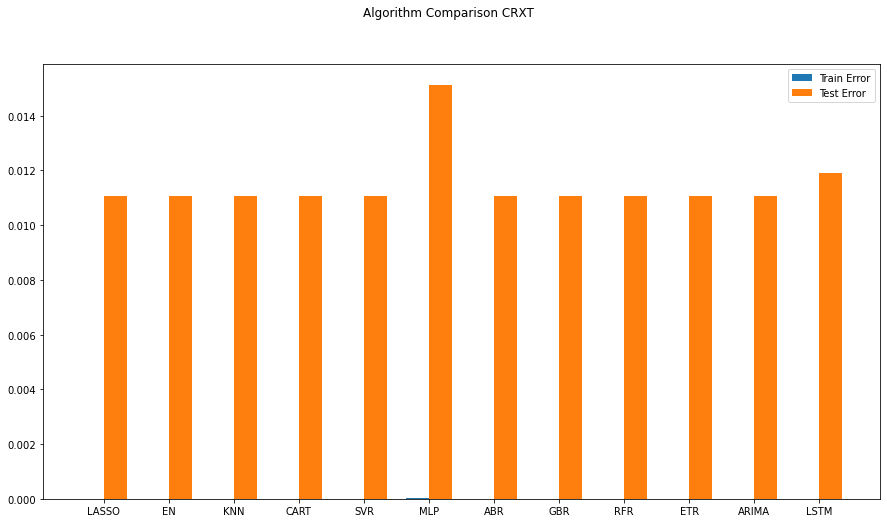

ARIMA(0, 0, 0) MSE=0.0000000
ARIMA(0, 0, 1) MSE=0.0000000
ARIMA(1, 0, 0) MSE=0.0000000
ARIMA(2, 0, 0) MSE=0.0000000
Best ARIMA(0, 0, 0) MSE=0.0000000
0.01106056350100071


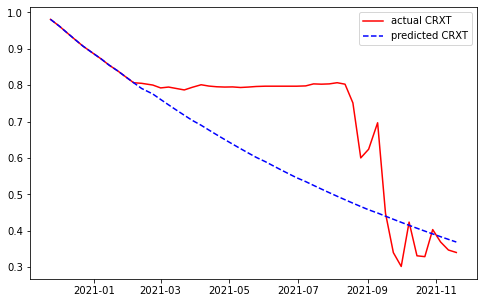

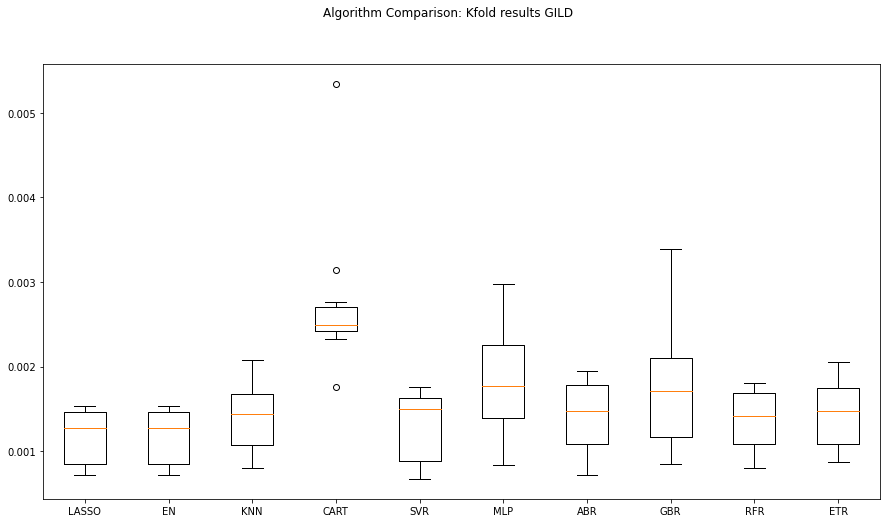

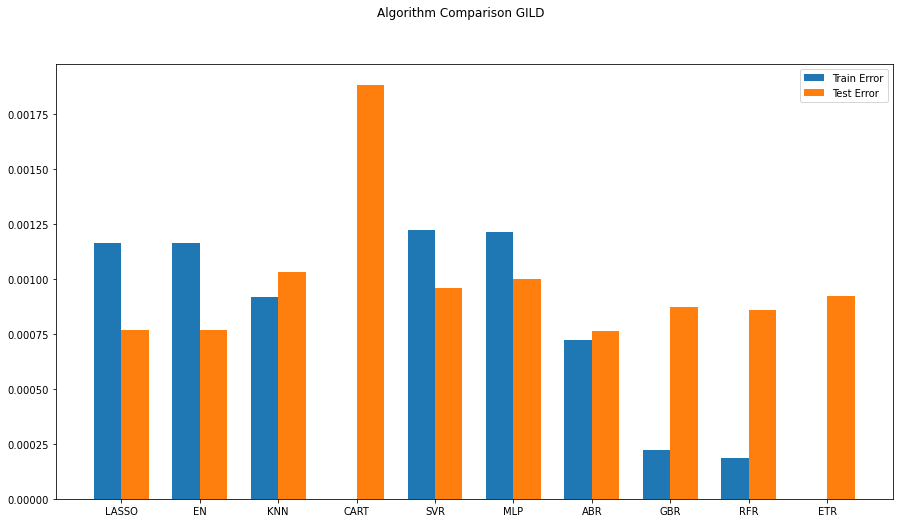

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0007723184617560445
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

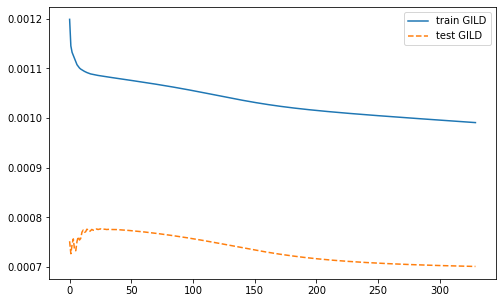

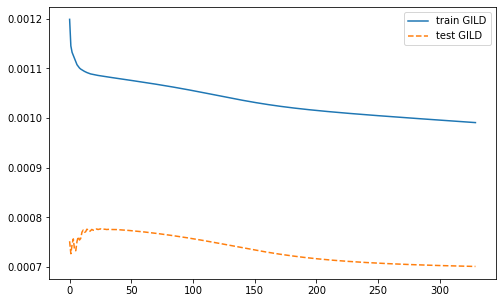

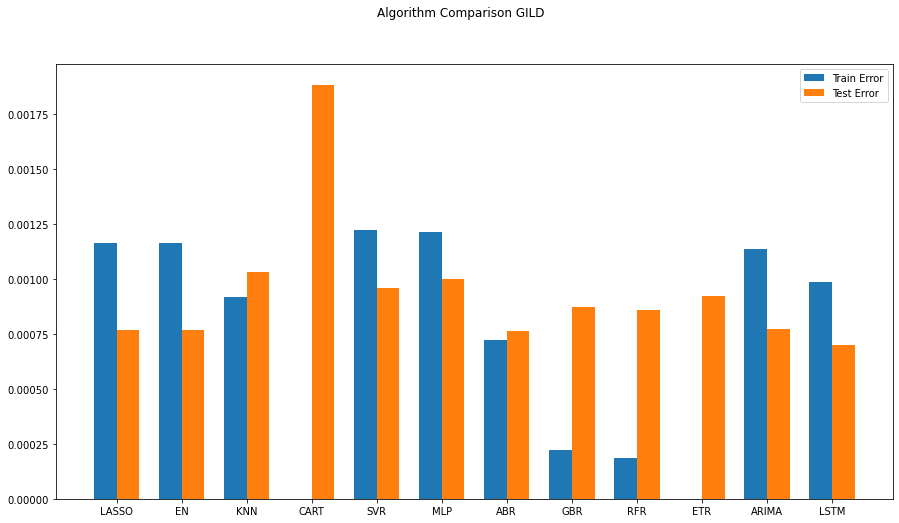

ARIMA(0, 0, 0) MSE=0.0011550
ARIMA(0, 0, 1) MSE=0.0011315
ARIMA(1, 0, 0) MSE=0.0011343
ARIMA(1, 0, 1) MSE=0.0011298
ARIMA(2, 0, 0) MSE=0.0011285
ARIMA(2, 0, 1) MSE=0.0011284
Best ARIMA(2, 0, 1) MSE=0.0011284
0.0007723184617560445


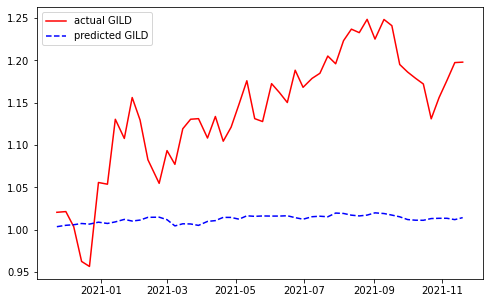

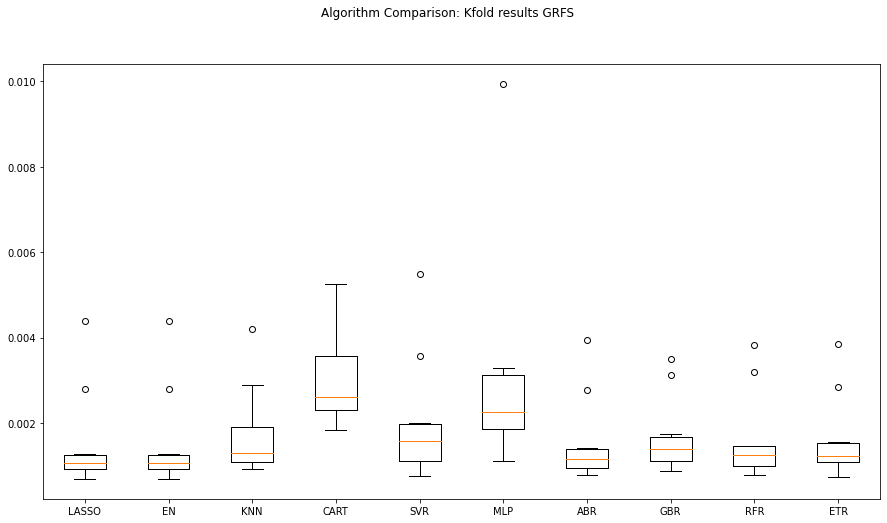

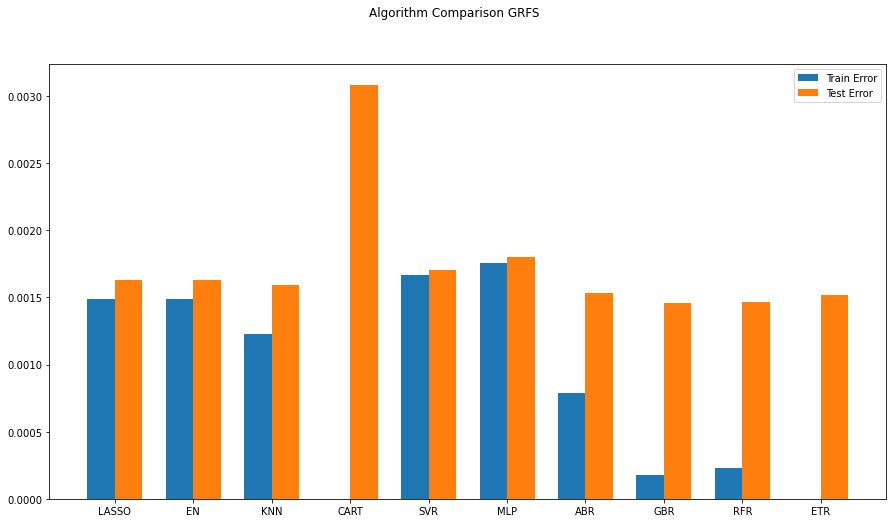

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0016457885723369446
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

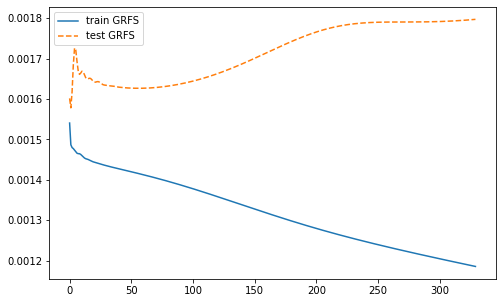

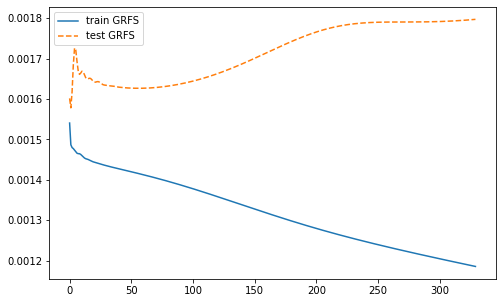

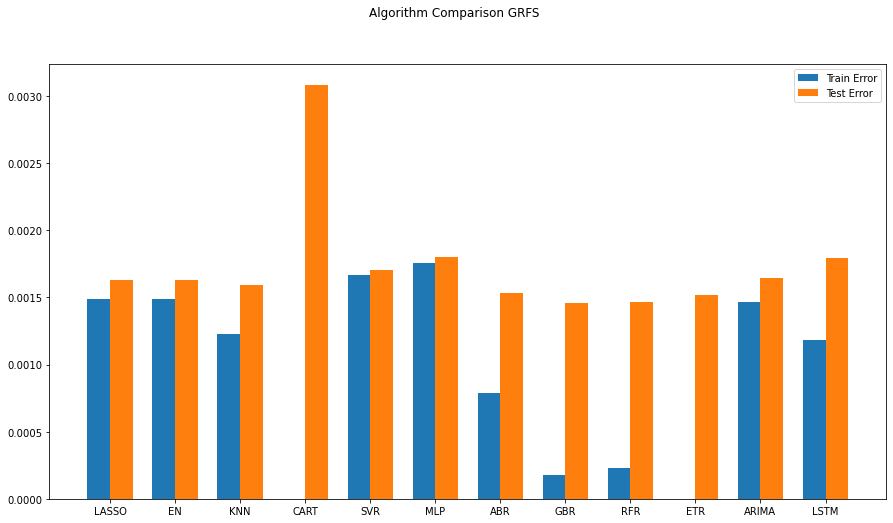

ARIMA(0, 0, 0) MSE=0.0014633
ARIMA(0, 0, 1) MSE=0.0014616
ARIMA(1, 0, 0) MSE=0.0014617
ARIMA(1, 0, 1) MSE=0.0014563
ARIMA(2, 0, 0) MSE=0.0014616
ARIMA(2, 0, 1) MSE=0.0014377
Best ARIMA(2, 0, 1) MSE=0.0014377
0.0016457885723369446


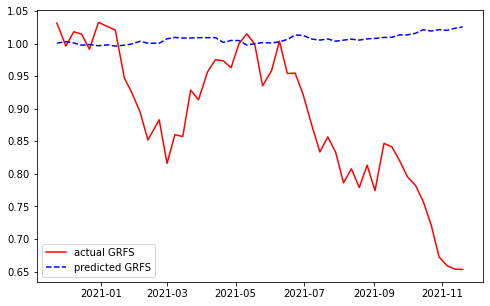

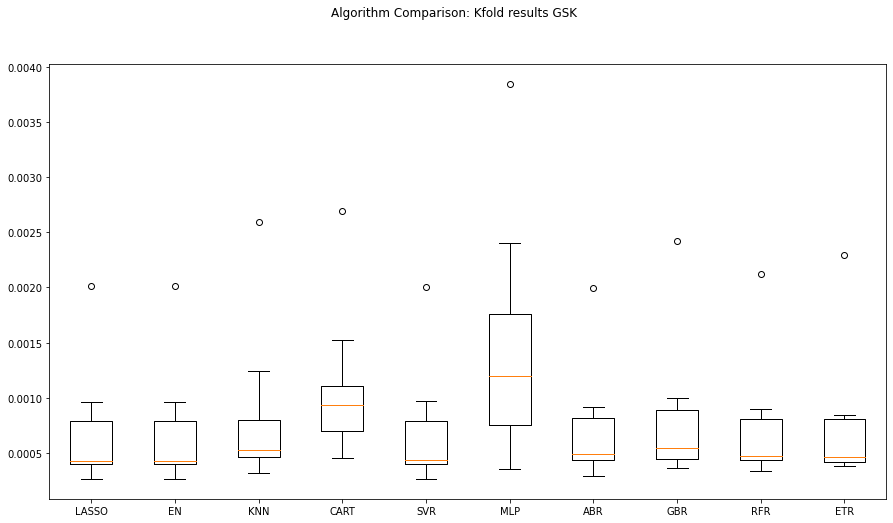

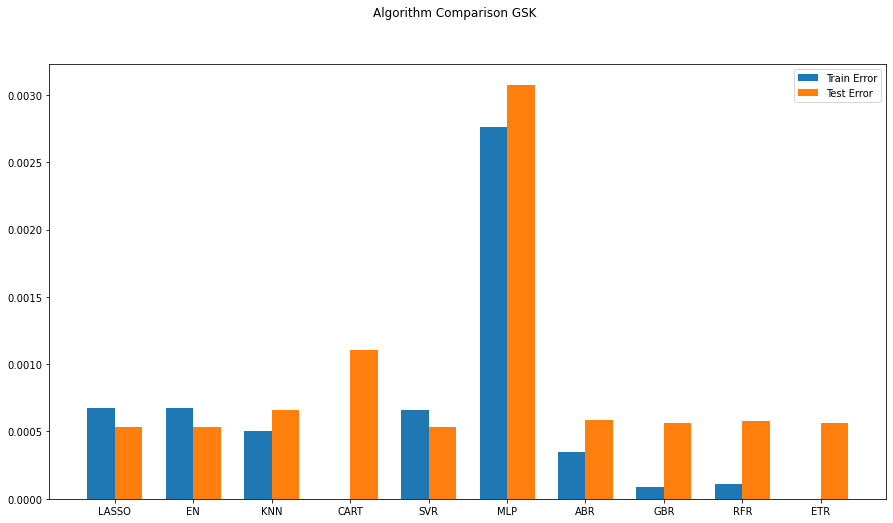

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0005478678287701846
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

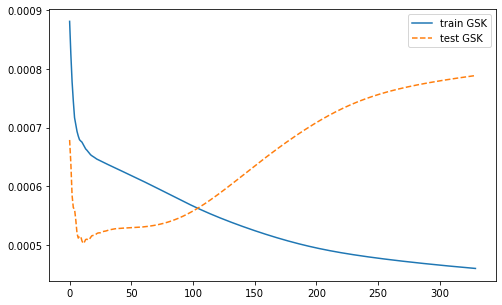

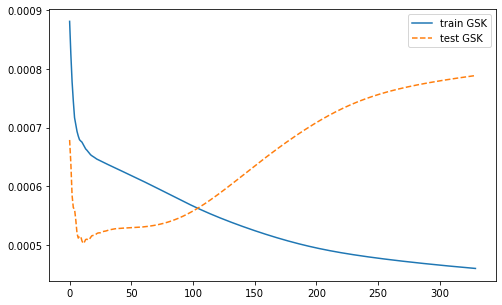

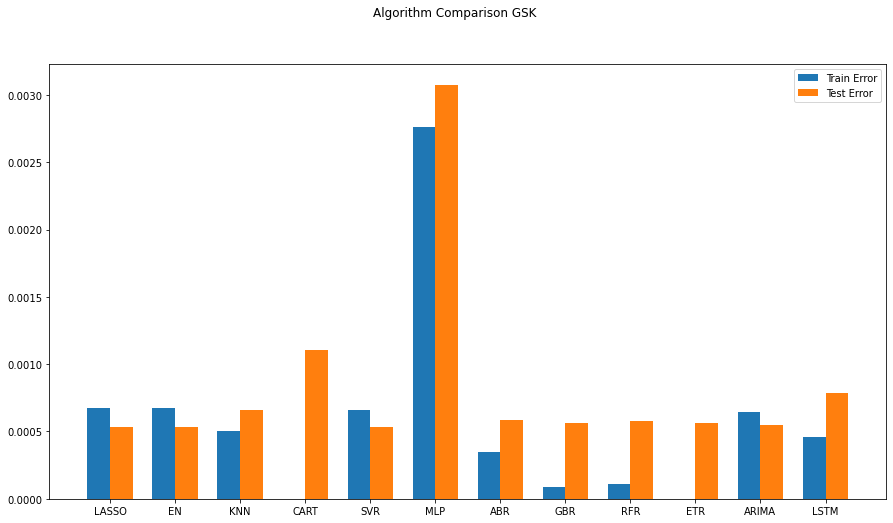

ARIMA(0, 0, 0) MSE=0.0006413
ARIMA(0, 0, 1) MSE=0.0006412
ARIMA(1, 0, 0) MSE=0.0006413
ARIMA(1, 0, 1) MSE=0.0006234
ARIMA(2, 0, 0) MSE=0.0006376
ARIMA(2, 0, 1) MSE=0.0006351
Best ARIMA(1, 0, 1) MSE=0.0006234
0.0005478678287701846


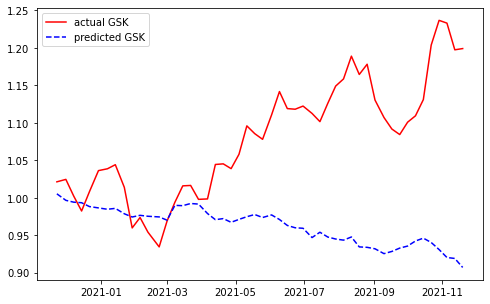

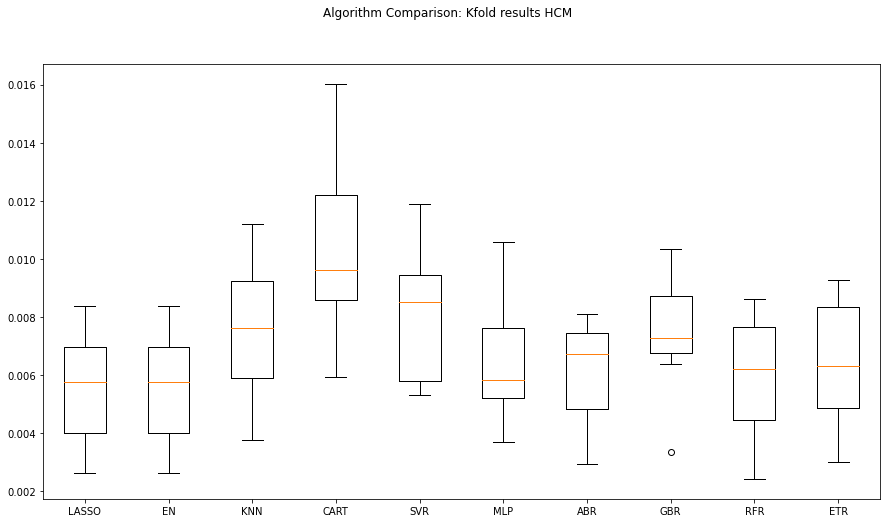

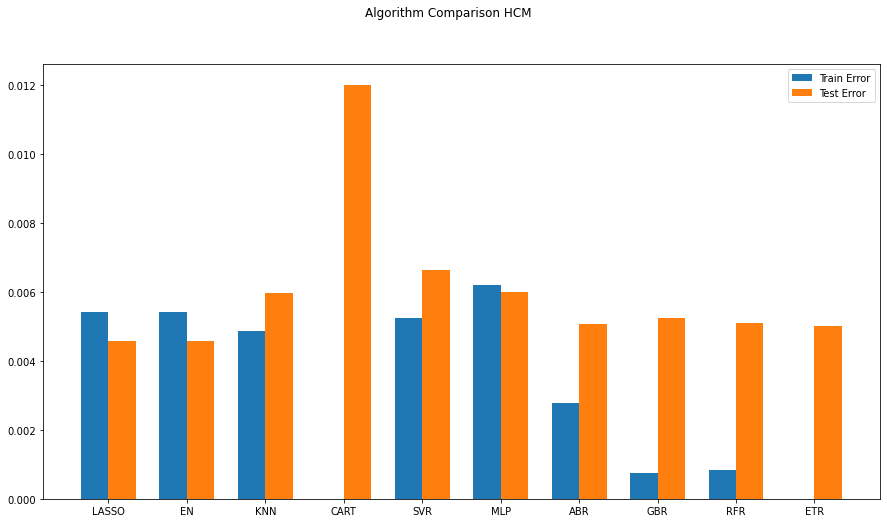

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.004633133665832553
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0

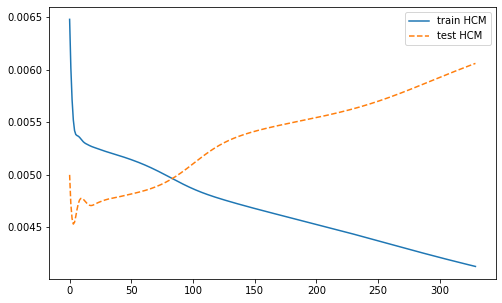

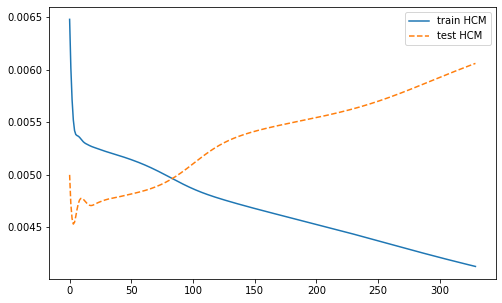

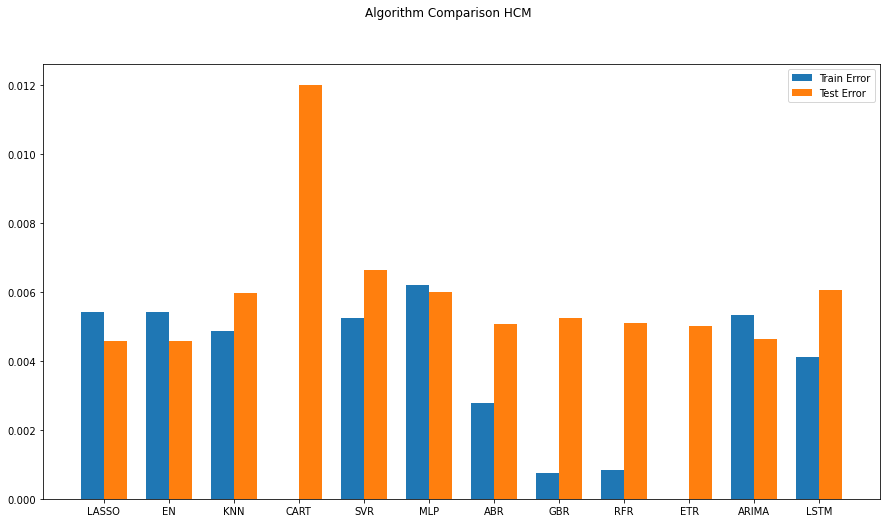

ARIMA(0, 0, 0) MSE=0.0053365
ARIMA(0, 0, 1) MSE=0.0053251
ARIMA(1, 0, 0) MSE=0.0053254
ARIMA(1, 0, 1) MSE=0.0053033
ARIMA(2, 0, 0) MSE=0.0053247
ARIMA(2, 0, 1) MSE=0.0053031
Best ARIMA(2, 0, 1) MSE=0.0053031
0.004633133665832553


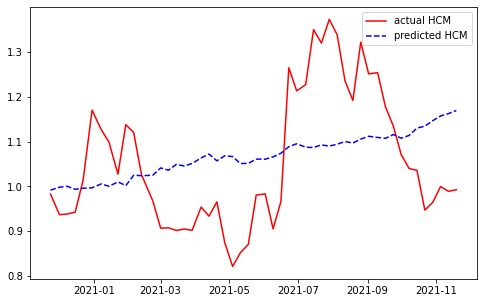

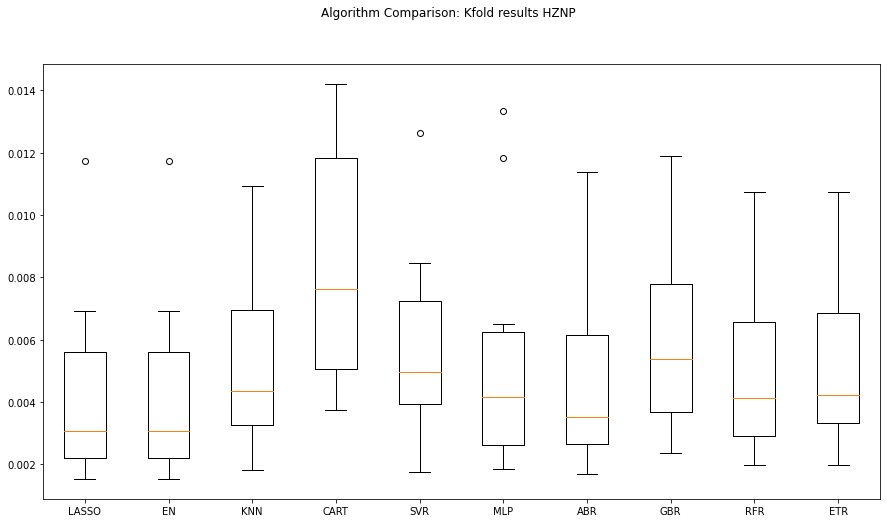

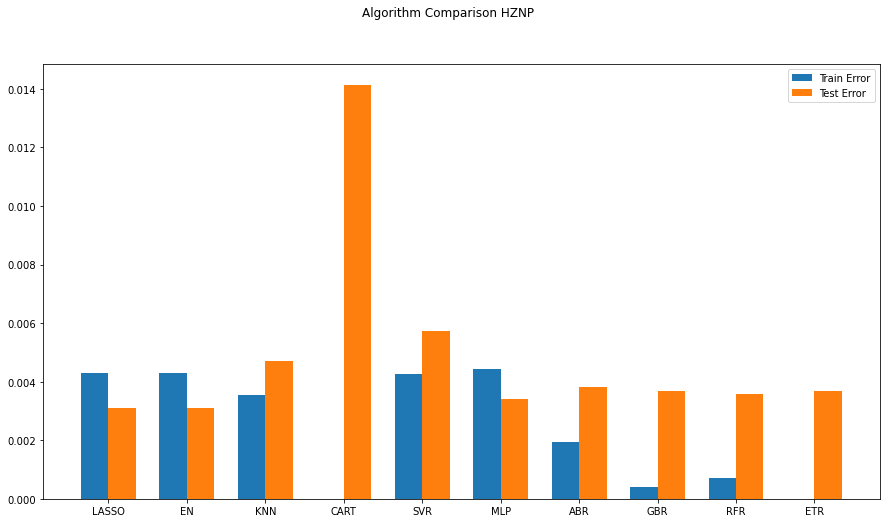

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0034704999654358586
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

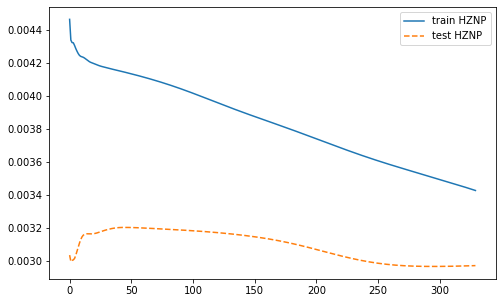

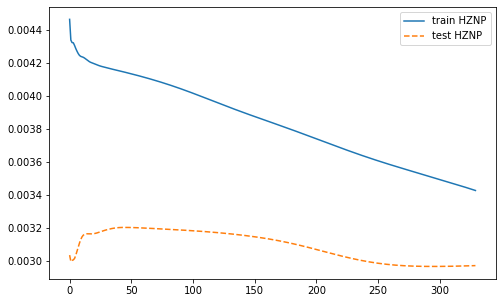

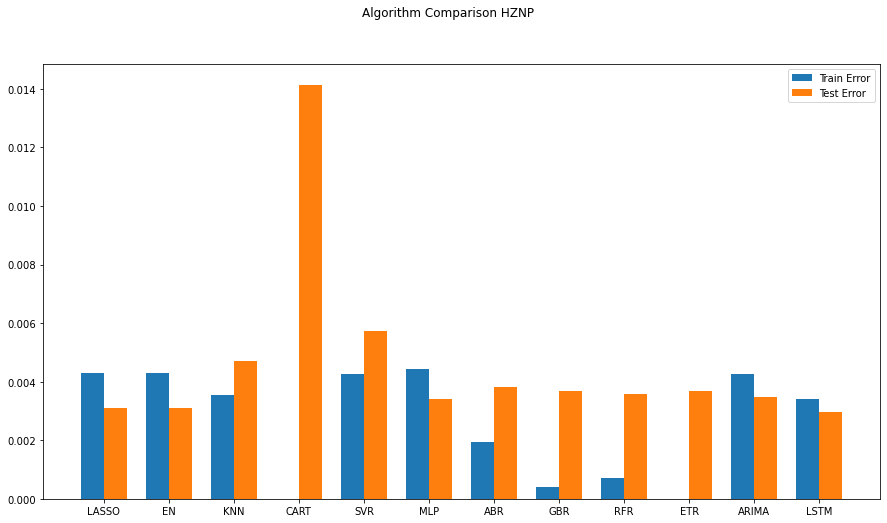

ARIMA(0, 0, 0) MSE=0.0042429
ARIMA(0, 0, 1) MSE=0.0042380
ARIMA(1, 0, 0) MSE=0.0042387
ARIMA(1, 0, 1) MSE=0.0042343
ARIMA(2, 0, 0) MSE=0.0042229
ARIMA(2, 0, 1) MSE=0.0042156
Best ARIMA(2, 0, 1) MSE=0.0042156
0.0034704999654358586


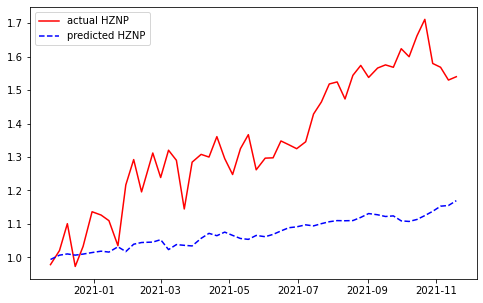

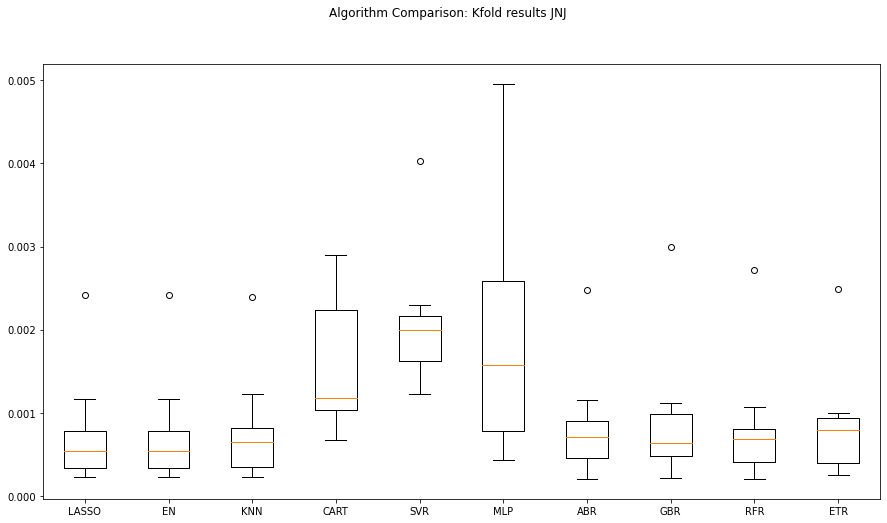

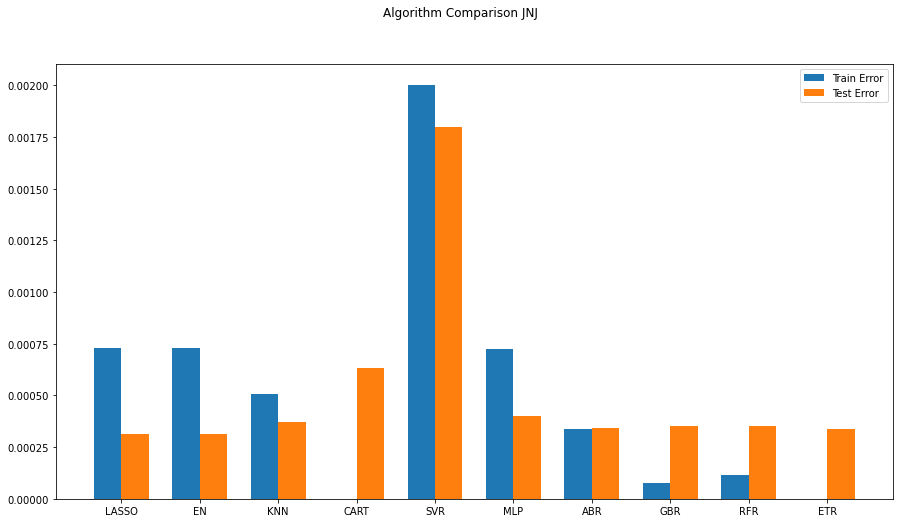

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0003161023869874276
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

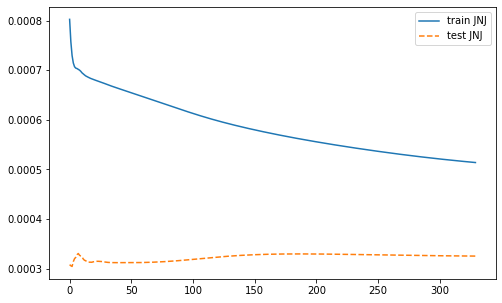

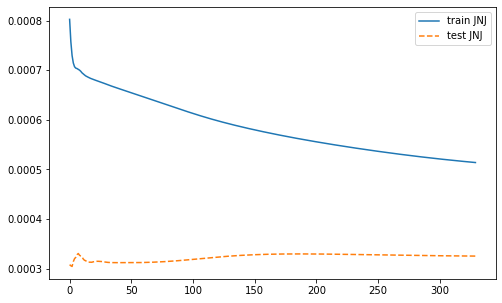

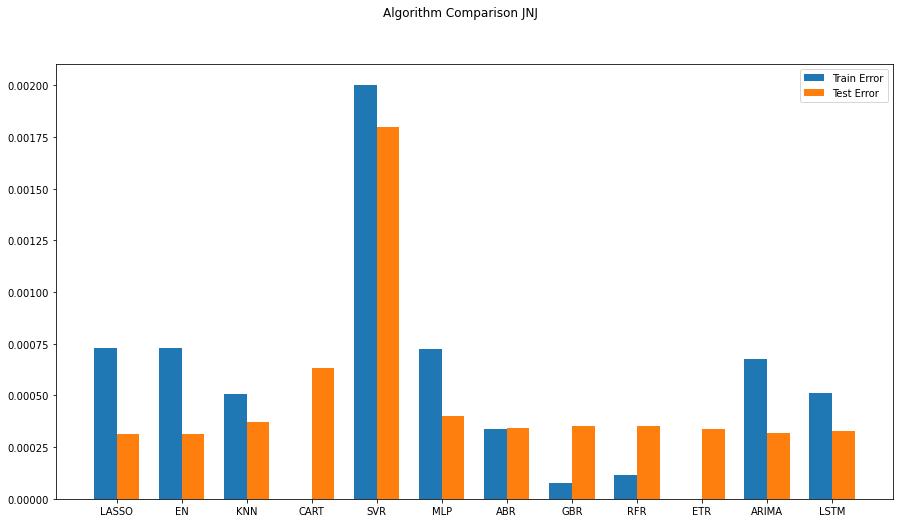

ARIMA(0, 0, 0) MSE=0.0006939
ARIMA(0, 0, 1) MSE=0.0006737
ARIMA(1, 0, 0) MSE=0.0006737
ARIMA(1, 0, 1) MSE=0.0006735
ARIMA(2, 0, 0) MSE=0.0006734
ARIMA(2, 0, 1) MSE=0.0006715
Best ARIMA(2, 0, 1) MSE=0.0006715
0.0003161023869874276


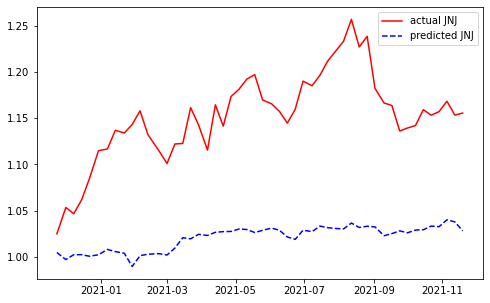

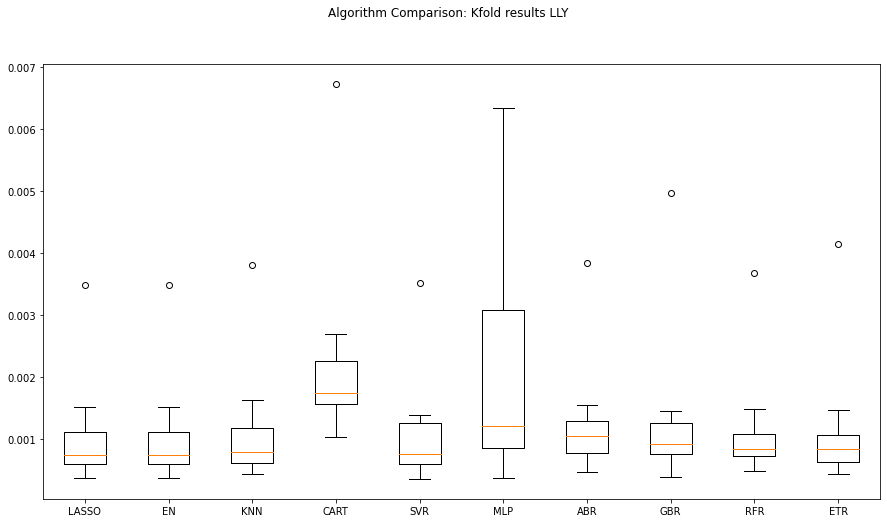

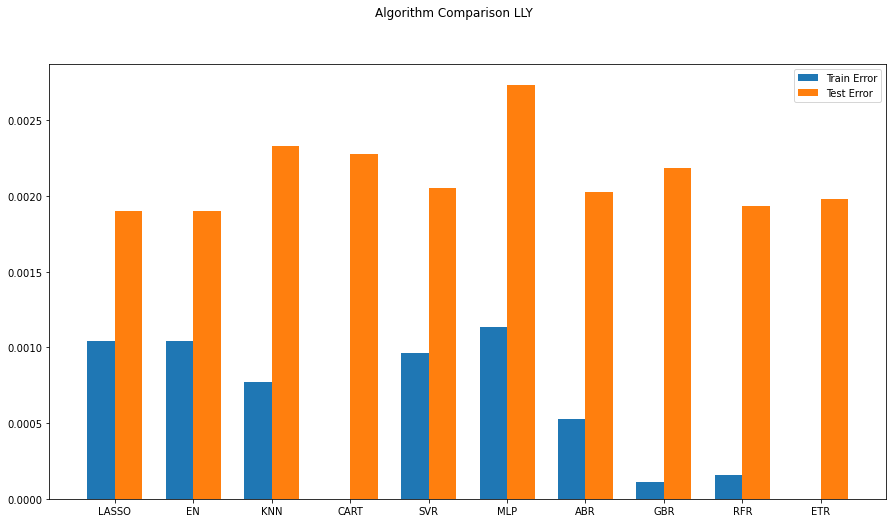

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0020409622565999916
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

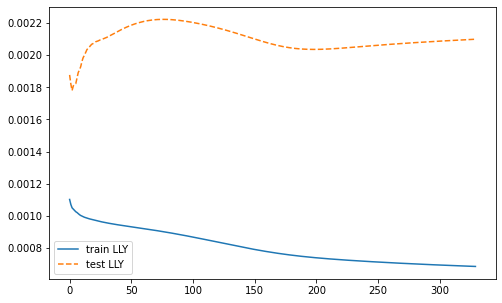

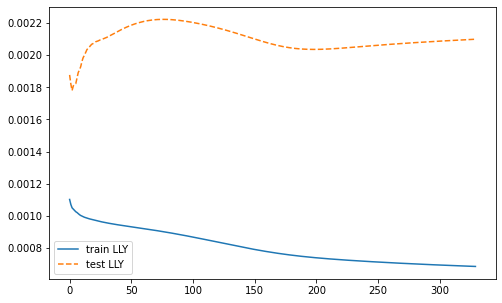

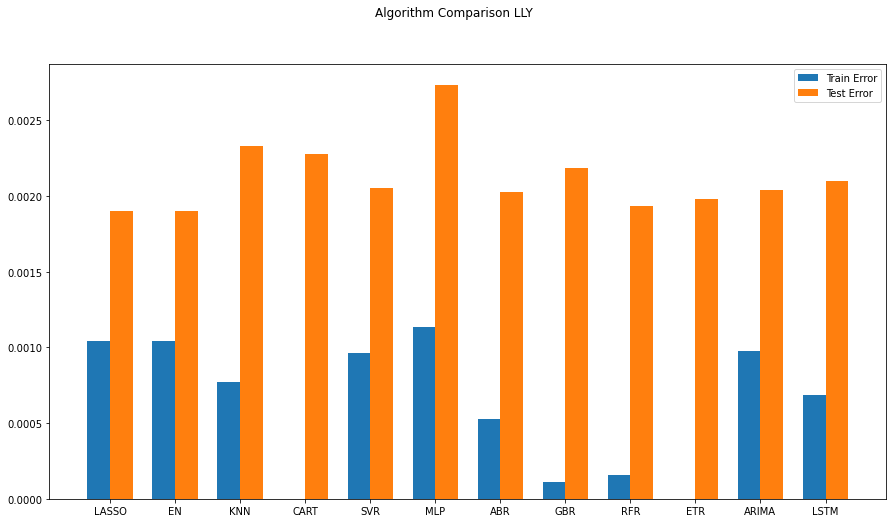

ARIMA(0, 0, 0) MSE=0.0009732
ARIMA(0, 0, 1) MSE=0.0009479
ARIMA(1, 0, 0) MSE=0.0009464
ARIMA(1, 0, 1) MSE=0.0009464
ARIMA(2, 0, 0) MSE=0.0009464
ARIMA(2, 0, 1) MSE=0.0009288
Best ARIMA(2, 0, 1) MSE=0.0009288
0.0020409622565999916


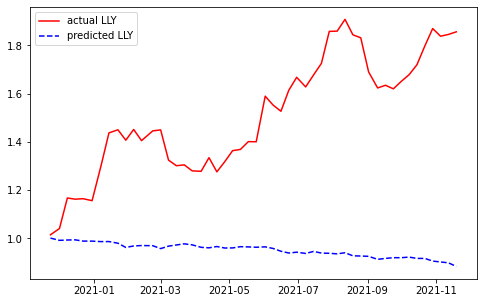

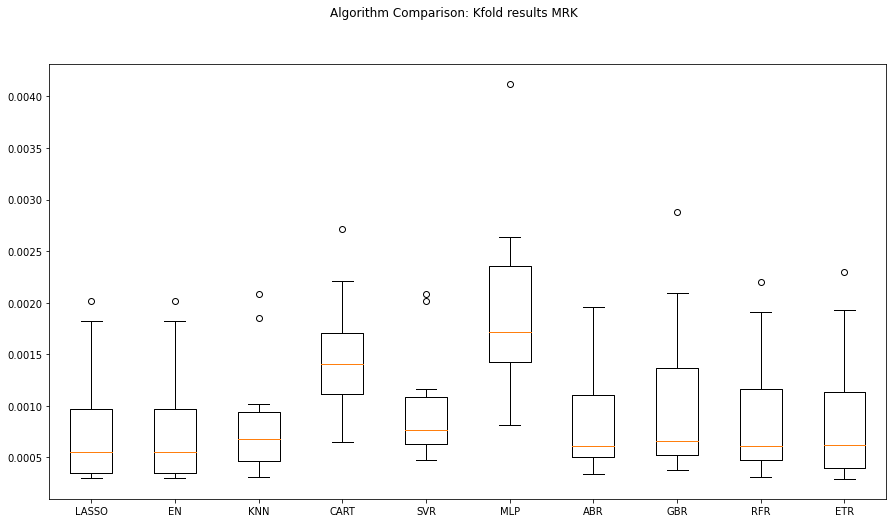

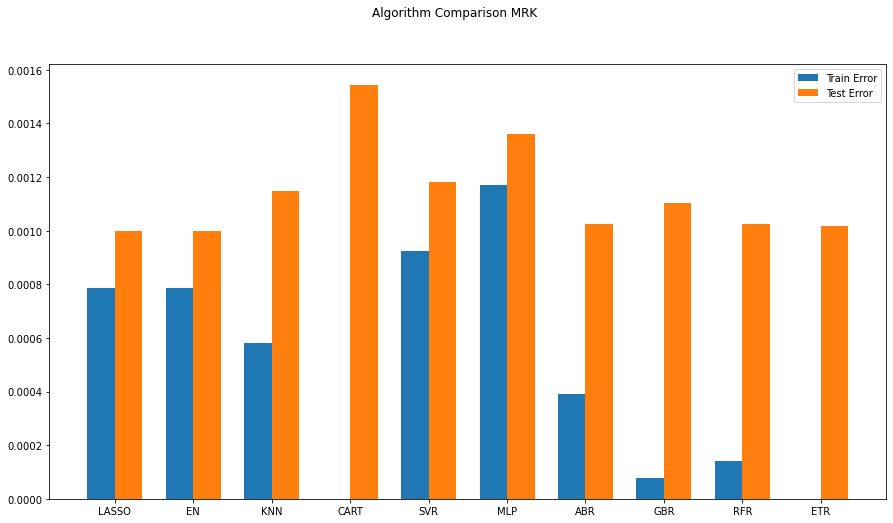

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0009529309847470837
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

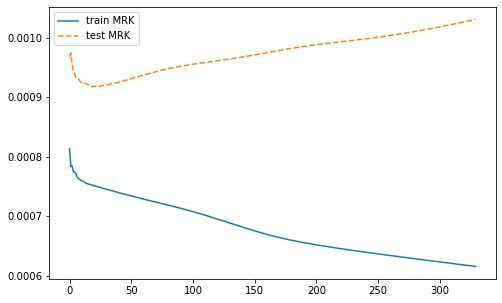

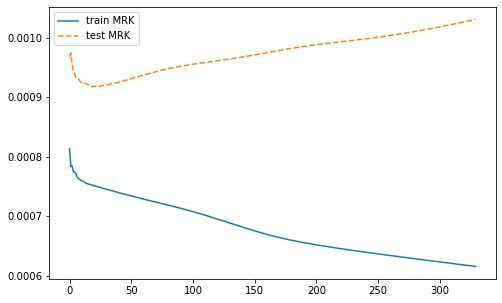

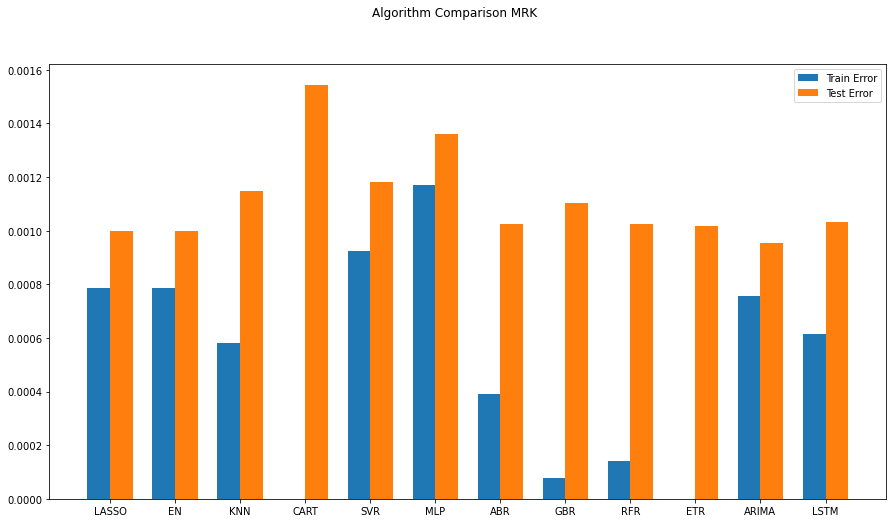

ARIMA(0, 0, 0) MSE=0.0007603
ARIMA(0, 0, 1) MSE=0.0007480
ARIMA(1, 0, 0) MSE=0.0007480
ARIMA(1, 0, 1) MSE=0.0007479
ARIMA(2, 0, 0) MSE=0.0007480
ARIMA(2, 0, 1) MSE=0.0007443
Best ARIMA(2, 0, 1) MSE=0.0007443
0.0009529309847470837


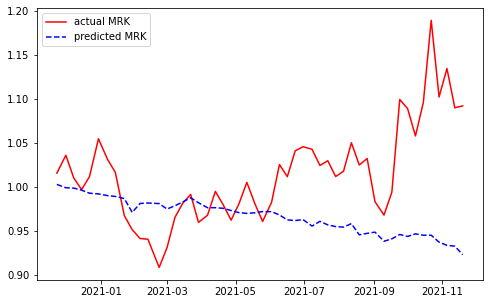

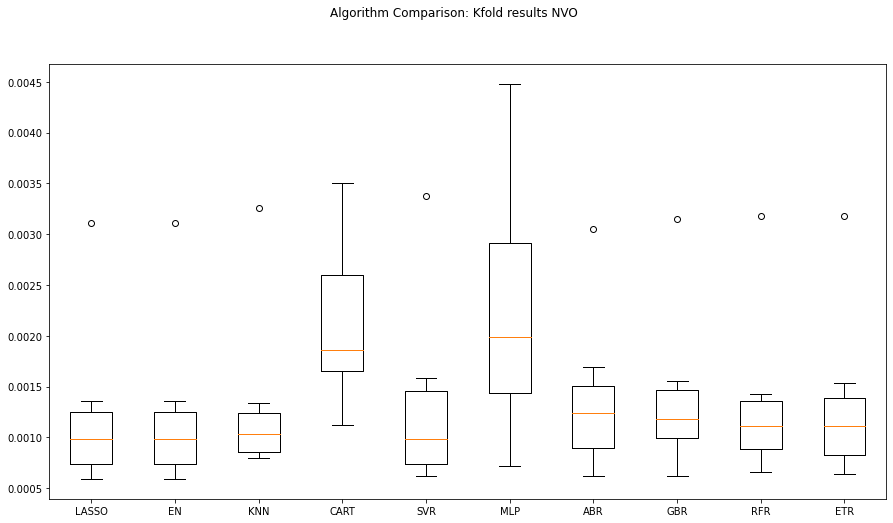

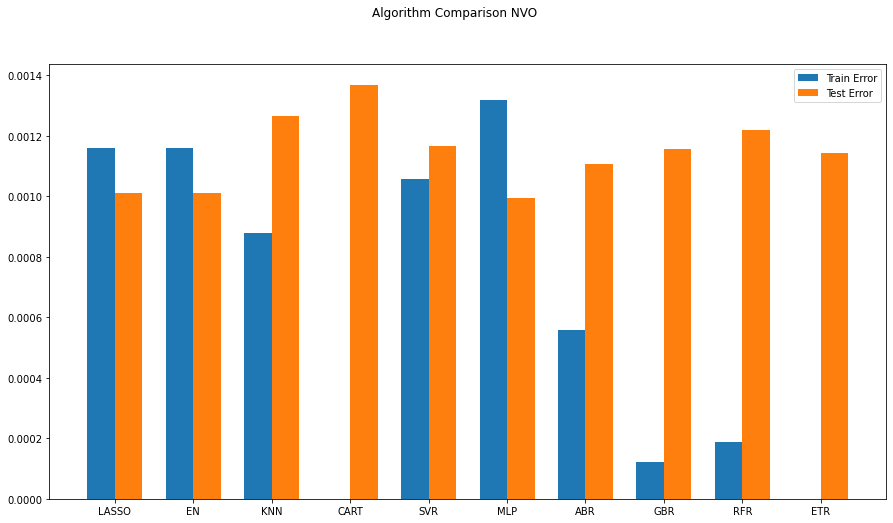

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0010961357544875673
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

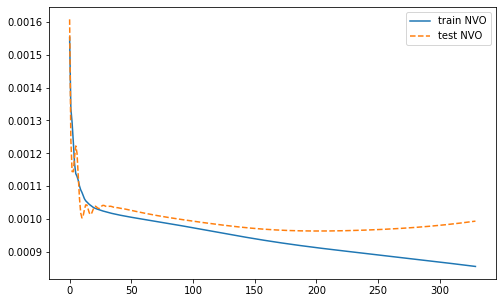

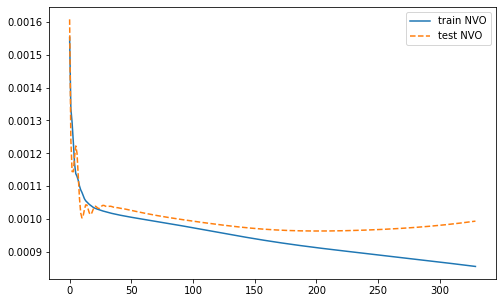

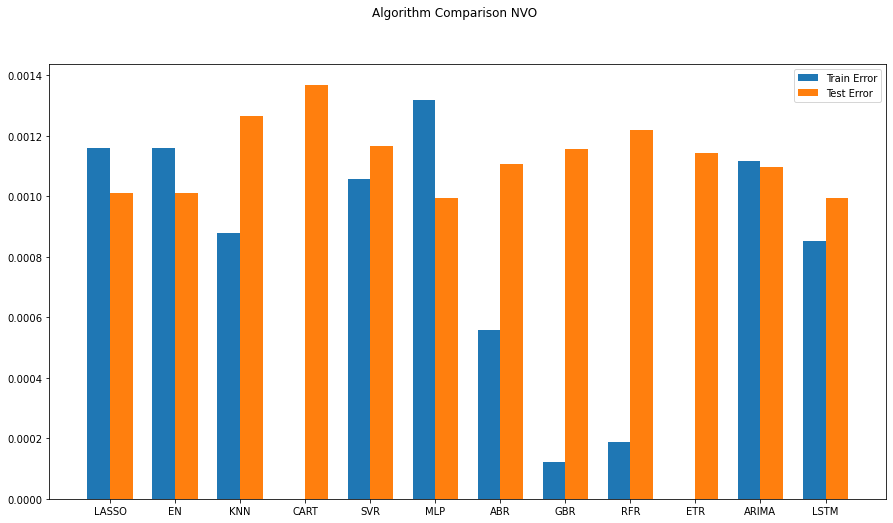

ARIMA(0, 0, 0) MSE=0.0010959
ARIMA(0, 0, 1) MSE=0.0010848
ARIMA(1, 0, 0) MSE=0.0010888
ARIMA(1, 0, 1) MSE=0.0010706
ARIMA(2, 0, 0) MSE=0.0010532
ARIMA(2, 0, 1) MSE=0.0010425
Best ARIMA(2, 0, 1) MSE=0.0010425
0.0010961357544875673


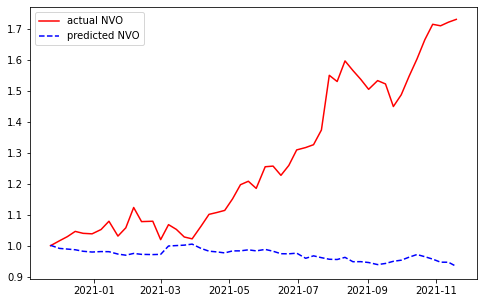

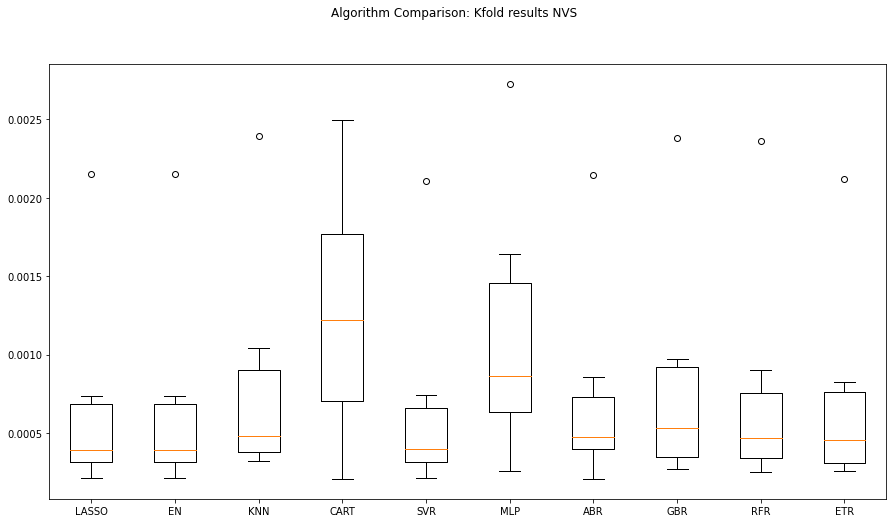

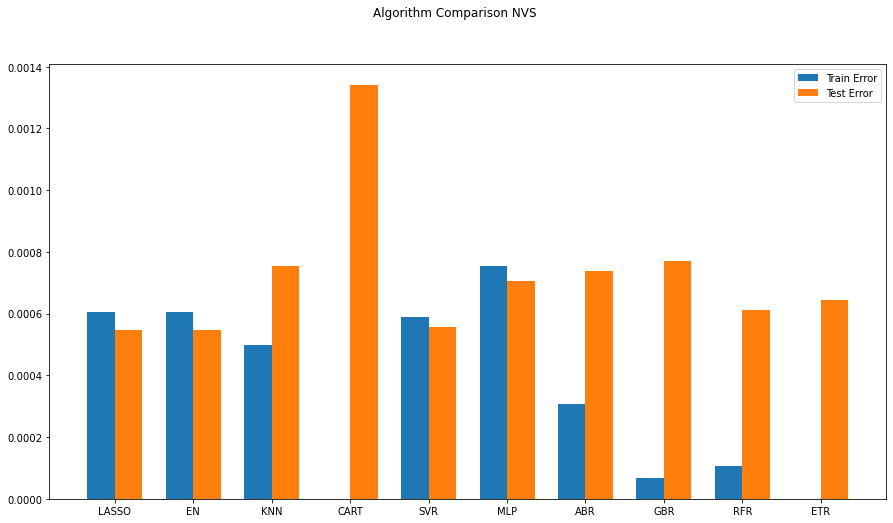

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0005069022380867164
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

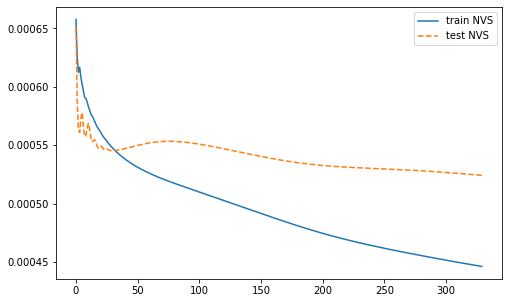

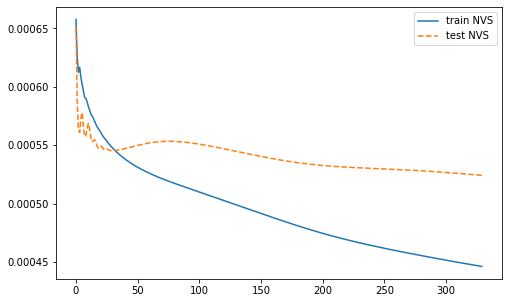

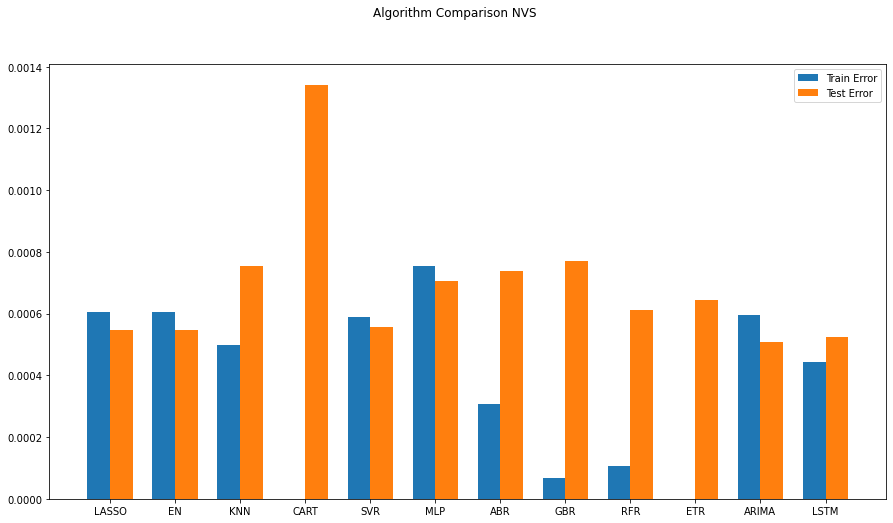

ARIMA(0, 0, 0) MSE=0.0005900
ARIMA(0, 0, 1) MSE=0.0005883
ARIMA(1, 0, 0) MSE=0.0005892
ARIMA(1, 0, 1) MSE=0.0005667
ARIMA(2, 0, 0) MSE=0.0005624
ARIMA(2, 0, 1) MSE=0.0005545
Best ARIMA(2, 0, 1) MSE=0.0005545
0.0005069022380867164


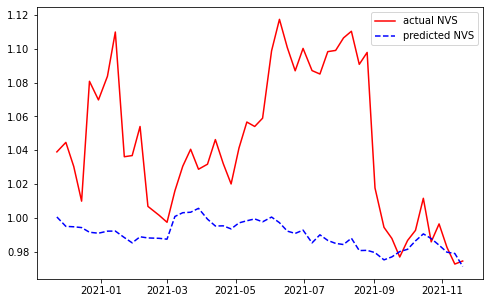

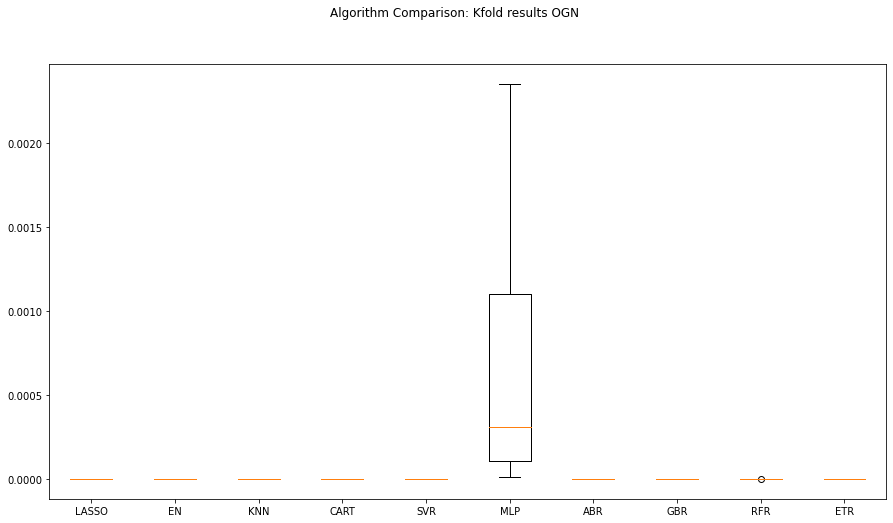

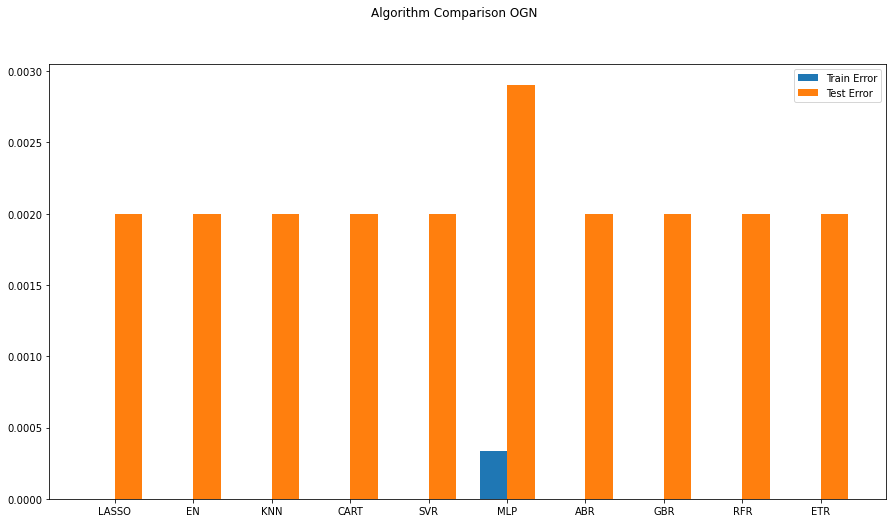

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.002000537589143446
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0

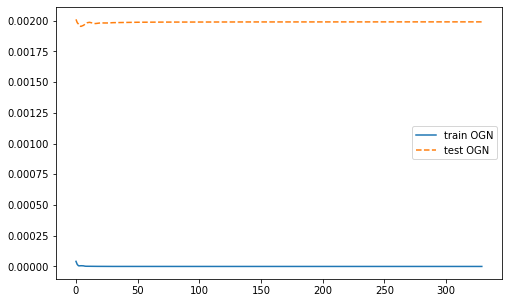

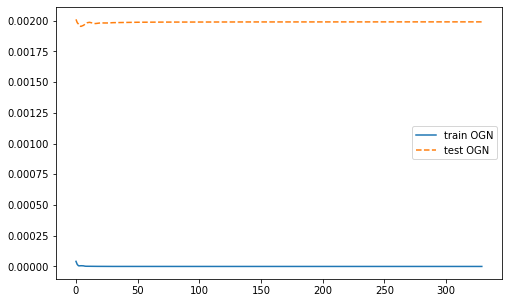

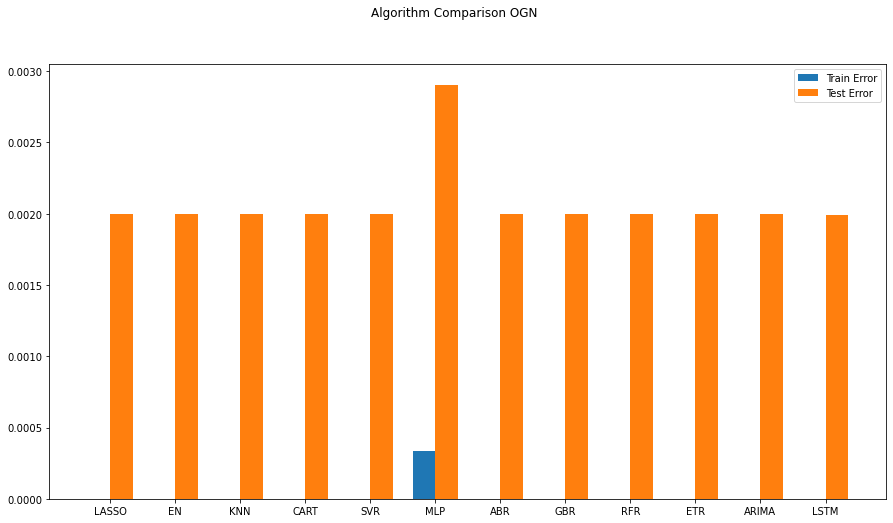

ARIMA(0, 0, 0) MSE=0.0000000
ARIMA(0, 0, 1) MSE=0.0000000
ARIMA(1, 0, 0) MSE=0.0000000
ARIMA(1, 0, 1) MSE=0.0000000
ARIMA(2, 0, 0) MSE=0.0000000
Best ARIMA(1, 0, 1) MSE=0.0000000
0.002000537589143446


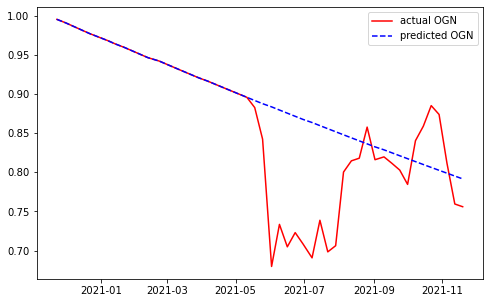

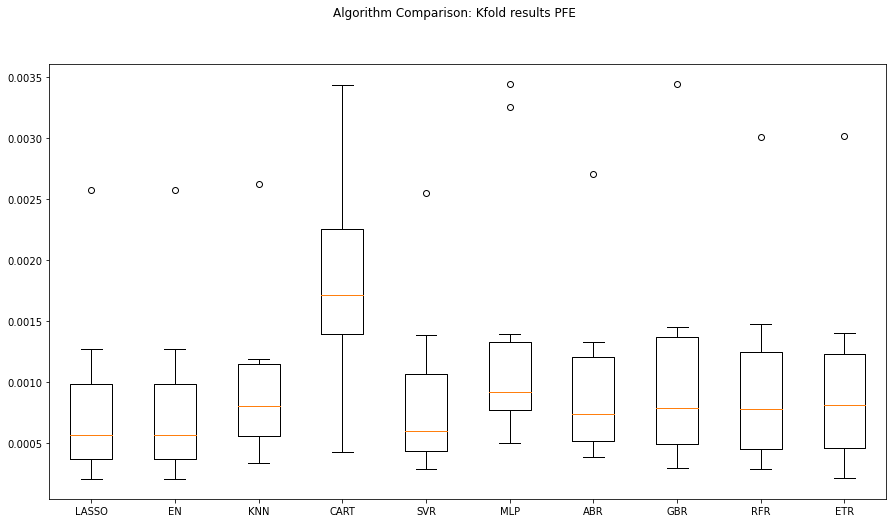

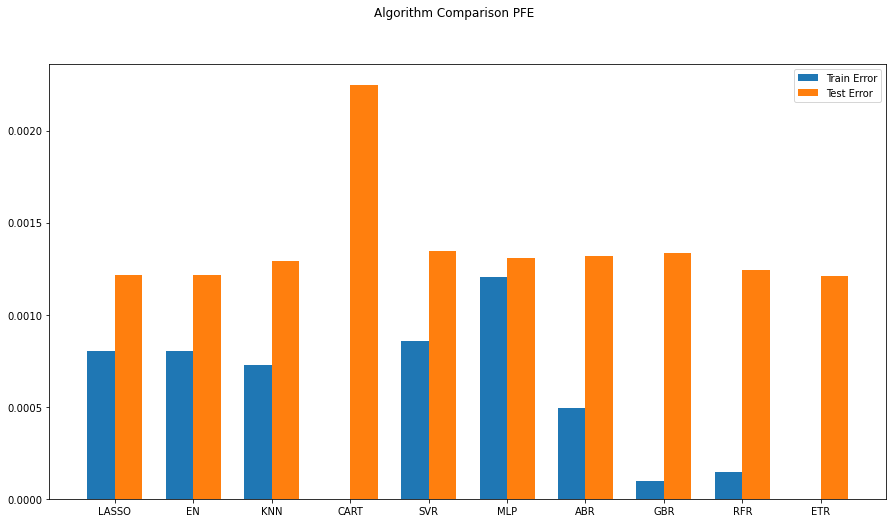

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0013315114618038858
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

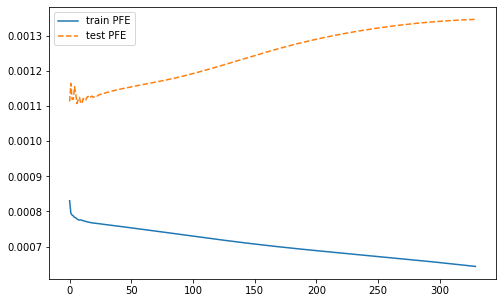

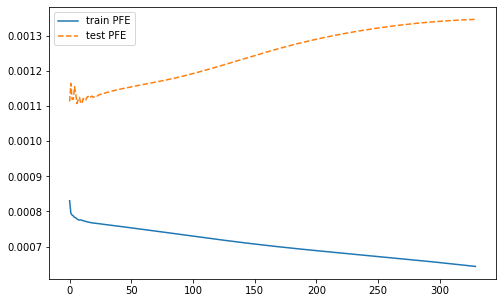

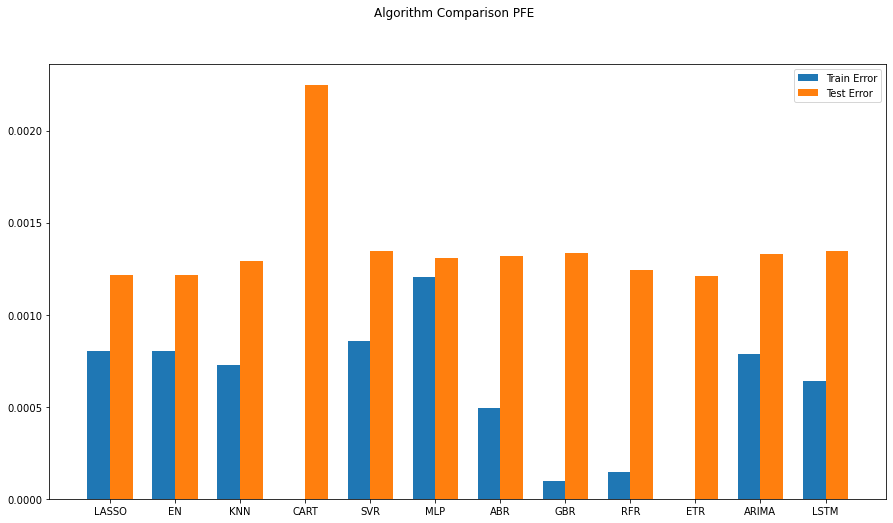

ARIMA(0, 0, 0) MSE=0.0007791
ARIMA(0, 0, 1) MSE=0.0007791
ARIMA(1, 0, 0) MSE=0.0007791
ARIMA(1, 0, 1) MSE=0.0007790
ARIMA(2, 0, 0) MSE=0.0007782
ARIMA(2, 0, 1) MSE=0.0007781
Best ARIMA(2, 0, 1) MSE=0.0007781
0.0013315114618038858


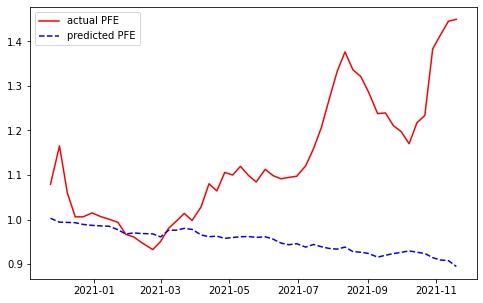

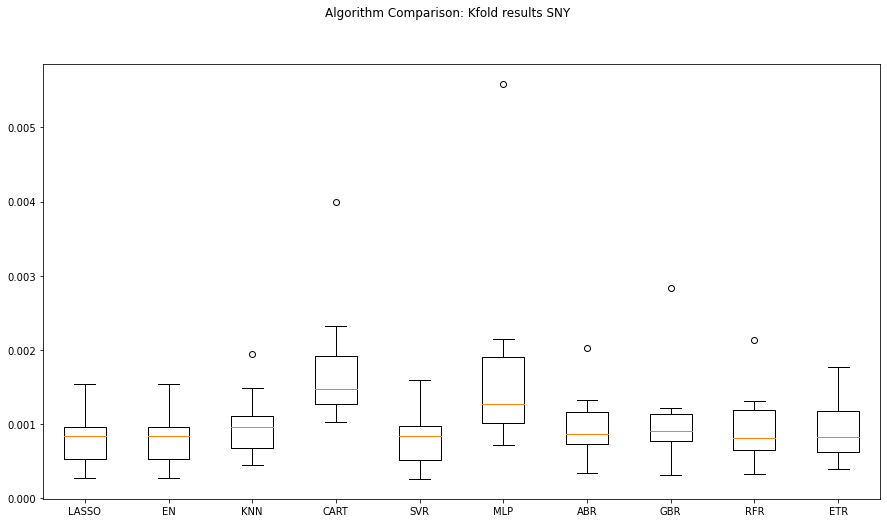

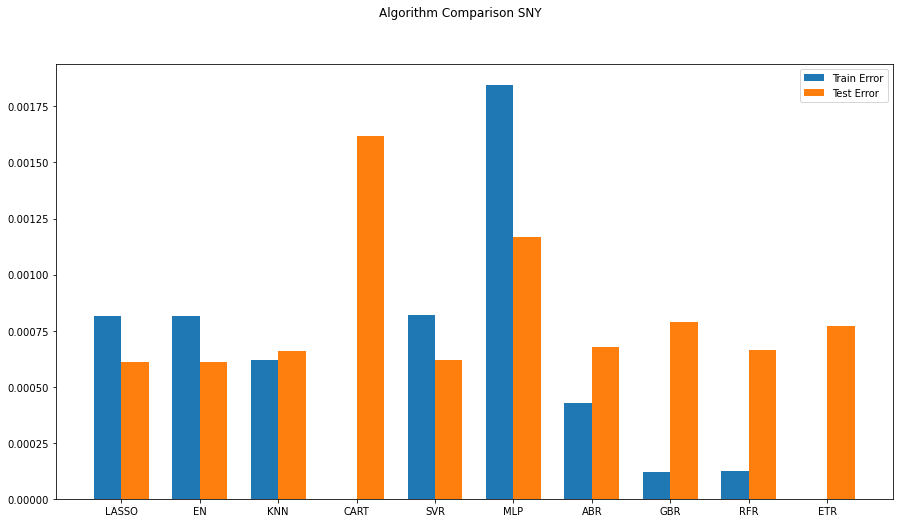

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0006249706915967243
(51, 2, 10)
[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 

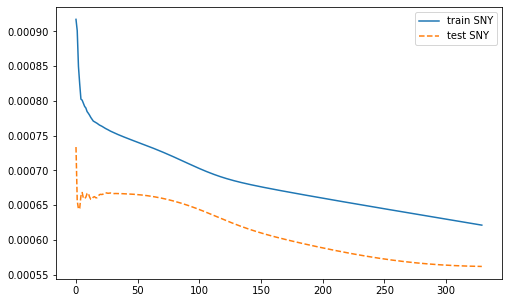

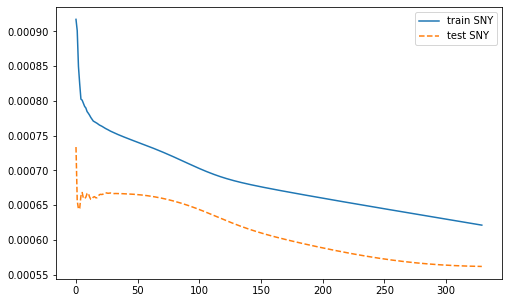

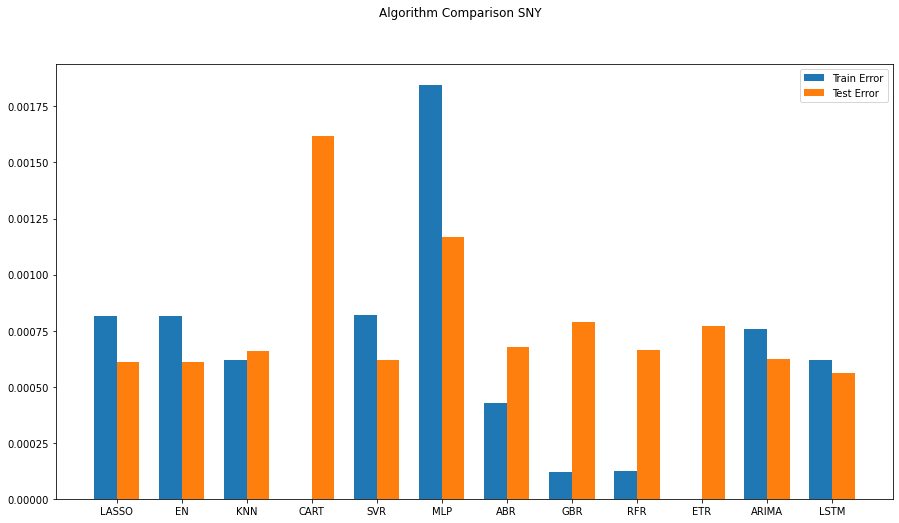

ARIMA(0, 0, 0) MSE=0.0007667
ARIMA(0, 0, 1) MSE=0.0007480
ARIMA(1, 0, 0) MSE=0.0007496
ARIMA(1, 0, 1) MSE=0.0007480
ARIMA(2, 0, 0) MSE=0.0007470
ARIMA(2, 0, 1) MSE=0.0007445
Best ARIMA(2, 0, 1) MSE=0.0007445
0.0006249706915967243


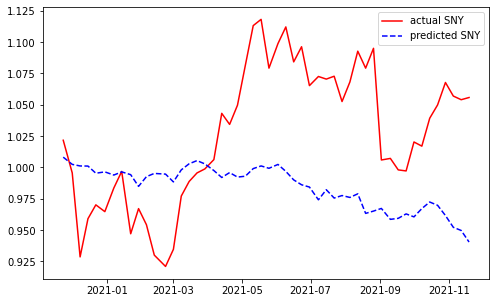

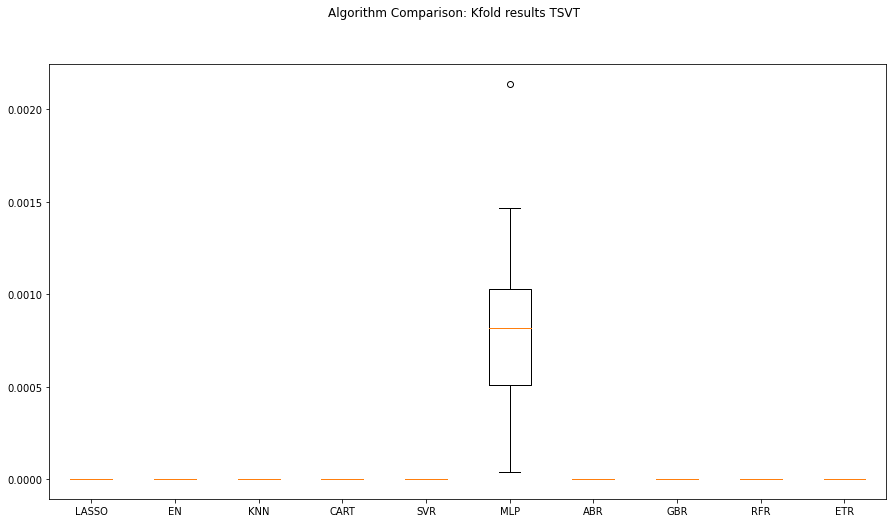

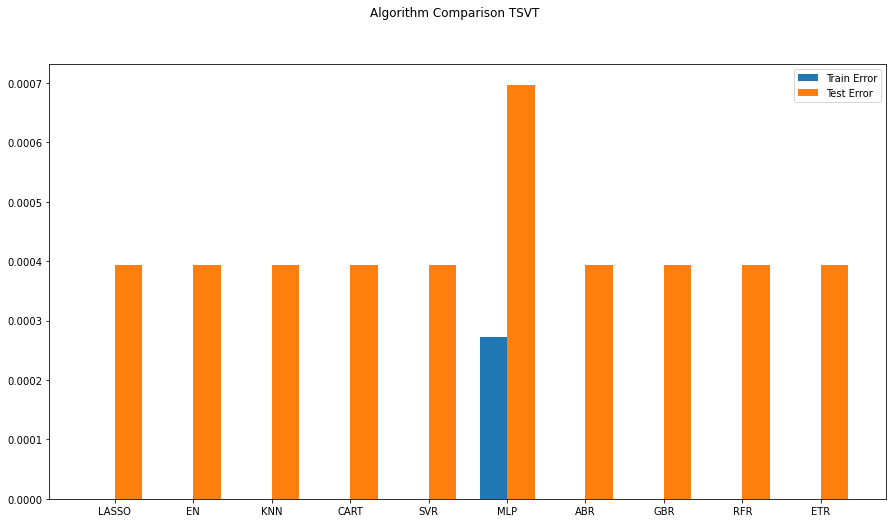

             DEXJPUS   DEXUSUK     SP500      DJIA    VIXCLS
2016-11-25  0.000151 -0.000057  0.002657  0.002159  0.001790
2016-12-02  0.005200  0.017736 -0.009716  0.000954  0.134746
2016-12-09  0.012318 -0.007517  0.030365  0.030132 -0.183739
2016-12-16  0.022070 -0.008936 -0.000646  0.004372  0.037583
2016-12-23 -0.004426 -0.018278  0.002530  0.004545 -0.064320
...              ...       ...       ...       ...       ...
2020-10-19  0.000151 -0.000057 -0.030831 -0.022518  0.151812
2020-10-26 -0.005326  0.001768 -0.007601 -0.018255  0.106525
2020-11-02 -0.000572 -0.009026 -0.027040 -0.027847  0.134417
2020-11-09  0.007415  0.017895  0.070068  0.079671 -0.365991
2020-11-16 -0.009899  0.004557  0.021293  0.026816 -0.137144

[201 rows x 5 columns]
0.0003929569197979335
(51, 2, 6)
[[[0. 0. 0. 0. 0. 0.]
  [0. 0. 0. 0. 0. 0.]]

 [[0. 0. 0. 0. 0. 0.]
  [0. 0. 0. 0. 0. 0.]]

 [[0. 0. 0. 0. 0. 0.]
  [0. 0. 0. 0. 0. 0.]]

 [[0. 0. 0. 0. 0. 0.]
  [0. 0. 0. 0. 0. 0.]]

 [[0. 0. 0. 0. 0. 0.]
  [0.

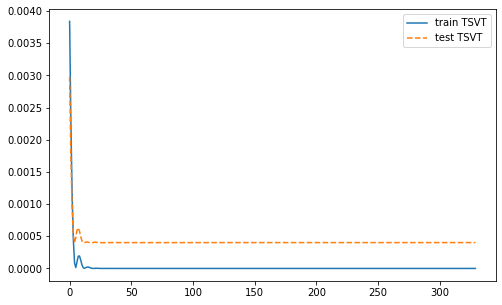

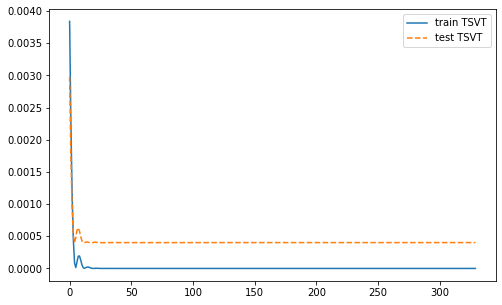

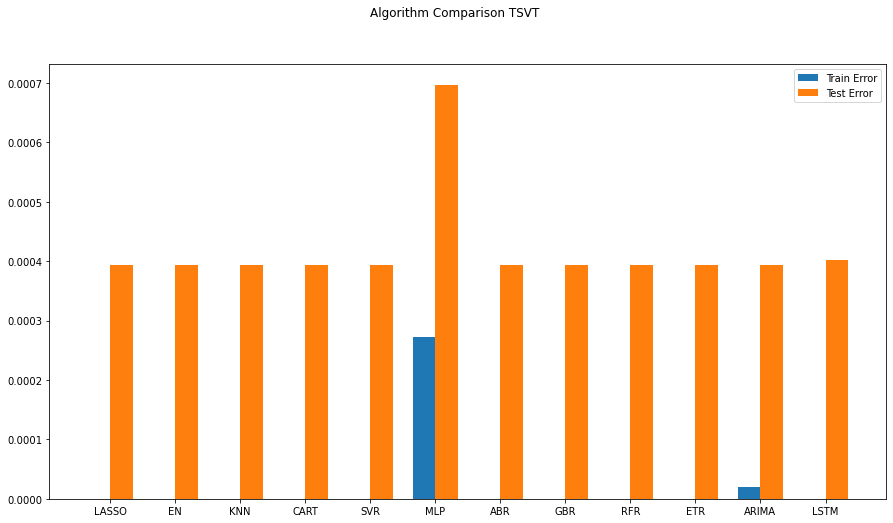

ARIMA(0, 0, 0) MSE=0.0000000
ARIMA(0, 0, 1) MSE=0.0000000
ARIMA(1, 0, 0) MSE=0.0000000
ARIMA(1, 0, 1) MSE=0.0000000
ARIMA(2, 0, 0) MSE=0.0000000
ARIMA(2, 0, 1) MSE=0.0000000
Best ARIMA(2, 0, 1) MSE=0.0000000
0.0003929569197979335


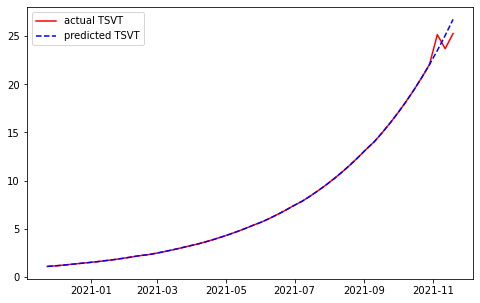

In [74]:
# This is one by one
# LSTM Network
def create_LSTMmodel(learn_rate = 0.01, momentum=0): # create model
        model = Sequential()
        model.add(LSTM(50, input_shape=(X_train_LSTM.shape[1],X_train_LSTM.shape[2])))
        model.add(Dense(1))

        #More cells can be added if needed model.add(Dense(1))
        optimizer = SGD(lr=learn_rate, momentum=momentum) 
        model.compile(loss='mse', optimizer='adam')
        return model
    
def evaluate_arima_model(arima_order):
#predicted = list() 
    modelARIMA=ARIMA(endog=Y_temp,exog=X_train_ARIMA,order=arima_order) 
    model_fit = modelARIMA.fit()
    error = mean_squared_error(Y_temp, model_fit.fittedvalues)
    return error

# evaluate combinations of p, d and q values for an ARIMA model
def evaluate_models(p_values, d_values, q_values): 
    best_score, best_cfg = float("inf"), None
    for p in p_values:
        for d in d_values:
            for q in q_values:
                order = (p,d,q) 
                try:
                    mse = evaluate_arima_model(order) 
                    if mse < best_score:
                        best_score, best_cfg = mse, order
                    print('ARIMA%s MSE=%.7f' % (order,mse))
                except: 
                    continue
    print('Best ARIMA%s MSE=%.7f' % (best_cfg, best_score))
    

    
seq_len = 2 #Length of the seq for the LSTM

for i in stk_tickers:
    try:
        X_temp1 = X_train.filter(regex=i, axis=1)
        X_temp2 = X_train.loc[:,['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]
        X_temp = pd.concat([X_temp1, X_temp2], axis=1)

        #X_temp = X_train
        Y_temp = Y_train.filter(regex=i, axis=1)

        X_temp_test1 = X_test.filter(regex=i, axis=1)
        X_temp_test2 = X_test.loc[:,['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]
        X_temp_test = pd.concat([X_temp_test1, X_temp_test2], axis=1)

        #X_temp_test = X_test
        Y_temp_test = Y_test.filter(regex=i, axis=1)

        temp = X.loc[:,['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]
        temp2 = X.filter(regex=i, axis=1)
        X_temp_fulX = pd.concat([temp2, temp], axis=1)


        names = []

        kfold_results = [] 
        test_results = [] 
        train_results = []
        # Model testing
        for name, model in models:
            names.append(name)
            ## k-fold analysis:
            kfold = KFold(n_splits=num_folds)
            #converted mean squared error to positive. The lower the better
            cv_results = -1* cross_val_score(model, X_temp, Y_temp, cv=kfold, scoring=scoring)
            kfold_results.append(cv_results)
            # Full Training period
            res = model.fit(X_temp, Y_temp)
            train_result = mean_squared_error(res.predict(X_temp), Y_temp) 
            train_results.append(train_result)
            # Test results
            test_result = mean_squared_error(res.predict(X_temp_test), Y_temp_test) 
            test_results.append(test_result)
        # Comparition starts by ticker
        for j in range(0,1):
            fig = pyplot.figure()
            fig.suptitle(f'Algorithm Comparison: Kfold results {i}')
            ax = fig.add_subplot(111)
            pyplot.boxplot(kfold_results)
            ax.set_xticklabels(names)
            fig.set_size_inches(15,8)
            plt.savefig(f"../readme_images/{i}_comparison_Single.png")
            pyplot.show()
        # Error testing
        for k in range(0,1):
            fig = pyplot.figure()
            ind = np.arange(len(names)) # the x locations for the groups
            width = 0.35 # the width of the bars
            fig.suptitle(f'Algorithm Comparison {i}')
            ax = fig.add_subplot(111)
            pyplot.bar(ind - width/2, train_results,  width=width, label='Train Error')
            pyplot.bar(ind + width/2, test_results, width=width, label='Test Error')
            fig.set_size_inches(15,8)
            pyplot.legend()
            ax.set_xticks(ind)
            ax.set_xticklabels(names)
            plt.savefig(f"../readme_images/{i}_error_testing_Single.png")
            pyplot.show()

        # ARIMA and LSTM
        for arimalstm in range(0,1):
            X_train_ARIMA=X_temp.loc[:, ['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]
            X_test_ARIMA=X_temp_test.loc[:, ['DEXJPUS', 'DEXUSUK', 'SP500', 'DJIA', 'VIXCLS']]

            tr_len = len(X_train_ARIMA)
            te_len = len(X_test_ARIMA)
            to_len = len(X_temp_fulX)

            print(X_train_ARIMA)

            X_train_ARIMA.index=pd.DatetimeIndex(X_train_ARIMA.index).to_period('W')

            Y_temp.index=pd.DatetimeIndex(Y_temp.index).to_period('W')

            modelARIMA=ARIMA(endog=Y_temp,exog=X_train_ARIMA,order=[1,0,0])
            model_fit = modelARIMA.fit(trend='nc')

            error_Training_ARIMA = mean_squared_error(Y_temp, model_fit.fittedvalues)
            predicted = model_fit.predict(start = tr_len -1 ,end = to_len -1, exog = X_test_ARIMA)[1:]
            error_Test_ARIMA = mean_squared_error(Y_temp_test,predicted)
            print(error_Test_ARIMA)

            #seq_len = 2 #Length of the seq for the LSTM
            Y_train_LSTM, Y_test_LSTM = np.array(Y_temp)[seq_len-1:], np.array(Y_temp_test) 
            X_train_LSTM = np.zeros((X_temp.shape[0]+1-seq_len, seq_len, X_temp.shape[1]))
            X_test_LSTM = np.zeros((X_temp_test.shape[0], seq_len, X_temp_fulX.shape[1]))
            print(X_test_LSTM.shape)
            print(X_test_LSTM)

            for l in range(seq_len):
                X_train_LSTM[:, l, :] = np.array(X_temp)[l:X_temp.shape[0]+l+1-seq_len, :]
                X_test_LSTM[:, l, :] = np.array(X_temp_fulX)[X_temp.shape[0]+l-1:X_temp_fulX.shape[0]+l+1-seq_len, :]
            print(X_test_LSTM.shape)
            print(X_test_LSTM)

            LSTMModel = create_LSTMmodel(learn_rate = 0.01, momentum=0)
            LSTMModel_fit = LSTMModel.fit(X_train_LSTM, Y_train_LSTM, validation_data=(X_test_LSTM, Y_test_LSTM),epochs=330, batch_size=72, verbose=0, shuffle=False)

            for m in range(seq_len):
                pyplot.plot(LSTMModel_fit.history['loss'], label=f'train {i}', )
                pyplot.plot(LSTMModel_fit.history['val_loss'], '--',label=f'test {i}',)
                pyplot.legend()
                plt.savefig(f"../readme_images/{i}_train_test_Single.png")
                pyplot.show()

            error_Training_LSTM = mean_squared_error(Y_train_LSTM,LSTMModel.predict(X_train_LSTM))
            predicted = LSTMModel.predict(X_test_LSTM)
            error_Test_LSTM = mean_squared_error(Y_temp_test,predicted)

            test_results.append(error_Test_ARIMA)
            test_results.append(error_Test_LSTM)
            train_results.append(error_Training_ARIMA)
            train_results.append(error_Training_LSTM)
            names.append("ARIMA")
            names.append("LSTM")

            for n in range(0,1):
                fig = pyplot.figure()
                ind = np.arange(len(names)) # the x locations for the groups
                width = 0.35 # the width of the bars
                fig.suptitle(f'Algorithm Comparison {i}')
                ax = fig.add_subplot(111)
                pyplot.bar(ind - width/2, train_results,  width=width, label='Train Error')
                pyplot.bar(ind + width/2, test_results, width=width, label='Test Error')
                fig.set_size_inches(15,8)
                pyplot.legend()
                ax.set_xticks(ind)
                ax.set_xticklabels(names)
                plt.savefig(f"../readme_images/{i}_train_test_error_Single.png")
                pyplot.show()

            p_values = [0, 1, 2]
            d_values = range(0, 2)
            q_values = range(0, 2)

            evaluate_models(p_values, d_values, q_values)

            modelARIMA_tuned=ARIMA(endog=Y_temp,exog=X_train_ARIMA,order=[2,0,1])
            model_fit_tuned = modelARIMA_tuned.fit(trend='nc')
            # estimate accuracy on validation set
            predicted_tuned = model_fit.predict(start = tr_len -1 ,end = to_len -1, exog = X_test_ARIMA)[1:]
            print(mean_squared_error(Y_temp_test,predicted_tuned))

            # plotting the actual data versus predicted data
            for o in range(0,1):
                predicted_tuned.index = Y_temp_test.index
                pyplot.plot(np.exp(Y_temp_test).cumprod(), 'r', label=f'actual {i}',)
                # plotting t, a separately
                pyplot.plot(np.exp(predicted_tuned).cumprod(), 'b--', label=f'predicted {i}')
                pyplot.legend()
                pyplot.rcParams["figure.figsize"] = (8,5)
                plt.savefig(f"../readme_images/{i}_predictions_Single.png")
                pyplot.show()
    except:
        pass
    

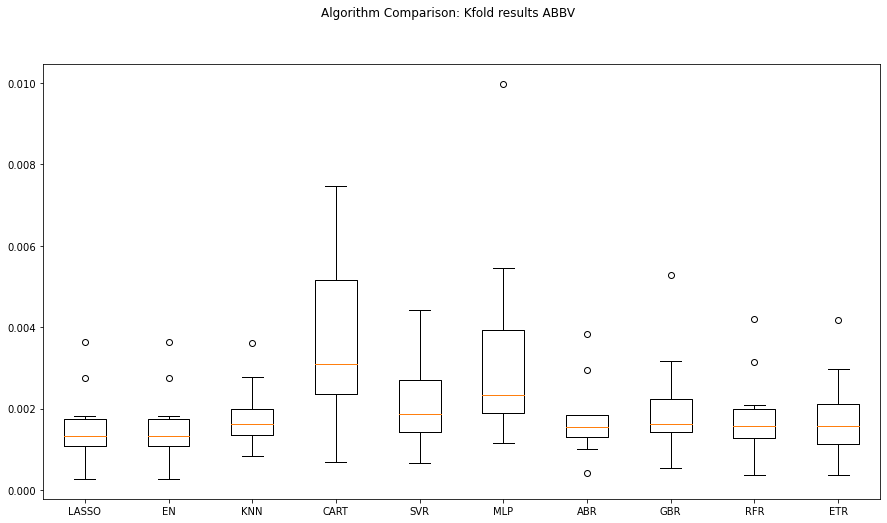

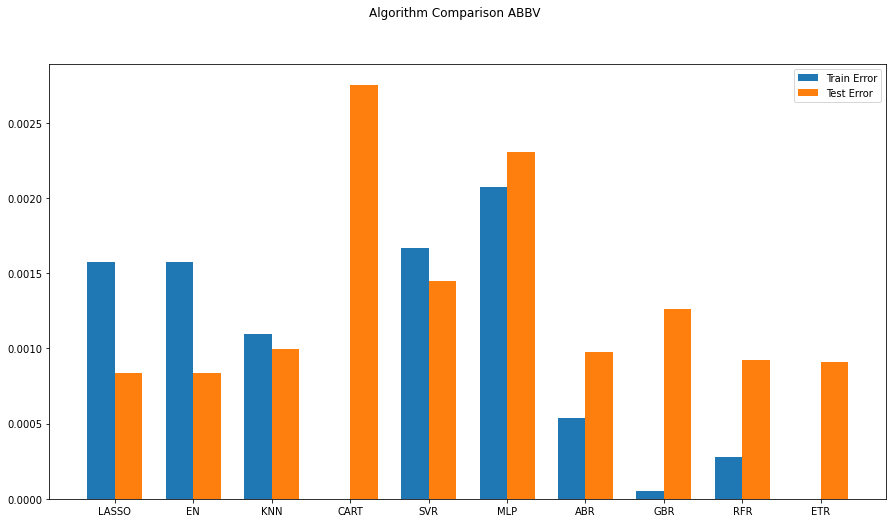

                AMGN       AZN      BIIB       BMY      CRXT      GILD  \
2016-11-25  0.001954  0.003727 -0.000668  0.000679 -0.019542  0.000429   
2016-12-02 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542 -0.040855   
2016-12-09 -0.003896  0.047888 -0.032210  0.019116 -0.019542  0.003859   
2016-12-16  0.040440  0.025447 -0.004772  0.027323 -0.019542  0.025492   
2016-12-23 -0.012259 -0.019939  0.003938  0.016747 -0.019542 -0.006227   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542 -0.063640   
2020-10-26 -0.025550  0.011942 -0.045714 -0.018267 -0.019542 -0.010122   
2020-11-02 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542 -0.024138   
2020-11-09  0.065004  0.065563 -0.052480  0.074324 -0.019542  0.008845   
2020-11-16  0.013809  0.040607  0.060361  0.006533 -0.019542  0.033964   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

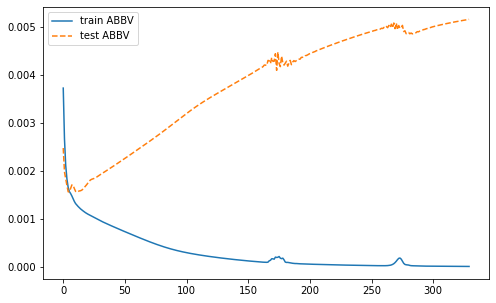

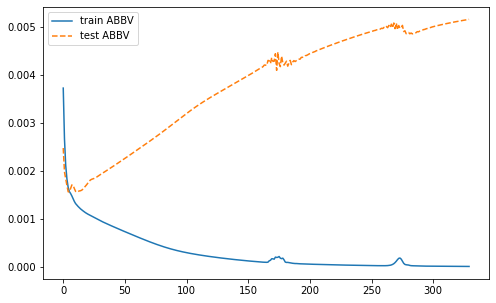

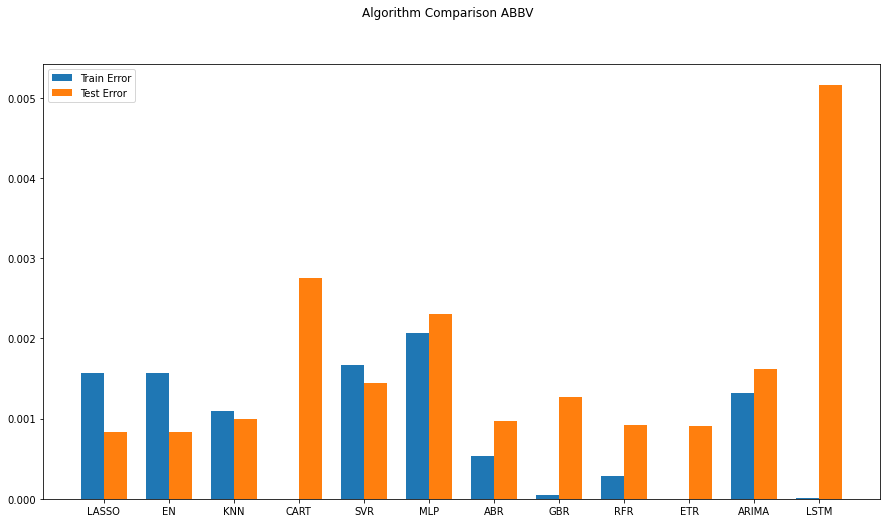

Best ARIMANone MSE=inf
0.001612577954462672


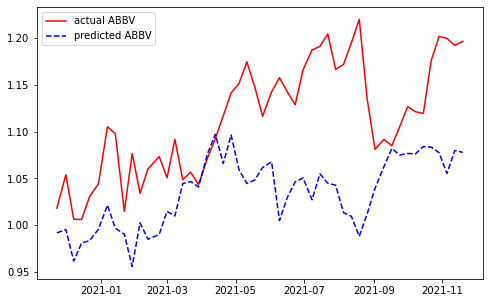

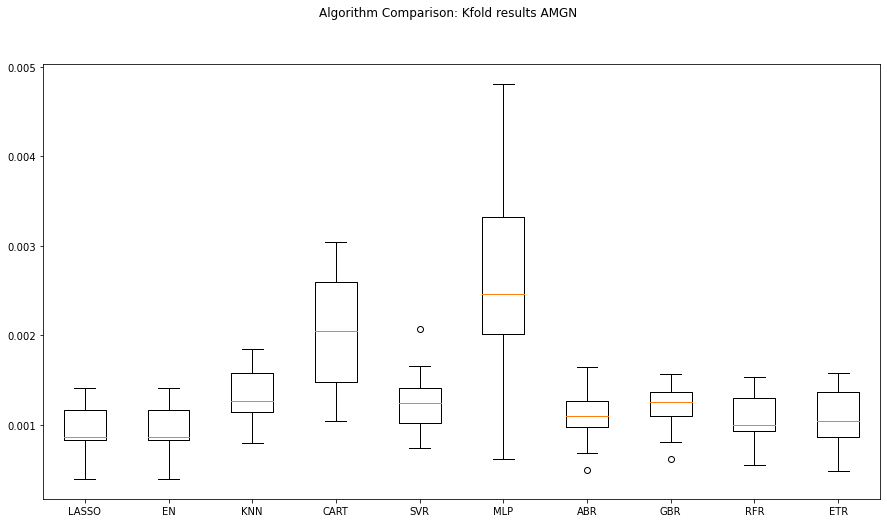

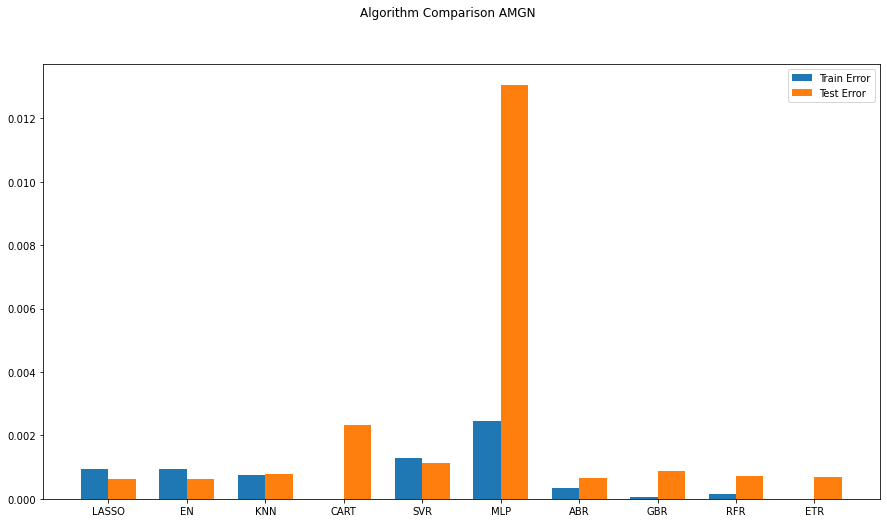

                ABBV       AZN      BIIB       BMY      CRXT      GILD  \
2016-11-25  0.003571  0.003727 -0.000668  0.000679 -0.019542  0.000429   
2016-12-02 -0.018010 -0.045677 -0.026596 -0.018063 -0.019542 -0.040855   
2016-12-09  0.034888  0.047888 -0.032210  0.019116 -0.019542  0.003859   
2016-12-16  0.010989  0.025447 -0.004772  0.027323 -0.019542  0.025492   
2016-12-23  0.001927 -0.019939  0.003938  0.016747 -0.019542 -0.006227   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.052561 -0.081115 -0.017292 -0.019542 -0.063640   
2020-10-26 -0.004637  0.011942 -0.045714 -0.018267 -0.019542 -0.010122   
2020-11-02  0.050310 -0.047265 -0.030729 -0.003021 -0.019542 -0.024138   
2020-11-09  0.074966  0.065563 -0.052480  0.074324 -0.019542  0.008845   
2020-11-16  0.033495  0.040607  0.060361  0.006533 -0.019542  0.033964   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

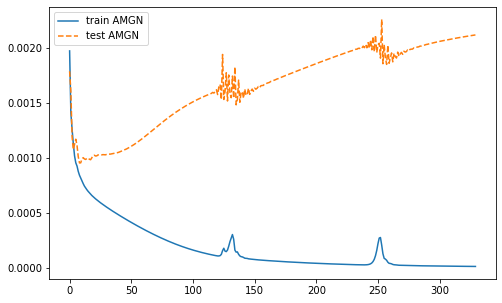

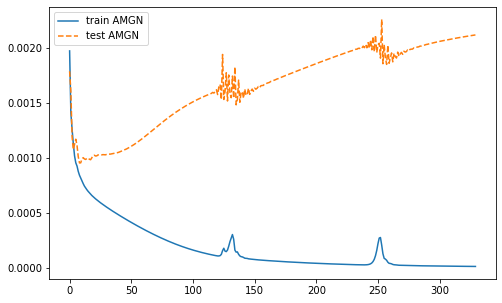

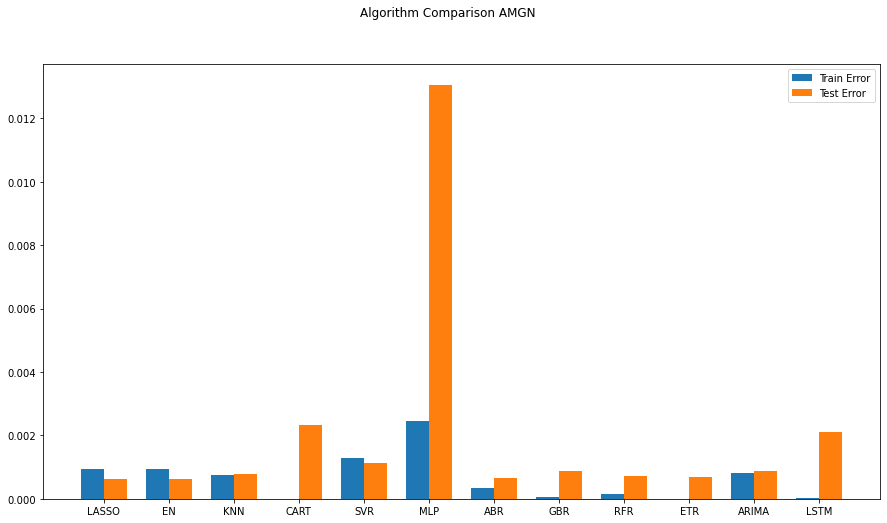

Best ARIMANone MSE=inf
0.0008860494354043271


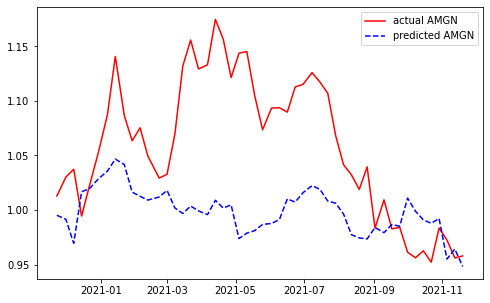

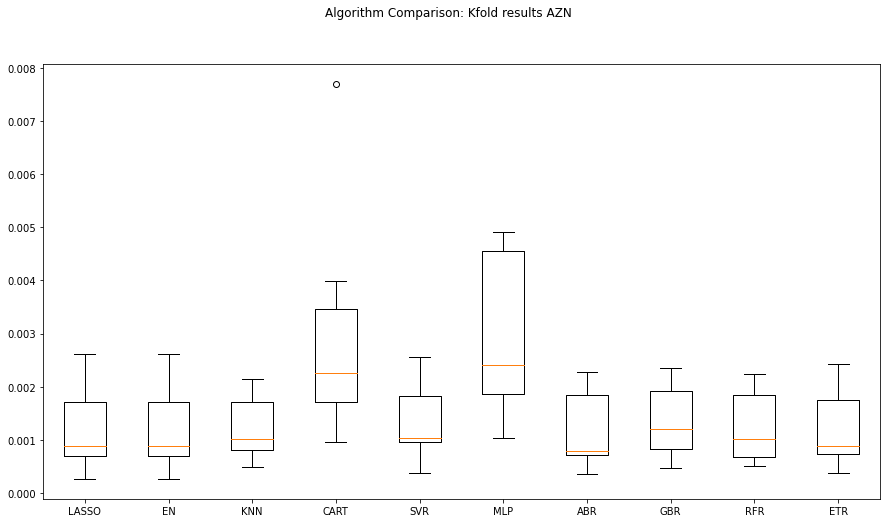

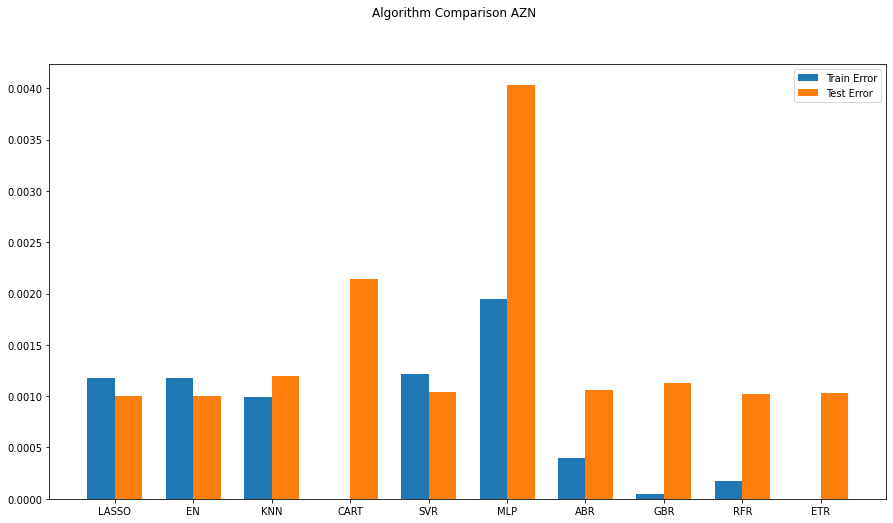

                ABBV      AMGN      BIIB       BMY      CRXT      GILD  \
2016-11-25  0.003571  0.001954 -0.000668  0.000679 -0.019542  0.000429   
2016-12-02 -0.018010 -0.009813 -0.026596 -0.018063 -0.019542 -0.040855   
2016-12-09  0.034888 -0.003896 -0.032210  0.019116 -0.019542  0.003859   
2016-12-16  0.010989  0.040440 -0.004772  0.027323 -0.019542  0.025492   
2016-12-23  0.001927 -0.012259  0.003938  0.016747 -0.019542 -0.006227   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.081115 -0.017292 -0.019542 -0.063640   
2020-10-26 -0.004637 -0.025550 -0.045714 -0.018267 -0.019542 -0.010122   
2020-11-02  0.050310 -0.021030 -0.030729 -0.003021 -0.019542 -0.024138   
2020-11-09  0.074966  0.065004 -0.052480  0.074324 -0.019542  0.008845   
2020-11-16  0.033495  0.013809  0.060361  0.006533 -0.019542  0.033964   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

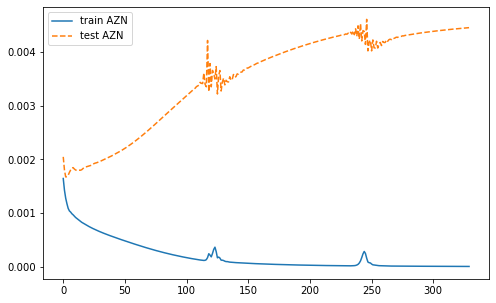

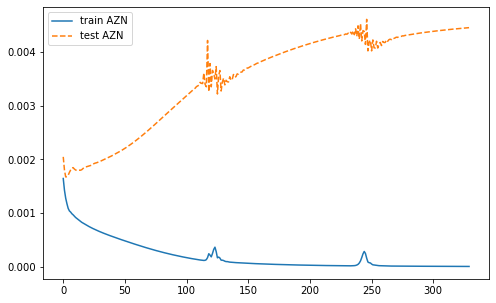

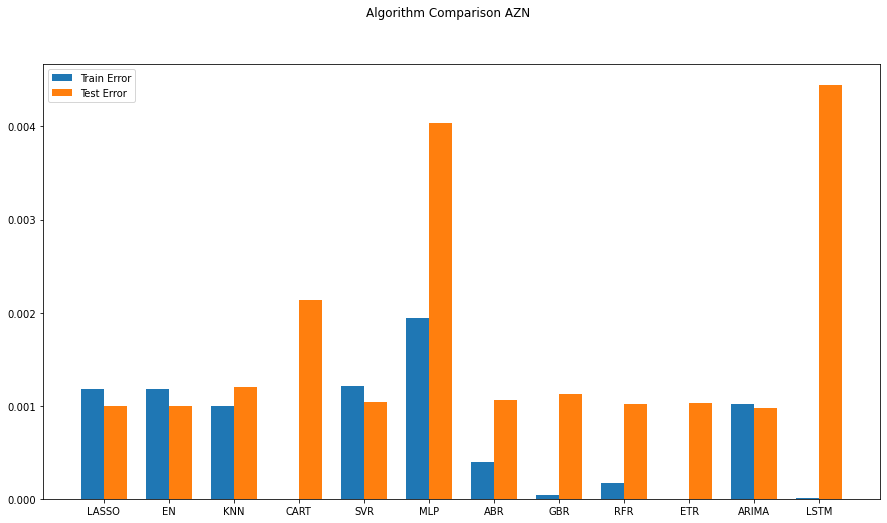

Best ARIMANone MSE=inf
0.0009736894710805654


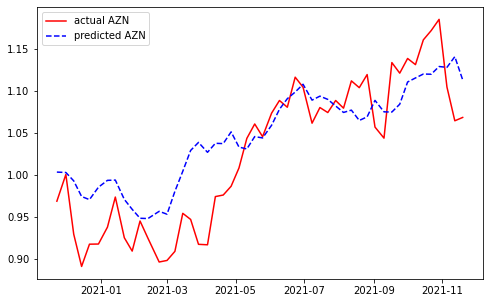

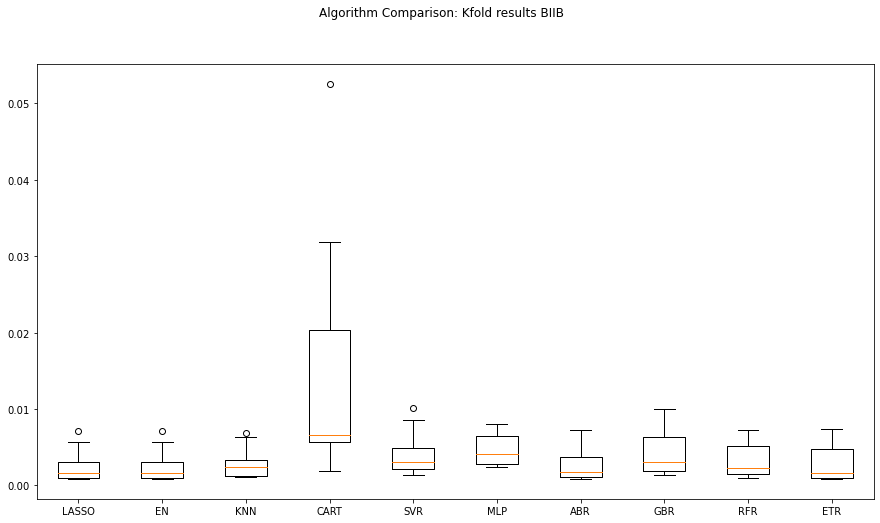

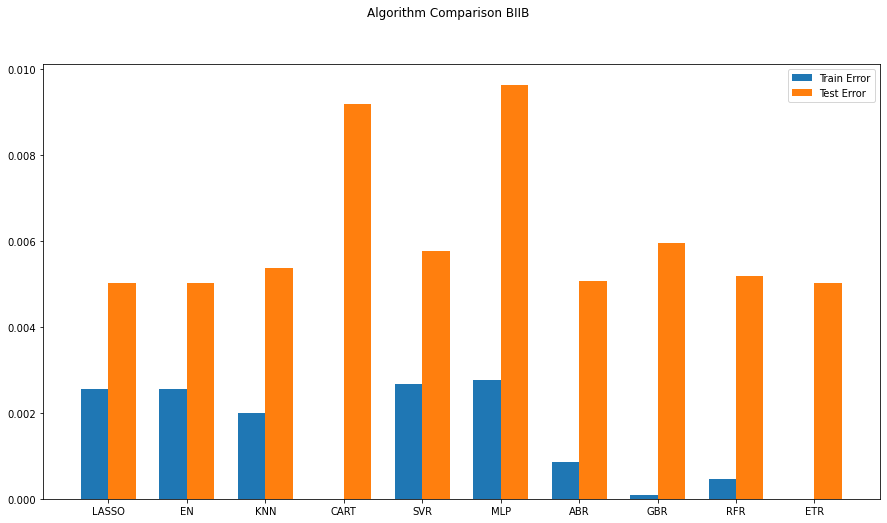

                ABBV      AMGN       AZN       BMY      CRXT      GILD  \
2016-11-25  0.003571  0.001954  0.003727  0.000679 -0.019542  0.000429   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.018063 -0.019542 -0.040855   
2016-12-09  0.034888 -0.003896  0.047888  0.019116 -0.019542  0.003859   
2016-12-16  0.010989  0.040440  0.025447  0.027323 -0.019542  0.025492   
2016-12-23  0.001927 -0.012259 -0.019939  0.016747 -0.019542 -0.006227   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.017292 -0.019542 -0.063640   
2020-10-26 -0.004637 -0.025550  0.011942 -0.018267 -0.019542 -0.010122   
2020-11-02  0.050310 -0.021030 -0.047265 -0.003021 -0.019542 -0.024138   
2020-11-09  0.074966  0.065004  0.065563  0.074324 -0.019542  0.008845   
2020-11-16  0.033495  0.013809  0.040607  0.006533 -0.019542  0.033964   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

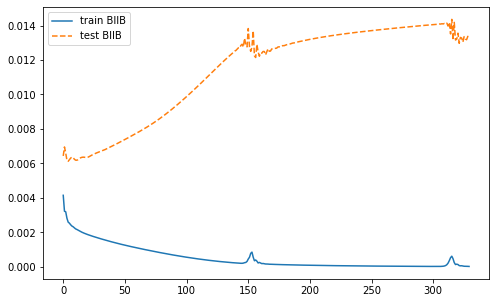

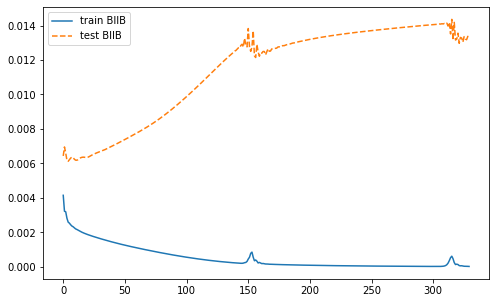

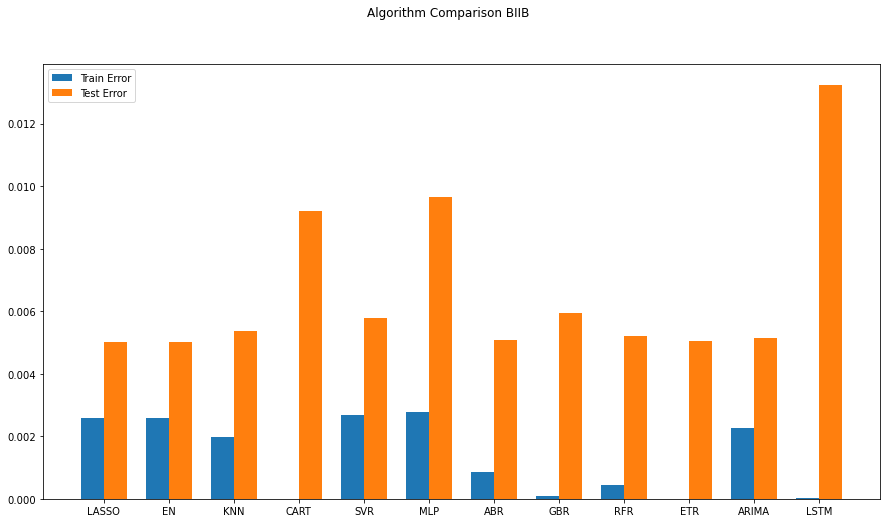

Best ARIMANone MSE=inf
0.0051436885624149475


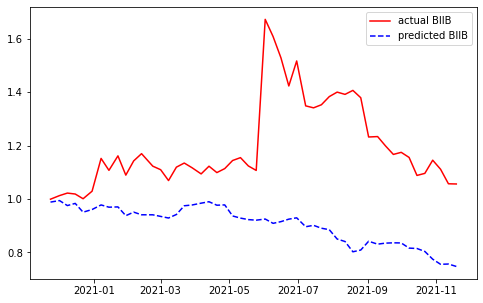

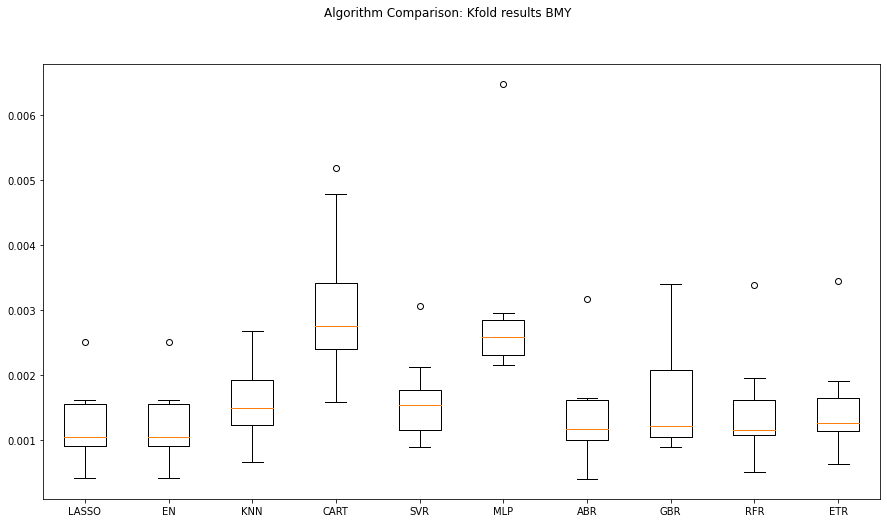

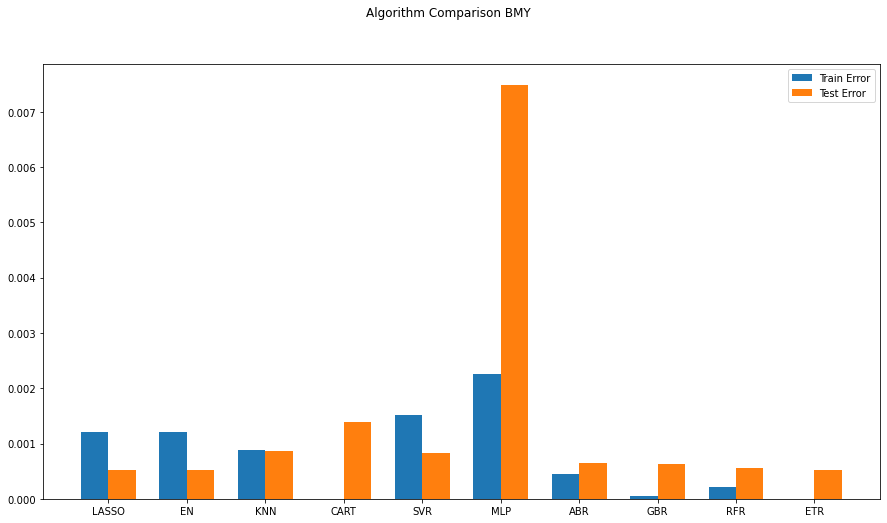

                ABBV      AMGN       AZN      BIIB      CRXT      GILD  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668 -0.019542  0.000429   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.019542 -0.040855   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210 -0.019542  0.003859   
2016-12-16  0.010989  0.040440  0.025447 -0.004772 -0.019542  0.025492   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938 -0.019542 -0.006227   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.019542 -0.063640   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.019542 -0.010122   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.019542 -0.024138   
2020-11-09  0.074966  0.065004  0.065563 -0.052480 -0.019542  0.008845   
2020-11-16  0.033495  0.013809  0.040607  0.060361 -0.019542  0.033964   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

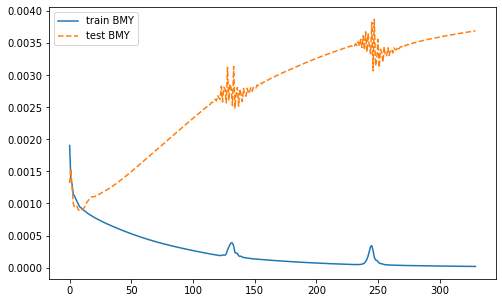

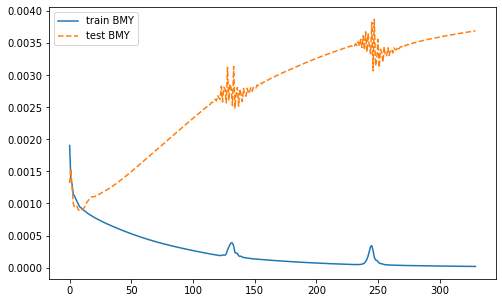

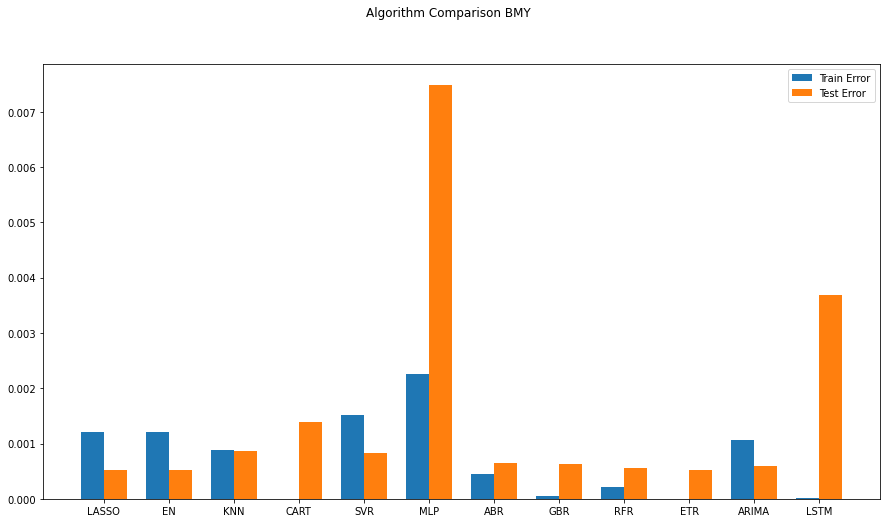

Best ARIMANone MSE=inf
0.0005958327892624085


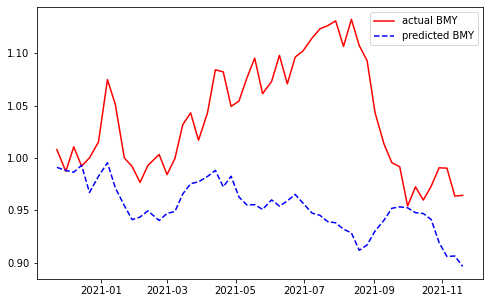

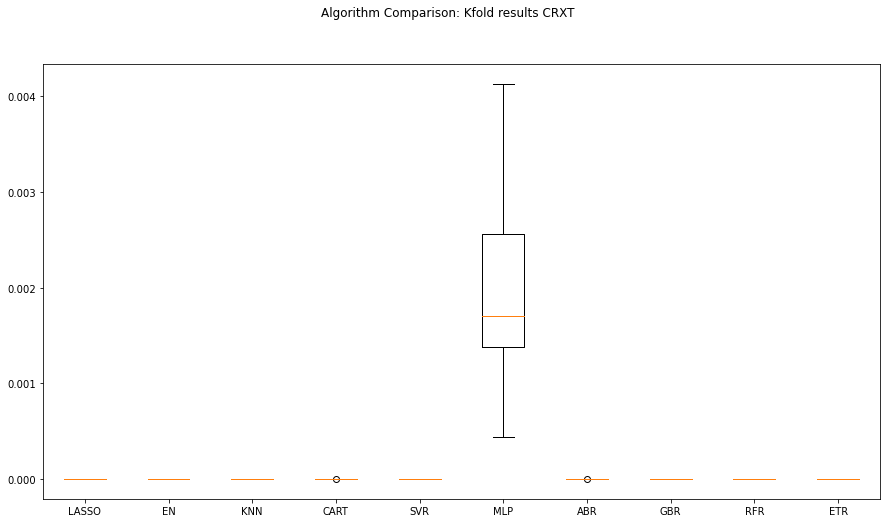

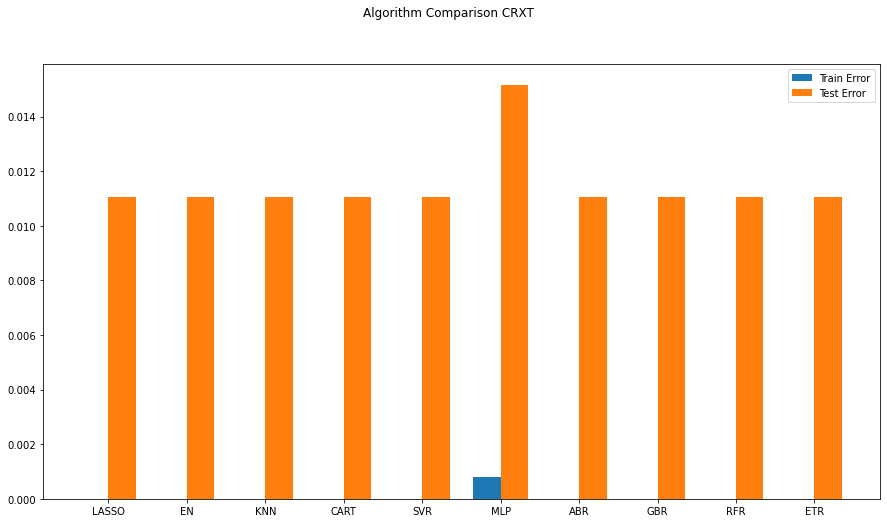

                ABBV      AMGN       AZN      BIIB       BMY      GILD  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679  0.000429   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.040855   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116  0.003859   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323  0.025492   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.006227   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.063640   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.010122   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.024138   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324  0.008845   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533  0.033964   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

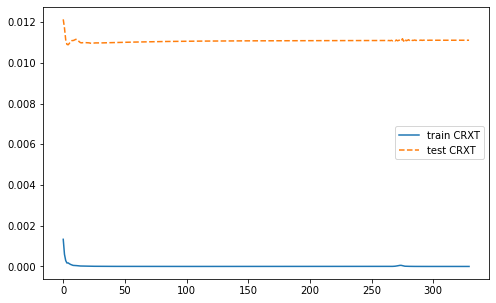

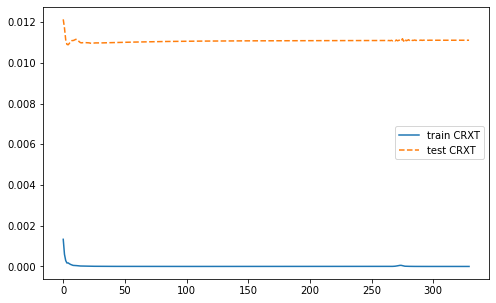

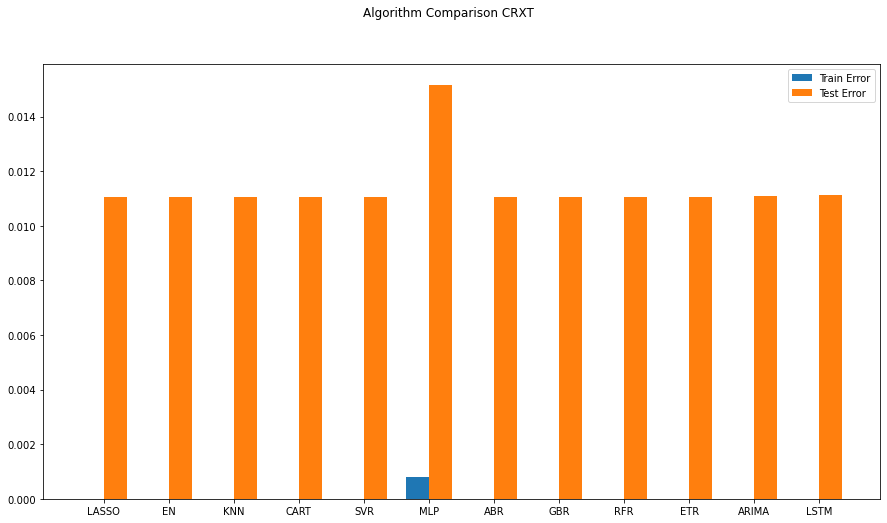

Best ARIMANone MSE=inf
0.01108044553842631


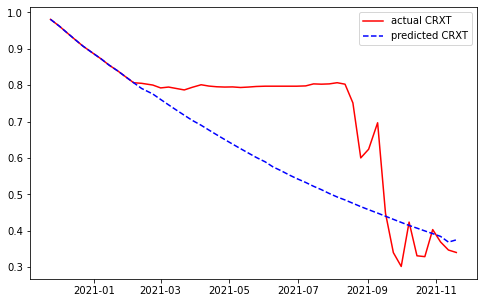

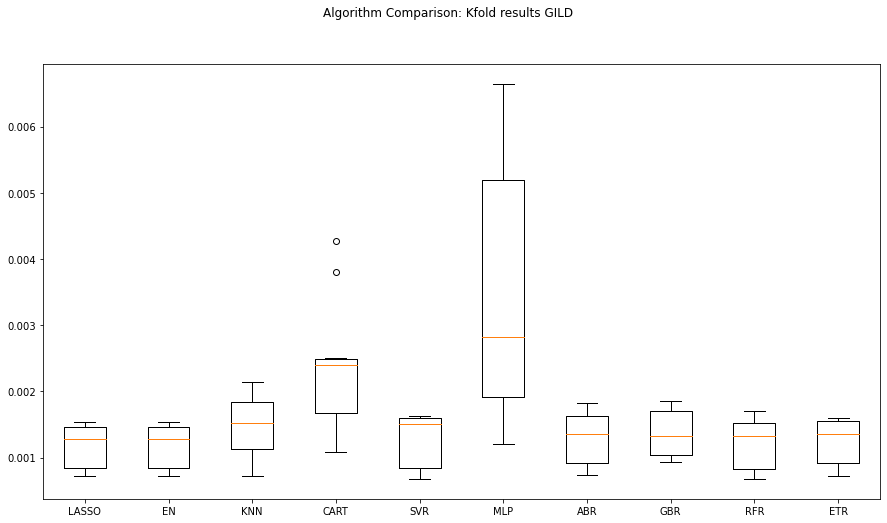

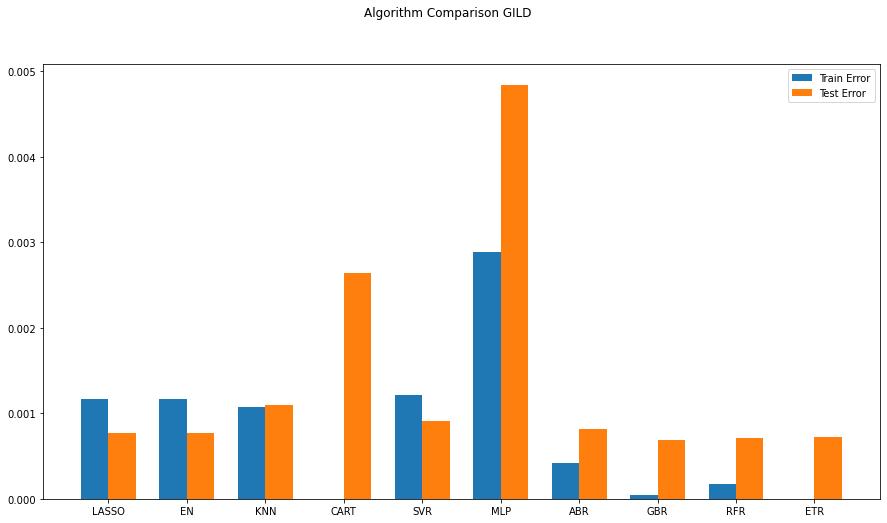

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GRFS       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25 -0.000697  0.001384  

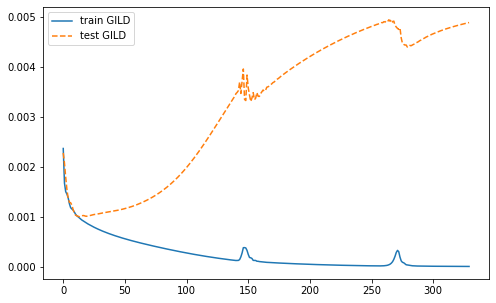

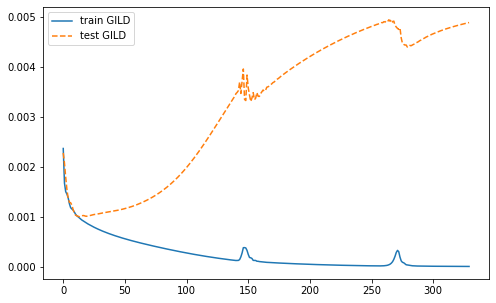

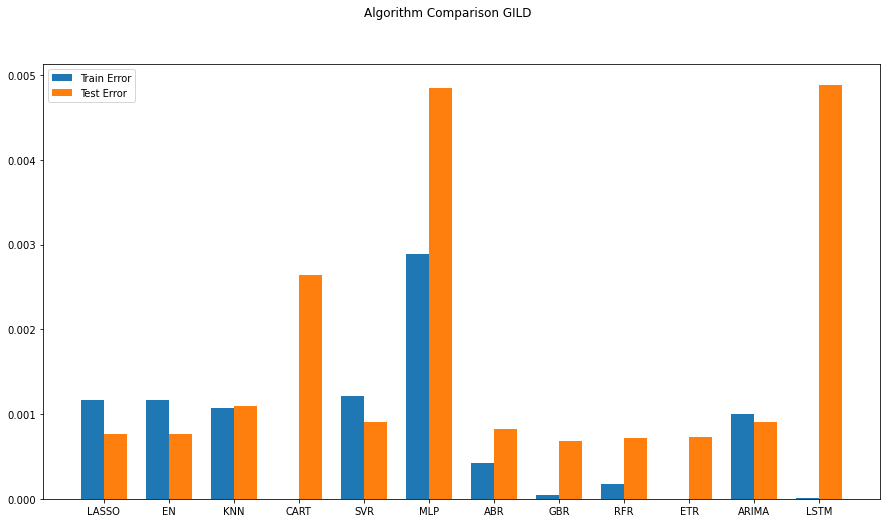

Best ARIMANone MSE=inf
0.0009011145227283621


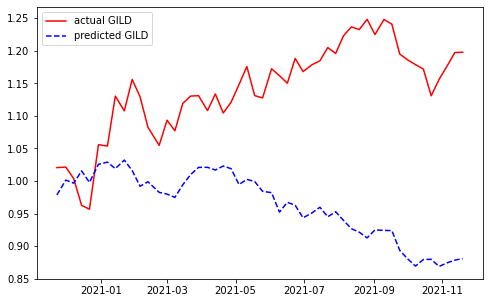

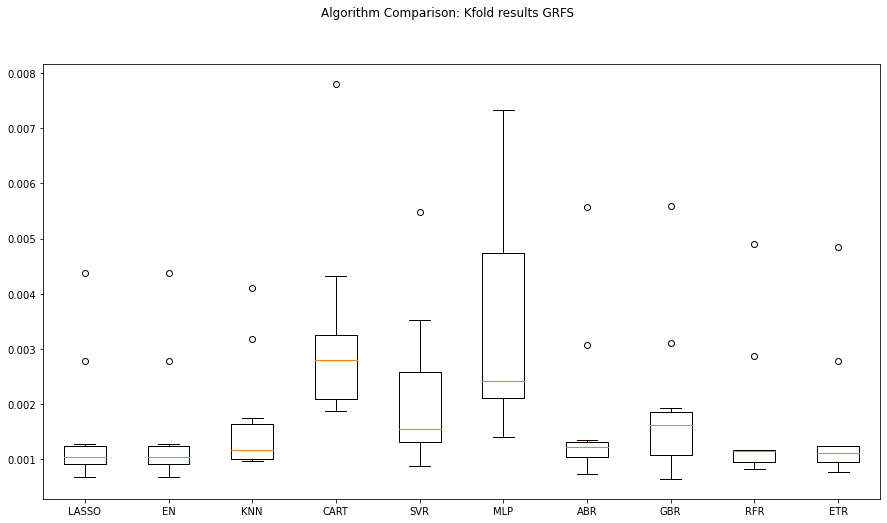

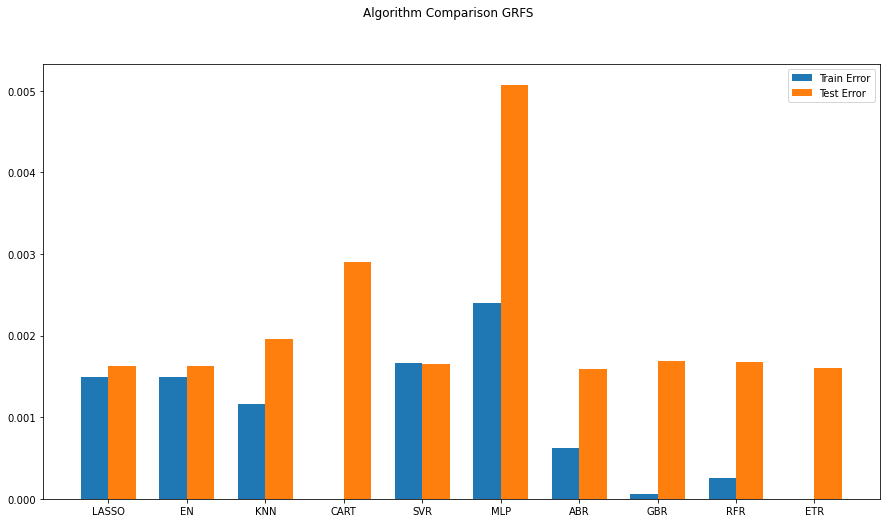

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD       GSK       HCM      HZNP  ...       NVS       OGN  \
2016-11-25  0.000429  0.001384  

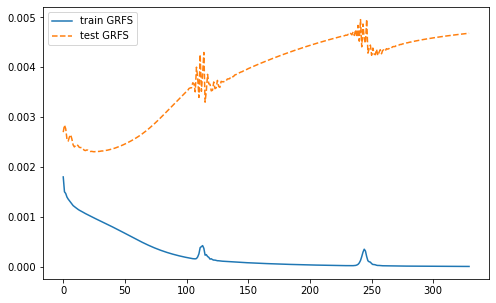

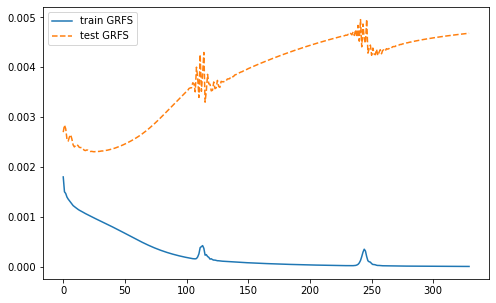

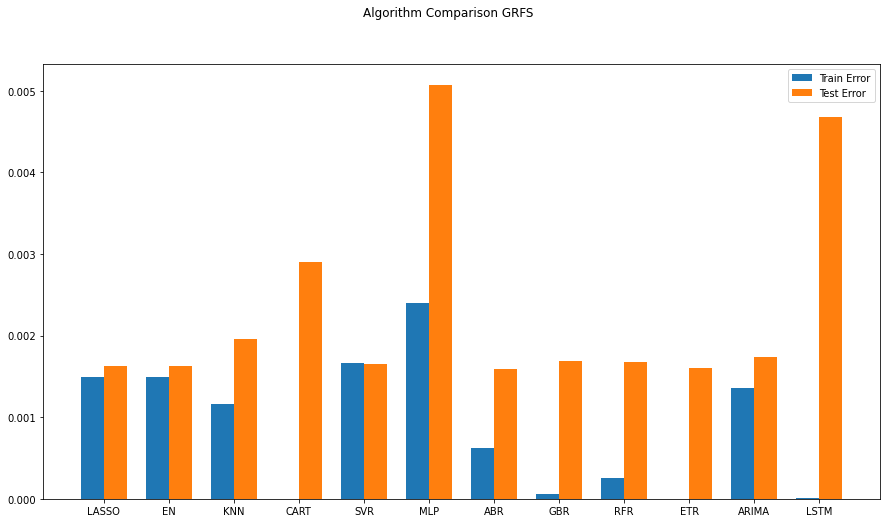

Best ARIMANone MSE=inf
0.0017436817552027705


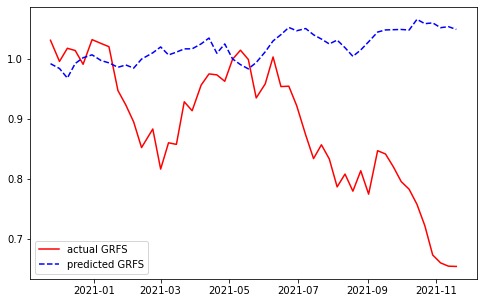

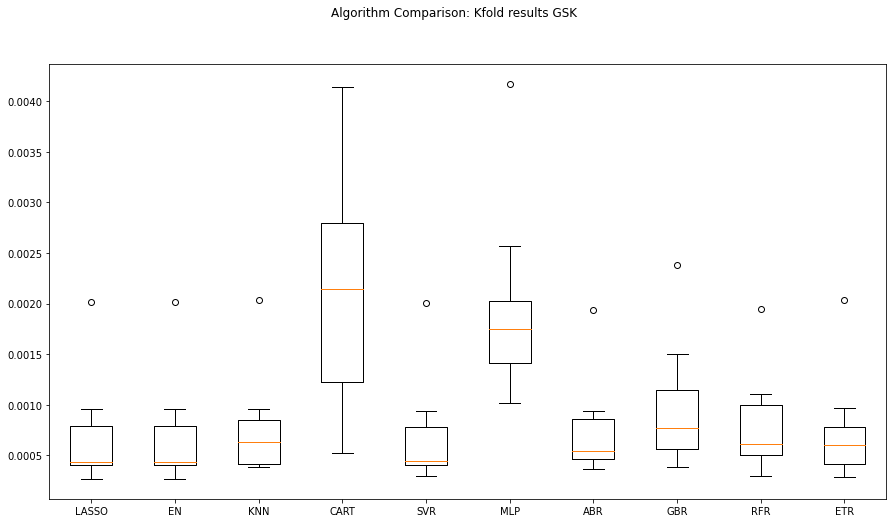

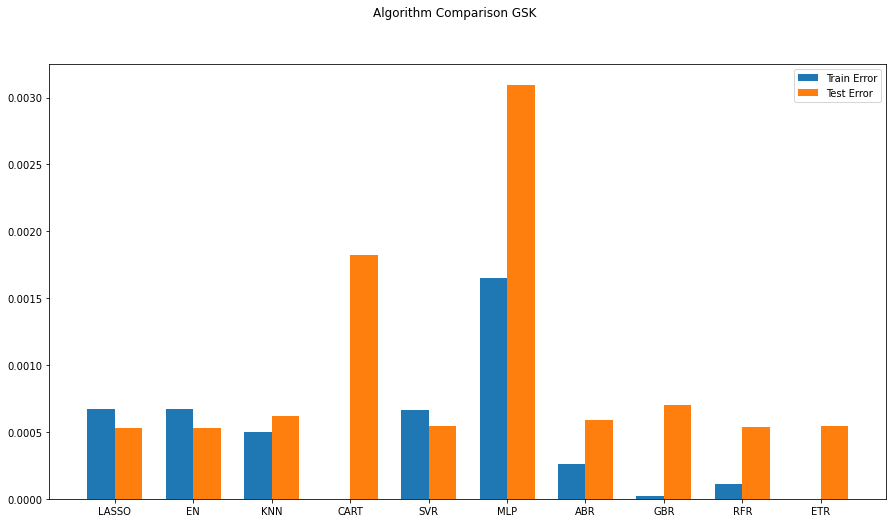

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       HCM      HZNP  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

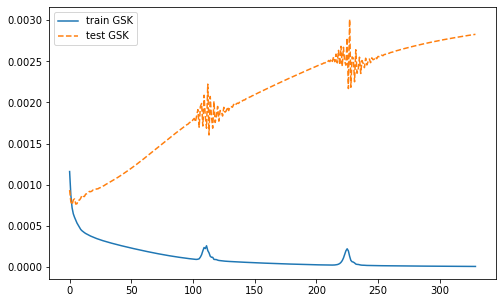

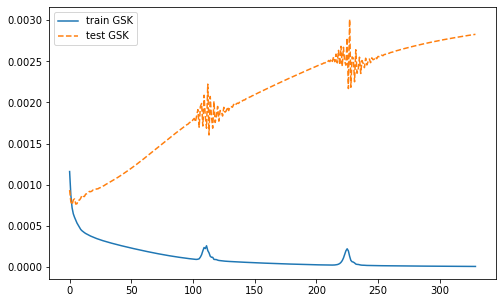

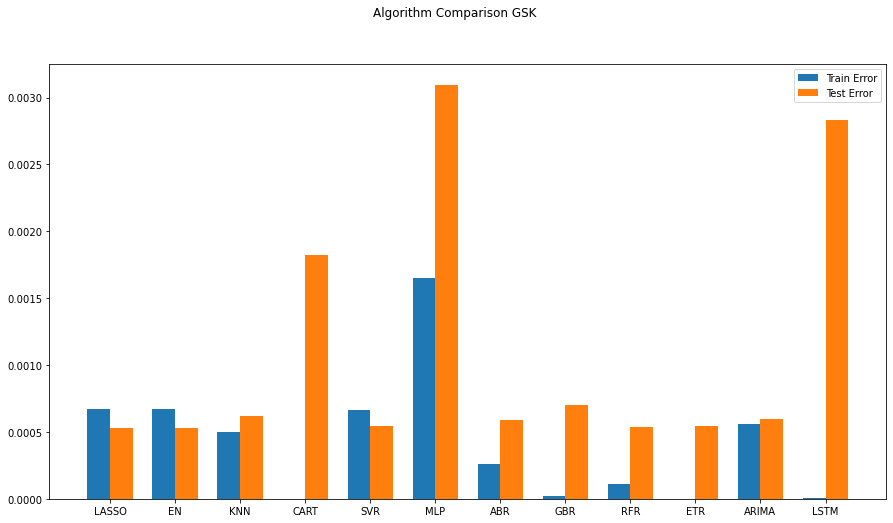

Best ARIMANone MSE=inf
0.0005984722121327377


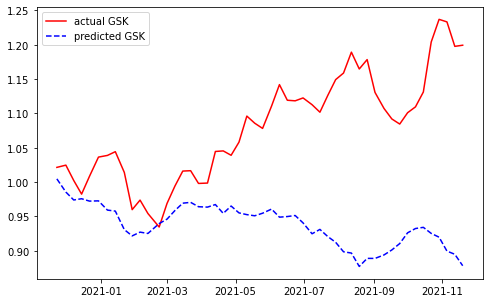

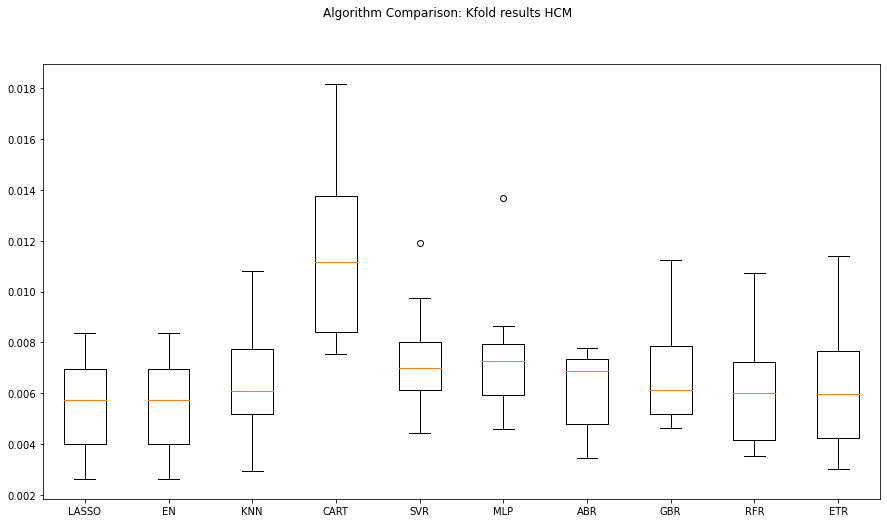

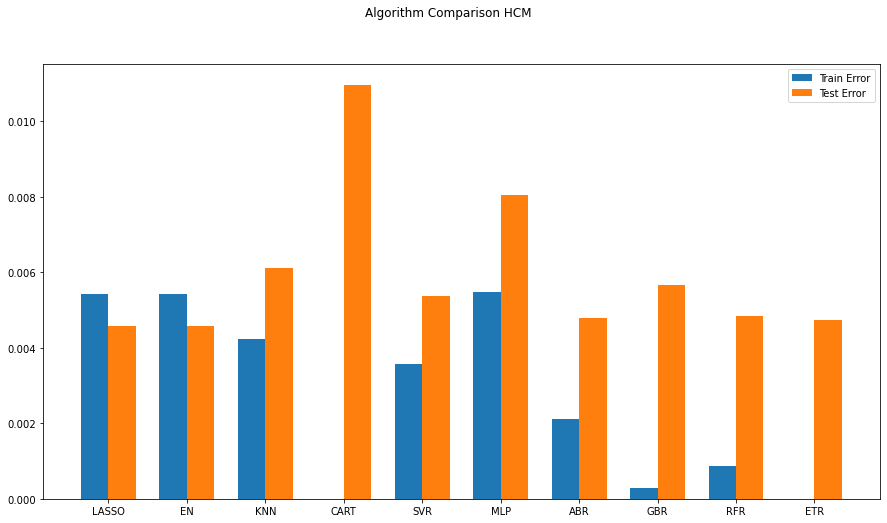

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       GSK      HZNP  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

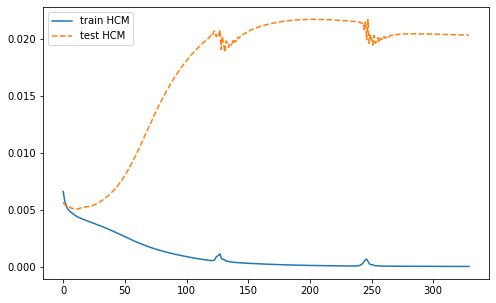

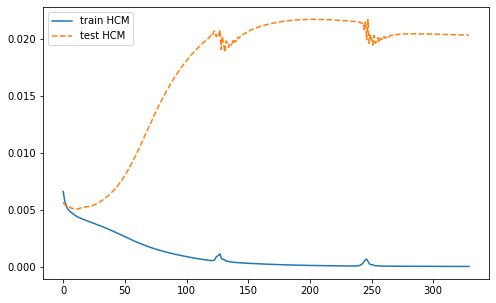

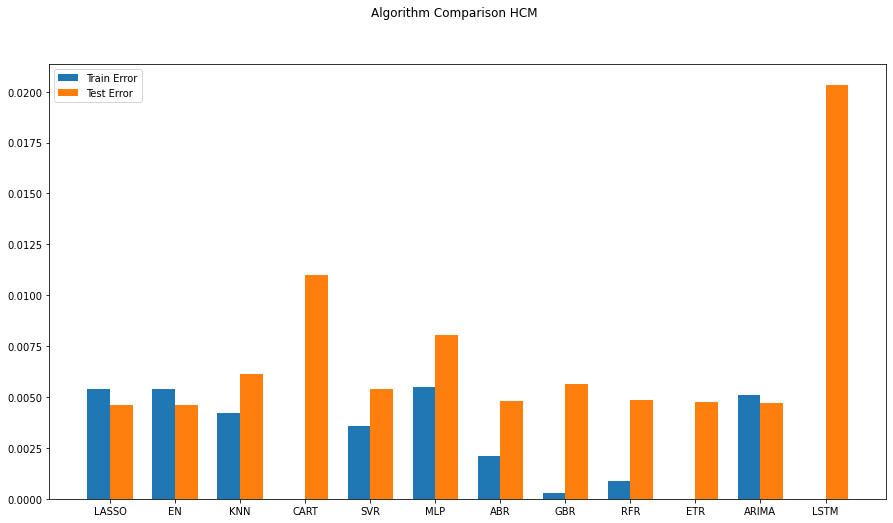

Best ARIMANone MSE=inf
0.004710755247534262


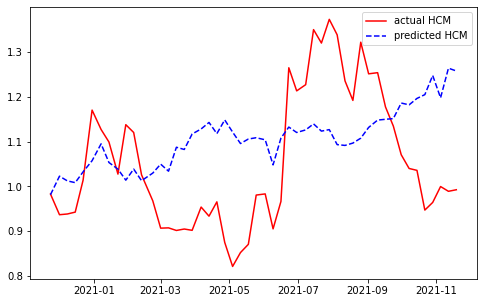

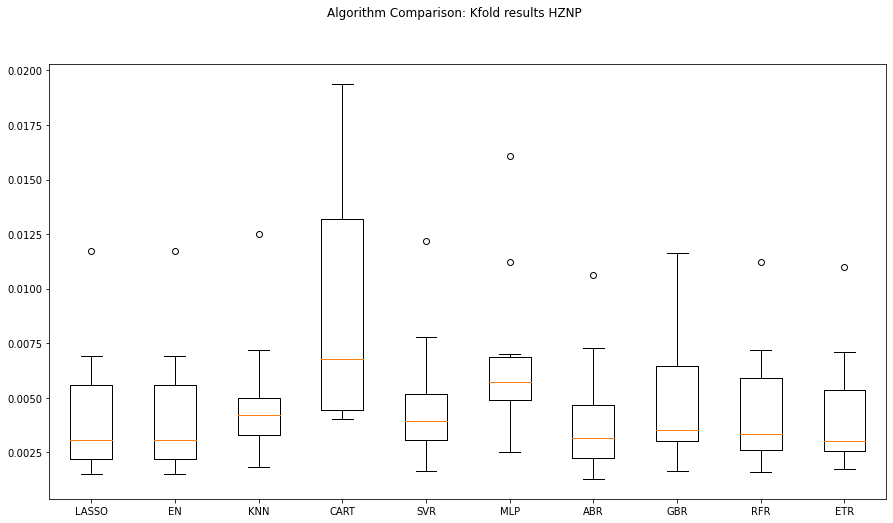

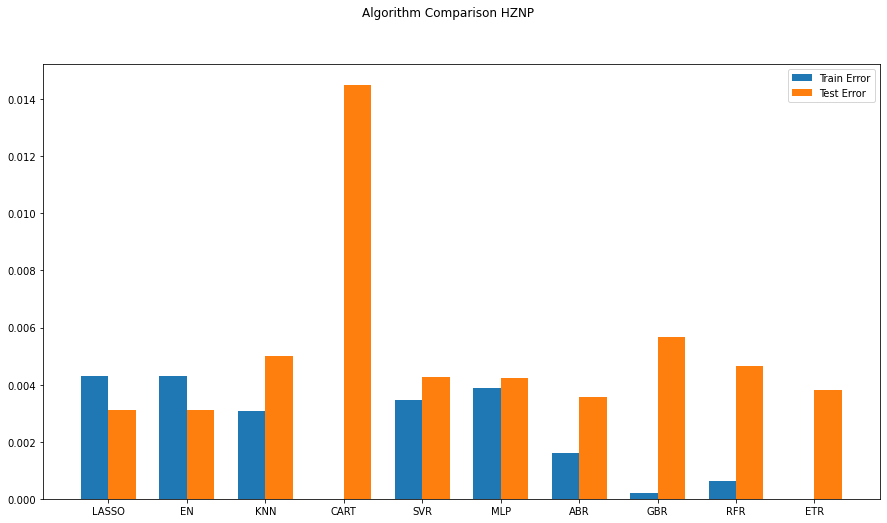

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       GSK       HCM  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

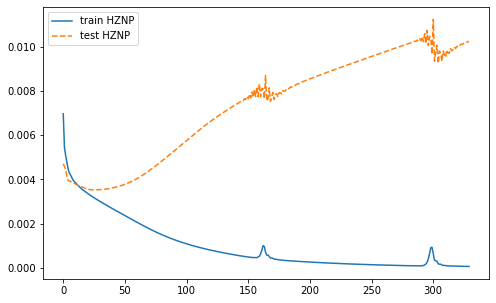

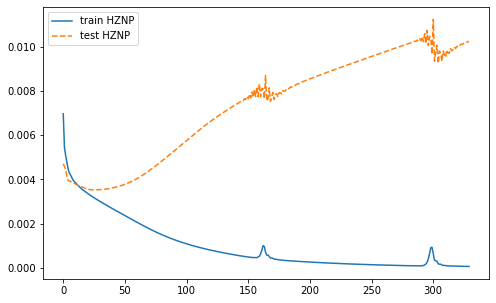

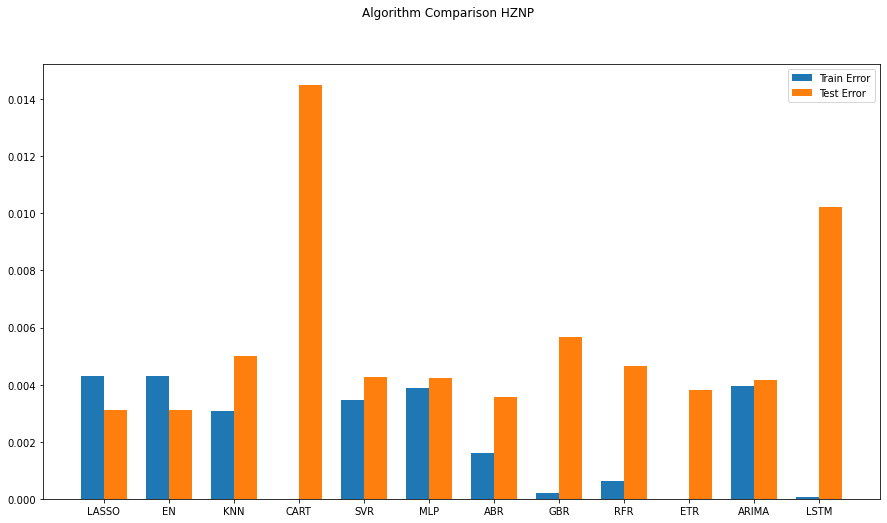

Best ARIMANone MSE=inf
0.00417017107051526


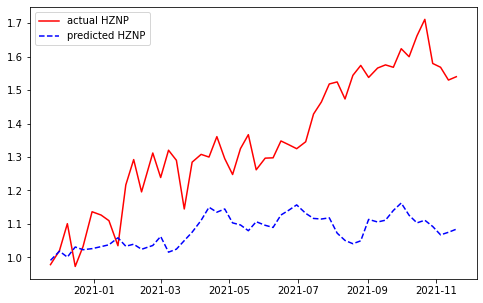

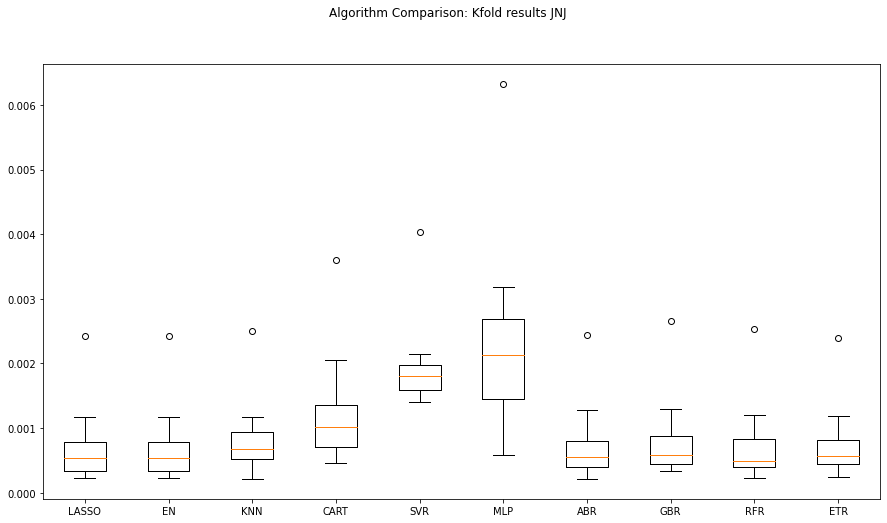

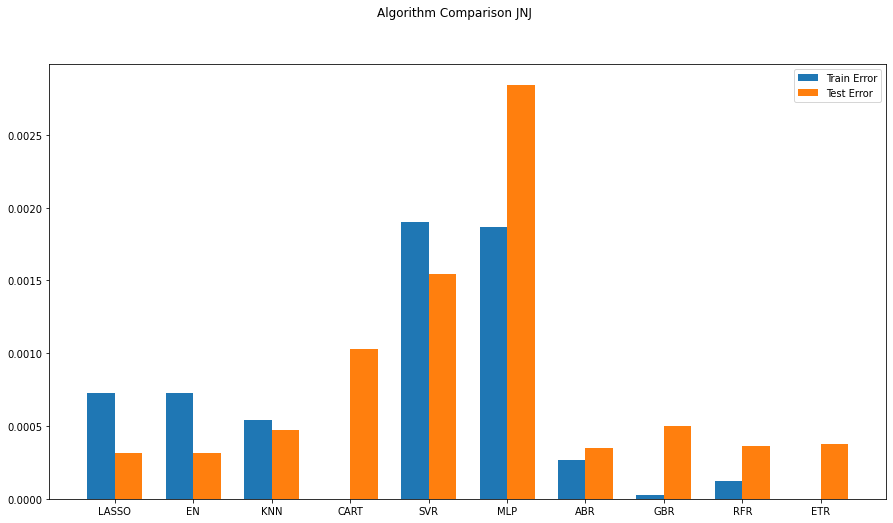

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       GSK       HCM  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

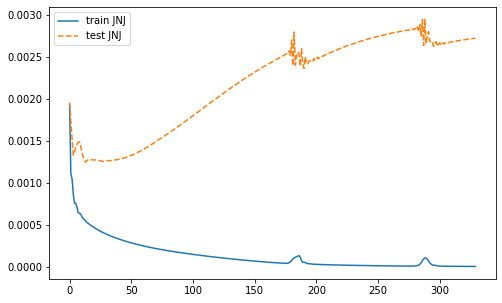

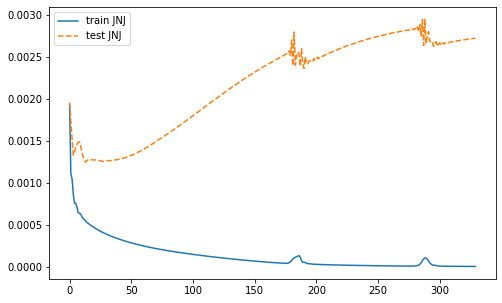

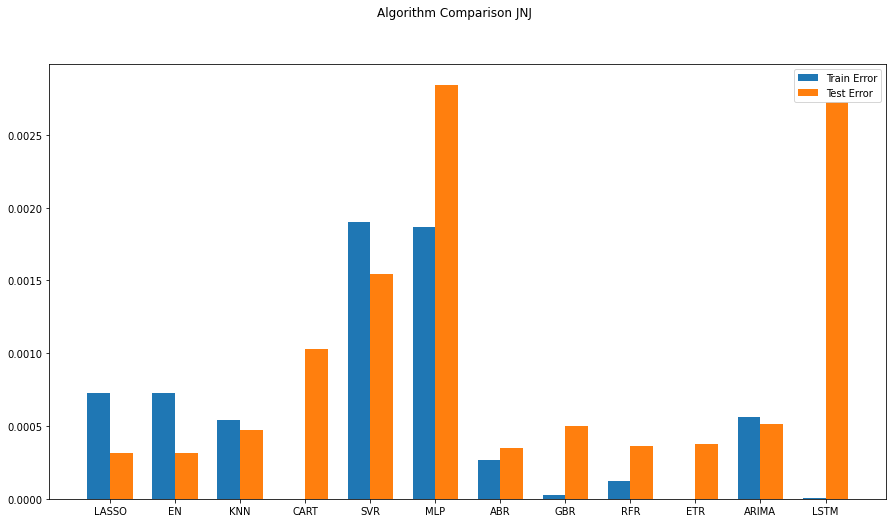

Best ARIMANone MSE=inf
0.0005116064965751991


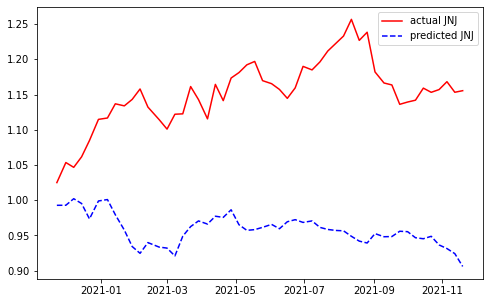

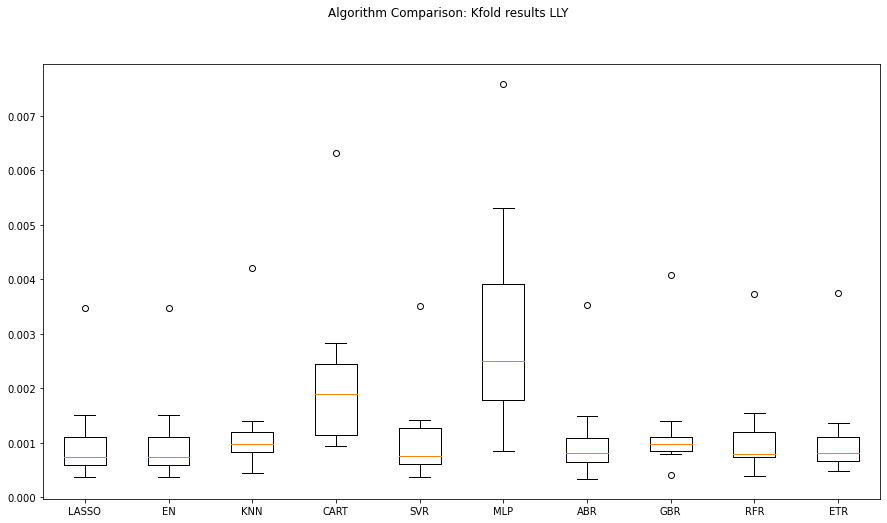

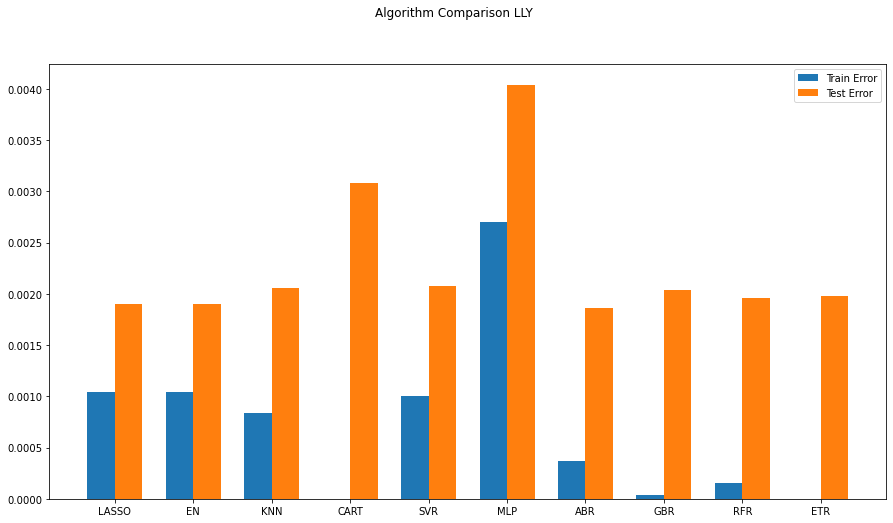

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       GSK       HCM  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

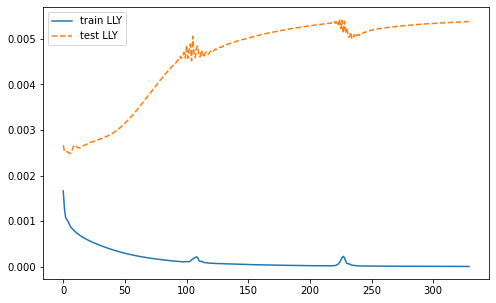

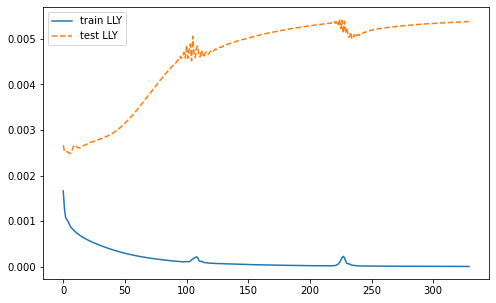

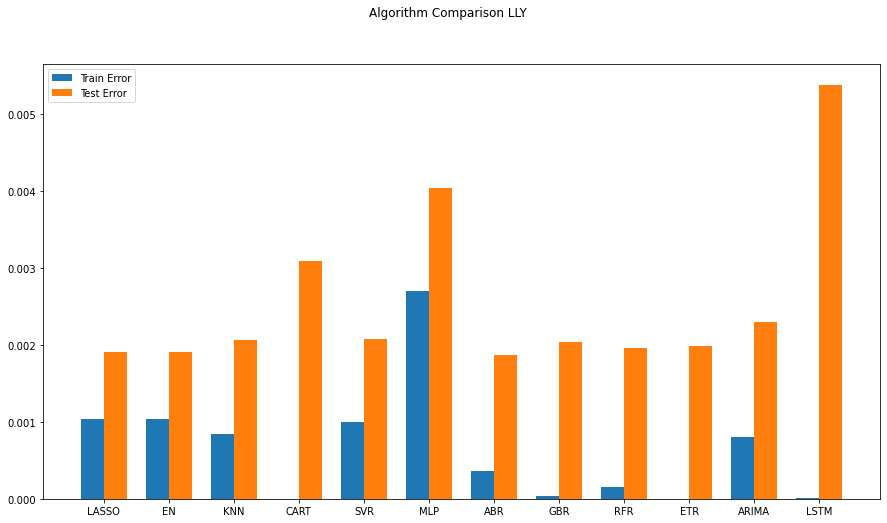

Best ARIMANone MSE=inf
0.0022972447846906618


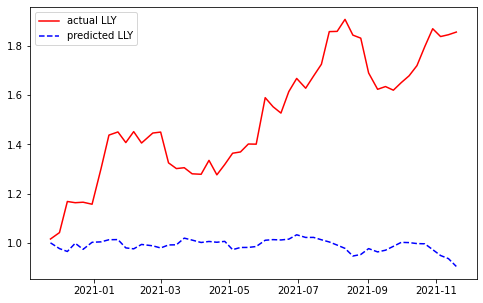

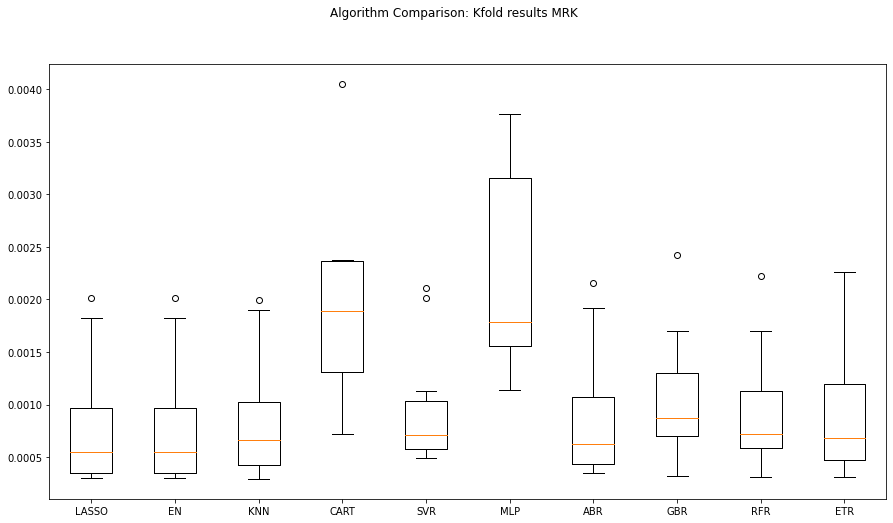

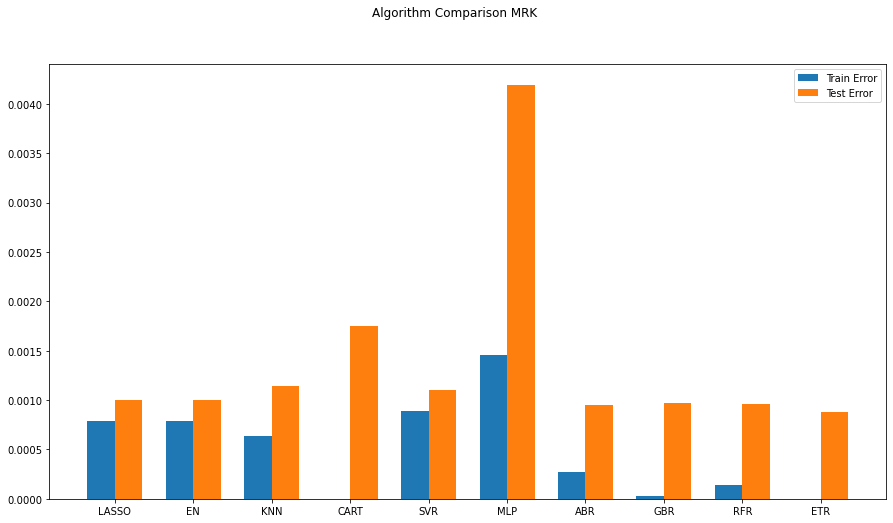

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       GSK       HCM  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

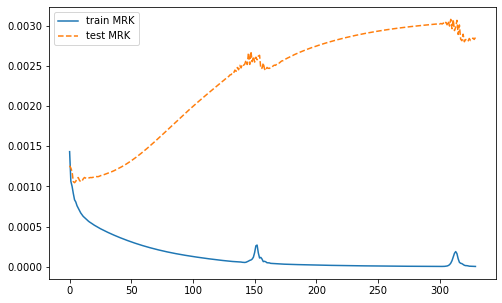

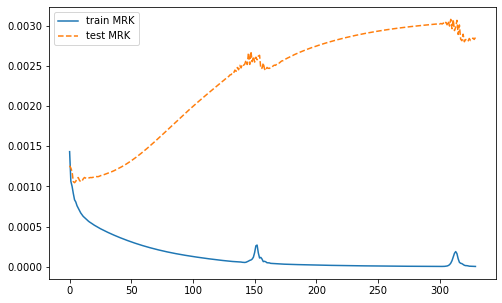

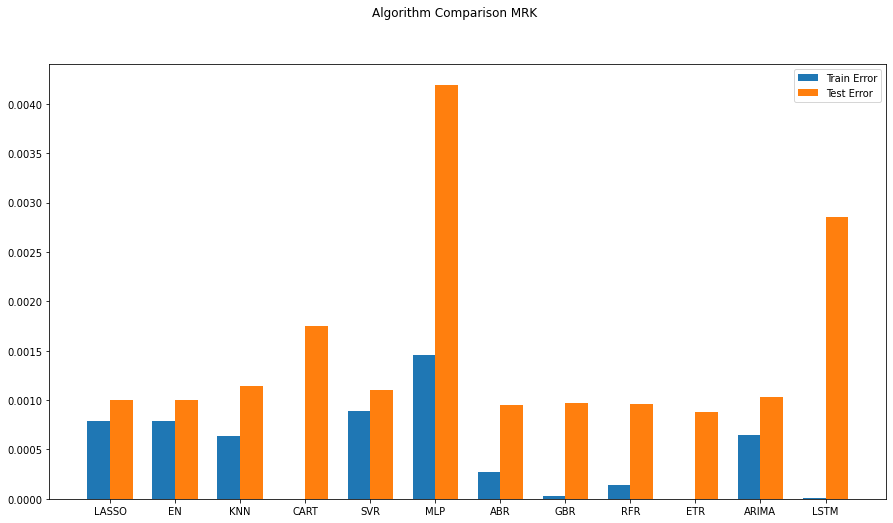

Best ARIMANone MSE=inf
0.0010283387090027638


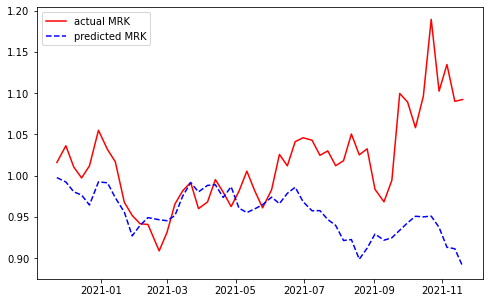

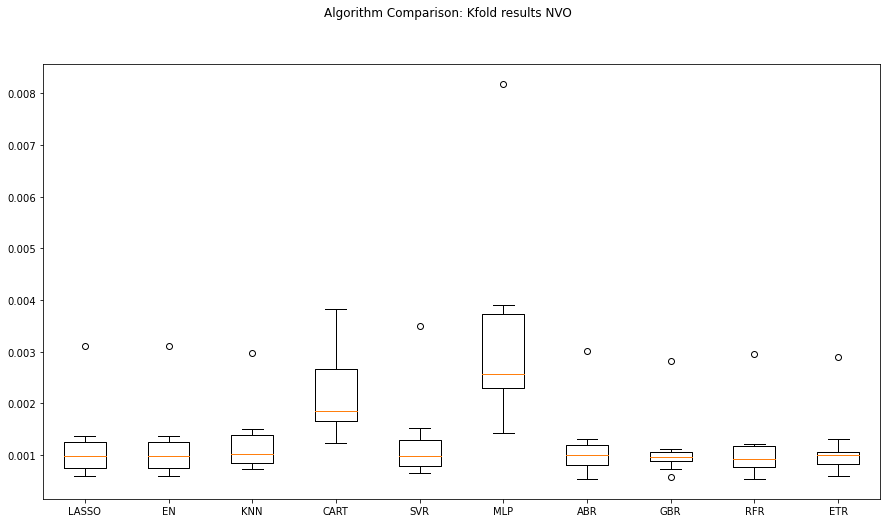

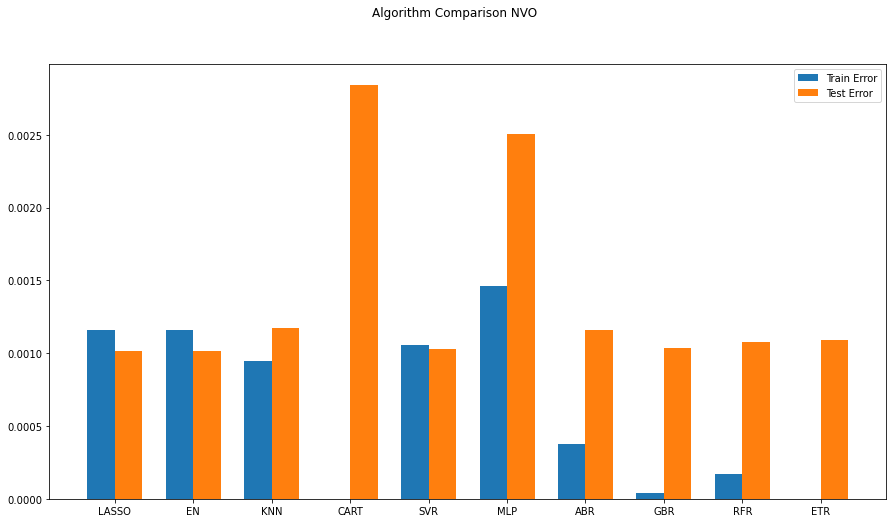

                ABBV      AMGN       AZN      BIIB       BMY      CRXT  \
2016-11-25  0.003571  0.001954  0.003727 -0.000668  0.000679 -0.019542   
2016-12-02 -0.018010 -0.009813 -0.045677 -0.026596 -0.018063 -0.019542   
2016-12-09  0.034888 -0.003896  0.047888 -0.032210  0.019116 -0.019542   
2016-12-16  0.010989  0.040440  0.025447 -0.004772  0.027323 -0.019542   
2016-12-23  0.001927 -0.012259 -0.019939  0.003938  0.016747 -0.019542   
...              ...       ...       ...       ...       ...       ...   
2020-10-19 -0.032940 -0.037434 -0.052561 -0.081115 -0.017292 -0.019542   
2020-10-26 -0.004637 -0.025550  0.011942 -0.045714 -0.018267 -0.019542   
2020-11-02  0.050310 -0.021030 -0.047265 -0.030729 -0.003021 -0.019542   
2020-11-09  0.074966  0.065004  0.065563 -0.052480  0.074324 -0.019542   
2020-11-16  0.033495  0.013809  0.040607  0.060361  0.006533 -0.019542   

                GILD      GRFS       GSK       HCM  ...       NVS       OGN  \
2016-11-25  0.000429 -0.000697  

In [ ]:
# Free for all
# Need to remove LR model
# LSTM Network
def create_LSTMmodel(learn_rate = 0.01, momentum=0): # create model
        model = Sequential()
        model.add(LSTM(50, input_shape=(X_train_LSTM.shape[1],X_train_LSTM.shape[2])))
        model.add(Dense(1))

        #More cells can be added if needed model.add(Dense(1))
        optimizer = SGD(lr=learn_rate, momentum=momentum) 
        model.compile(loss='mse', optimizer='adam')
        return model
    
def evaluate_arima_model(arima_order):
#predicted = list() 
    modelARIMA=ARIMA(endog=Y_temp,exog=X_train_ARIMA,order=arima_order) 
    model_fit = modelARIMA.fit()
    error = mean_squared_error(Y_temp, model_fit.fittedvalues)
    return error

# evaluate combinations of p, d and q values for an ARIMA model
def evaluate_models(p_values, d_values, q_values): 
    best_score, best_cfg = float("inf"), None
    for p in p_values:
        for d in d_values:
            for q in q_values:
                order = (p,d,q) 
                try:
                    mse = evaluate_arima_model(order) 
                    if mse < best_score:
                        best_score, best_cfg = mse, order
                    print('ARIMA%s MSE=%.7f' % (order,mse))
                except: 
                    continue
    print('Best ARIMA%s MSE=%.7f' % (best_cfg, best_score))
    

    
seq_len = 2 #Length of the seq for the LSTM

for i in stk_tickers:
    try:
        X_temp = X_train
        Y_temp = Y_train.filter(regex=i, axis=1)
        #_temp_test = X_test.filter(regex=i, axis=1)
        X_temp_test = X_test
        Y_temp_test = Y_test.filter(regex=i, axis=1)

        X_temp_fulX = X

        Arima_temp = X_train.loc[:, stk_tickers + ['DEXJPUS'] + ['DEXUSUK'] + ['SP500'] + ['DJIA'] + ['VIXCLS']]
        Arima_temp_test = X_test.loc[:, stk_tickers + ['DEXJPUS'] + ['DEXUSUK'] + ['SP500'] + ['DJIA'] + ['VIXCLS']]

        names = []

        kfold_results = [] 
        test_results = [] 
        train_results = []
        # Model testing
        for name, model in models:
            names.append(name)
            ## k-fold analysis:
            kfold = KFold(n_splits=num_folds)
            #converted mean squared error to positive. The lower the better
            cv_results = -1* cross_val_score(model, X_temp, Y_temp, cv=kfold, scoring=scoring)
            kfold_results.append(cv_results)
            # Full Training period
            res = model.fit(X_temp, Y_temp)
            train_result = mean_squared_error(res.predict(X_temp), Y_temp) 
            train_results.append(train_result)
            # Test results
            test_result = mean_squared_error(res.predict(X_temp_test), Y_temp_test) 
            test_results.append(test_result)
        # Comparition starts by ticker
        for j in range(0,1):
            fig = pyplot.figure()
            fig.suptitle(f'Algorithm Comparison: Kfold results {i}')
            ax = fig.add_subplot(111)
            pyplot.boxplot(kfold_results)
            ax.set_xticklabels(names)
            fig.set_size_inches(15,8)
            plt.savefig(f"../readme_images/{i}_Kfold_comparison_ALL.png")
            pyplot.show()
        # Error testing
        for k in range(0,1):
            fig = pyplot.figure()
            ind = np.arange(len(names)) # the x locations for the groups
            width = 0.35 # the width of the bars
            fig.suptitle(f'Algorithm Comparison {i}')
            ax = fig.add_subplot(111)
            pyplot.bar(ind - width/2, train_results,  width=width, label='Train Error')
            pyplot.bar(ind + width/2, test_results, width=width, label='Test Error')
            fig.set_size_inches(15,8)
            pyplot.legend()
            ax.set_xticks(ind)
            ax.set_xticklabels(names)
            plt.savefig(f"../readme_images/{i}_train_test_error_comparison_ALL.png")
            pyplot.show()

        # ARIMA and LSTM
        for arimalstm in range(0,1):


            X_train_ARIMA=Arima_temp.loc[:, Arima_temp.columns != i]
            X_test_ARIMA=Arima_temp_test.loc[:, Arima_temp.columns != i]

            tr_len = len(X_train_ARIMA)
            te_len = len(X_test_ARIMA)
            to_len = len(X_temp_fulX)

            print(X_train_ARIMA)

            X_train_ARIMA.index=pd.DatetimeIndex(X_train_ARIMA.index).to_period('W')

            Y_temp.index=pd.DatetimeIndex(Y_temp.index).to_period('W')

            modelARIMA=ARIMA(endog=Y_temp,exog=X_train_ARIMA,order=[1,0,0])
            model_fit = modelARIMA.fit(trend='nc')

            error_Training_ARIMA = mean_squared_error(Y_temp, model_fit.fittedvalues)
            predicted = model_fit.predict(start = tr_len -1 ,end = to_len -1, exog = X_test_ARIMA)[1:]
            error_Test_ARIMA = mean_squared_error(Y_temp_test,predicted)
            print(error_Test_ARIMA)

            #seq_len = 2 #Length of the seq for the LSTM
            Y_train_LSTM, Y_test_LSTM = np.array(Y_temp)[seq_len-1:], np.array(Y_temp_test) 
            X_train_LSTM = np.zeros((X_temp.shape[0]+1-seq_len, seq_len, X_temp.shape[1]))
            X_test_LSTM = np.zeros((X_temp_test.shape[0], seq_len, X_temp_fulX.shape[1]))
            print(X_test_LSTM.shape)
            print(X_test_LSTM)

            for l in range(seq_len):
                X_train_LSTM[:, l, :] = np.array(X_temp)[l:X_temp.shape[0]+l+1-seq_len, :]
                X_test_LSTM[:, l, :] = np.array(X_temp_fulX)[X_temp.shape[0]+l-1:X_temp_fulX.shape[0]+l+1-seq_len, :]
            print(X_test_LSTM.shape)
            print(X_test_LSTM)

            LSTMModel = create_LSTMmodel(learn_rate = 0.01, momentum=0)
            LSTMModel_fit = LSTMModel.fit(X_train_LSTM, Y_train_LSTM, validation_data=(X_test_LSTM, Y_test_LSTM),epochs=330, batch_size=72, verbose=0, shuffle=False)

            for m in range(seq_len):
                pyplot.plot(LSTMModel_fit.history['loss'], label=f'train {i}', )
                pyplot.plot(LSTMModel_fit.history['val_loss'], '--',label=f'test {i}',)
                pyplot.legend()
                plt.savefig(f"../readme_images/{i}_train_test_LSTM_ALL.png")
                pyplot.show()

            error_Training_LSTM = mean_squared_error(Y_train_LSTM,LSTMModel.predict(X_train_LSTM))
            predicted = LSTMModel.predict(X_test_LSTM)
            error_Test_LSTM = mean_squared_error(Y_temp_test,predicted)

            test_results.append(error_Test_ARIMA)
            test_results.append(error_Test_LSTM)
            train_results.append(error_Training_ARIMA)
            train_results.append(error_Training_LSTM)
            names.append("ARIMA")
            names.append("LSTM")

            for n in range(0,1):
                fig = pyplot.figure()
                ind = np.arange(len(names)) # the x locations for the groups
                width = 0.35 # the width of the bars
                fig.suptitle(f'Algorithm Comparison {i}')
                ax = fig.add_subplot(111)
                pyplot.bar(ind - width/2, train_results,  width=width, label='Train Error')
                pyplot.bar(ind + width/2, test_results, width=width, label='Test Error')
                fig.set_size_inches(15,8)
                pyplot.legend()
                ax.set_xticks(ind)
                ax.set_xticklabels(names)
                plt.savefig(f"../readme_images/{i}_train_test_error_comparison_ALL.png")
                pyplot.show()

            p_values = [0, 1, 2]
            d_values = range(0, 2)
            q_values = range(0, 2)
            evaluate_models(p_values, d_values, q_values)

            modelARIMA_tuned=ARIMA(endog=Y_temp,exog=X_train_ARIMA,order=[2,0,1])
            model_fit_tuned = modelARIMA_tuned.fit(trend='nc')
            # estimate accuracy on validation set
            predicted_tuned = model_fit.predict(start = tr_len -1 ,end = to_len -1, exog = X_test_ARIMA)[1:]
            print(mean_squared_error(Y_temp_test,predicted_tuned))

            # plotting the actual data versus predicted data
            for o in range(0,1):
                predicted_tuned.index = Y_temp_test.index
                pyplot.plot(np.exp(Y_temp_test).cumprod(), 'r', label=f'actual {i}',)
                # plotting t, a separately
                pyplot.plot(np.exp(predicted_tuned).cumprod(), 'b--', label=f'predicted {i}')
                pyplot.legend()
                pyplot.rcParams["figure.figsize"] = (8,5)
                plt.savefig(f"../readme_images/{i}_actual_predicted_ALL.png")
                pyplot.show()
    except:
        pass